In [ ]:
pip install segmentation-models-pytorch

In [ ]:
pip install lightning-bolts

In [ ]:
import pandas as pd
import numpy as np
import sklearn
import torch
import torchvision
import matplotlib.pyplot as plt
from torch.utils.data import Dataset
import albumentations as A
from albumentations.augmentations.transforms import Normalize
from torchvision import transforms
from random import randint
from tqdm.notebook import tqdm
from sklearn.metrics import classification_report,f1_score,accuracy_score
import os.path
from skimage.io import imread
import os
import skimage
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import StandardScaler
import segmentation_models_pytorch as smp
from pl_bolts.models.autoencoders.components import (
    resnet18_decoder,
    resnet18_encoder,
)
import pytorch_lightning as pl

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cp -r /content/drive/MyDrive/Kaggle/skin-cancer9-classesisic.zip /content/skin-cancer9-classesisic.zip

In [ ]:
%cd /content

/content


In [ ]:
!unzip /content/skin-cancer9-classesisic.zip

Archive:  /content/skin-cancer9-classesisic.zip
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0010512.jpg  
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0010889.jpg  
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024468.jpg  
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024470.jpg  
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024511.jpg  
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024646.jpg  
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024654.jpg  
  inflating: Skin cancer ISIC The International Skin Imaging Collaboration/Test/actinic keratosis/ISIC_0024707.jpg  
  inflating: Ski

In [ ]:
#Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration

# VAE

<h4>Иногда может получиться так, что человек вместо изображения родинки скинет дом. Дом - это аномалия, следовательно ее в сеть пускать не надо, а нужно предупредить человека, что он загрузил, что то не то. Я сделал обнаружение аномалий с помощбю vae, то есть на вход vae поступает картинка, после выход сравнивается со входом через absolute error и максимальное отклонение берется в качестве порога. В будущем, когда на вход vae будет послано аномалия, значение разности будет выше порога и аномалия будт определена</h4>

## Подготовка данных

<h4>Загрузка папки с данными, которые имеют часть аномалий, часть родинок</h4>

In [ ]:
%cp -r /content/drive/MyDrive/datasets/anomalies/ /content/anomalies

In [ ]:
class CustomeDataset(Dataset):

    def __init__(self,filepath,transform=None):
        self.data=torchvision.datasets.ImageFolder(filepath)
        self.transform=transform

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        img,label=self.data[idx] 
        if self.transform:
            img=self.transform(img)
        return img,label

In [ ]:
transform_vae=transforms.Compose([
                     transforms.Resize((128,128)),
                     transforms.ToTensor()          
])

In [ ]:
train_vae_data=CustomeDataset("/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Train",transform=transform_vae)

In [ ]:
train_vae_loader=torch.utils.data.DataLoader(train_vae_data,shuffle=True,batch_size=32,num_workers=2,pin_memory=True)

In [ ]:
len(train_vae_data)

2239

## find_threshold

<h4>Функция которая проходится по всем train данным и ищет максимальный mae и он становится порогом</h4>

In [ ]:
def find_threshold(network,train_data):
    train_loader=torch.utils.data.DataLoader(train_data,batch_size=1,num_workers=2,pin_memory=True)
    network.eval()
    threshold=0
    max_errors=[]
    x_bad=None
    with torch.no_grad():
        for x_batch,y_batch in tqdm(train_loader):
            x_batch=x_batch.cuda()
            pred=network(x_batch)[0].cpu().numpy()
            mae_error = np.mean(np.abs(pred[0] - x_batch[0].cpu().numpy()))
            if threshold<mae_error:
                threshold=mae_error
                x_bad=x_batch
            max_errors.append(mae_error)
    return threshold, max_errors

## check_anomalies

<h4>Функция проходит по всем данным из папки с аномалиями и нормальными изображениями и  пытается определить аномалию</h4>

In [ ]:
import PIL

In [ ]:
def check_anomalies(network,th):
    network.eval()
    anom={}
    for adr,dirs,files in os.walk("/content/anomalies"):
        print(files)
        for f in files:
            img = PIL.Image.open(f"/content/anomalies/{f}")
            img_transform=transform_vae(img)
            t_img=torch.unsqueeze(img_transform,0)
            t_img=t_img.cuda()
            
            trans=network(t_img)
            mae_error = np.mean(np.abs(trans[0][0].detach().cpu().numpy()- t_img.cpu().numpy()))
            if mae_error>=th:
               anom[f]=["anomaly",mae_error]
            else:
               anom[f]=["no anomaly",mae_error]
    return anom

## show_anomalies

In [ ]:
def show_anomalies(network,th):
    network.eval()
    anom={}
    plt.figure(figsize=(20,15))
    pred_state=None
    true_state=None
    for adr,dirs,files in os.walk("/content/anomalies"):
        print(files)
        for i,f in enumerate(files):
            img = PIL.Image.open(f"/content/anomalies/{f}")
            img_transform=transform_vae(img)
            t_img=torch.unsqueeze(img_transform,0)
            t_img=t_img.cuda()
            
            trans=network(t_img)
            mae_error = np.mean(np.abs(trans[0][0].detach().cpu().numpy()- t_img.cpu().numpy()))
            if mae_error>=th:
               anom[f]=["anomaly",mae_error]
               pred_state="anomaly"
            else:
               anom[f]=["no anomaly",mae_error]
               pred_state="no anomaly"
            if "ISIC" in f:
                true_state="no anomaly"
            else:
                true_state="anomaly"
            plt.subplot(3,4,i+1)
            plt.imshow(img)
            plt.title(f"{pred_state} предсказанное")
            plt.xlabel(f"Правильный ответ - {true_state}")

    return anom

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

632

In [ ]:
def KL_divergence(mu, logsigma):

    loss = -0.5 * torch.sum(1 + logsigma - mu.pow(2) - logsigma.exp())
    return loss

def log_likelihood(x, reconstruction):

    loss = nn.BCELoss(reduction='sum')
    # loss=torch.nn.MSELoss()
    return loss(reconstruction, x)

def loss_vae(x, mu, logsigma, reconstruction):
    return KL_divergence(mu, logsigma) + log_likelihood(x, reconstruction)

In [ ]:
import pytorch_lightning as pl
from torch import nn
import torch
from pl_bolts.models.autoencoders.components import (
    resnet18_decoder,
    resnet18_encoder,
)


class VAE(torch.nn.Module):
    def __init__(self, enc_out_dim=512, latent_dim=256, input_height=128):
        super(VAE,self).__init__()
        self.encoder = resnet18_encoder(False, False)
        self.decoder = resnet18_decoder(
            latent_dim=latent_dim,
            input_height=input_height,
            first_conv=False,
            maxpool1=False
        )
        self.fc_mu = torch.nn.Linear(enc_out_dim, latent_dim)
        self.fc_var = torch.nn.Linear(enc_out_dim, latent_dim)

    def forward(self,batch):

        x_encoded = self.encoder(batch)

        mu, log_var = self.fc_mu(x_encoded), self.fc_var(x_encoded) 

        std = torch.exp(log_var / 2)
        q = torch.distributions.Normal(mu, std)
        z = q.rsample() 
        
        # reconstruction = self.decoder(z)
        x = self.decoder(z)
        reconstruction = torch.sigmoid(x)
        return reconstruction,mu,log_var

In [ ]:
def train_vae(network,train_loader,learning_rate=0.001,epochs=3,network_name=None,loaded_optimizer=None):
    optimizer=None
    if loaded_optimizer:
      optimizer=loaded_optimizer
    else:
      optimizer=torch.optim.Adam(network.parameters(),lr=learning_rate) # Optimizer


    network.train() # переводим сеть в состояние обучения
    
    vae_error=[]
    best_error=100000000000
    for i in tqdm(range(epochs)):
        error=0
        for x_batch,y_batch in tqdm(train_loader):
            x_batch=x_batch.cuda()
            optimizer.zero_grad()

            reconstructed,mu,log_var=network(x_batch)

            loss=loss_vae(x_batch.float(), mu, log_var, reconstructed)

            loss.backward()
            optimizer.step()
            error+=loss.item()

        print(f"Epoch {i} error = {error/len(train_loader)}")
        vae_error.append(error/len(train_loader))

        if error/len(train_loader) < best_error:
            print(f'Save best model with error {error/len(train_loader)}')
            state = {
                        'state_dict': network.state_dict(),
                        'optimizer' : optimizer.state_dict()}
            if network_name:
                torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/{network_name}_best_model.pt") #Сохраняем наилучшую модель
            else:
                torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/best_model.pt")
            best_error=error/len(train_loader)
        else:
            print(f"Don't save model. Val error is {error/len(train_loader)}")
    return network,vae_error

## Обучение

In [ ]:
vae=VAE().cuda()

In [ ]:
final_net,vae_error=train_vae(vae,train_vae_loader,epochs=20,network_name="vae_new_model")

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 0 error = 1128653.9125
Save best model with error 1128653.9125


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 1 error = 977146.8232142857
Save best model with error 977146.8232142857


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 2 error = 973837.6223214286
Save best model with error 973837.6223214286


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 3 error = 970665.9482142857
Save best model with error 970665.9482142857


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 4 error = 968975.0973214286
Save best model with error 968975.0973214286


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 5 error = 967471.7892857143
Save best model with error 967471.7892857143


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 6 error = 966446.8955357143
Save best model with error 966446.8955357143


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 7 error = 965101.8598214285
Save best model with error 965101.8598214285


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 8 error = 965418.1
Don't save model. Val error is 965418.1


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 9 error = 964291.7241071429
Save best model with error 964291.7241071429


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 10 error = 963330.1892857143
Save best model with error 963330.1892857143


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 11 error = 962560.3375
Save best model with error 962560.3375


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 12 error = 961850.7267857143
Save best model with error 961850.7267857143


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 13 error = 962546.0616071429
Don't save model. Val error is 962546.0616071429


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 14 error = 960809.8866071429
Save best model with error 960809.8866071429


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 15 error = 960665.3660714285
Save best model with error 960665.3660714285


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 16 error = 959566.19375
Save best model with error 959566.19375


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 17 error = 959137.9883928571
Save best model with error 959137.9883928571


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 18 error = 958389.8133928571
Save best model with error 958389.8133928571


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 19 error = 957939.5178571428
Save best model with error 957939.5178571428


##Результаты

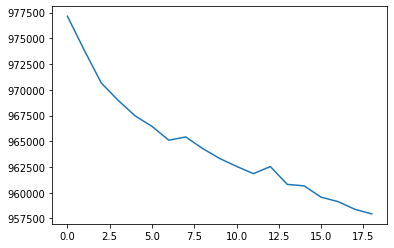

In [ ]:
plt.plot(vae_error[1:])

## Загрузка лучшей модели

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/vae_new_model_best_model.pt")
best_model=VAE().cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

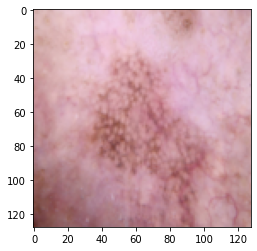

In [ ]:
img=train_vae_data.__getitem__(26)[0]
plt.imshow(np.transpose(img,(1,2,0)))

In [ ]:
best_model.eval()
img=train_vae_data.__getitem__(18)[0]
img=torch.unsqueeze(img,0)
img=img.cuda()
pred=best_model(img)

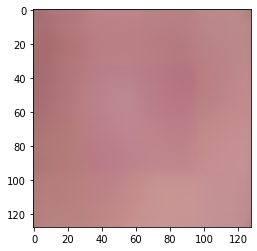

In [ ]:
plt.imshow(np.transpose(pred[0][0].detach().cpu().numpy(),(1,2,0)))

## Находим порог

In [ ]:
th,max_errors=find_threshold(best_model,train_vae_data)

  0%|          | 0/2239 [00:00<?, ?it/s]

In [ ]:
th

0.17826967

(array([ 0.56389271,  0.56389271,  1.97362449,  5.6389271 ,  5.6389271 ,
         7.89449794, 16.07094224, 16.35286937, 21.1460015 , 22.27373586,
        28.75856203, 31.29600861, 30.16829547, 29.8862785 , 31.01406259,
        27.63077529, 28.19460236, 27.3488286 , 26.78487224, 27.06688191,
        22.83762791, 24.24741505, 19.1723296 , 13.81538764, 14.66119322,
        15.50706776, 11.27784094, 11.27784094,  9.30421878, 10.99594664,
         9.02227275,  6.20281252,  5.63892047,  5.92089434,  5.63892047,
         6.48475854,  5.63892047,  4.22921024,  3.94724433,  1.69167614,
         3.94724433,  2.53752615,  3.94724433,  2.81946024,  3.10140626,
         1.40973012,  2.2555788 ,  2.25556819,  1.12778409,  1.12778409,
         0.5638947 ,  1.40973012,  1.40973012,  1.12778409,  0.5638947 ,
         0.        ,  0.56389205,  0.56389205,  0.28194602,  0.5638947 ,
         0.28194602,  0.56389205,  0.84583807,  0.28194735,  0.84583807,
         0.56389205,  0.        ,  0.        ,  0.2

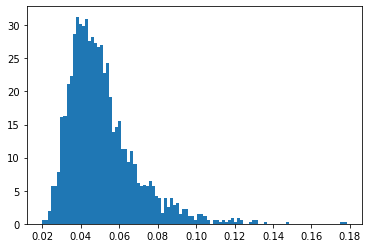

In [ ]:
max_errors=np.array(max_errors)
plt.hist(max_errors.ravel(), bins=100, density=True)

In [ ]:
import PIL

In [ ]:
img = PIL.Image.open("/content/f753d138df-nomark.jpg")
img_transform=transform_vae(img)
t_img=torch.tensor(img_transform)
t_img=torch.unsqueeze(t_img,0)
t_img=t_img.cuda()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
best_model.eval()
trans=best_model(t_img)

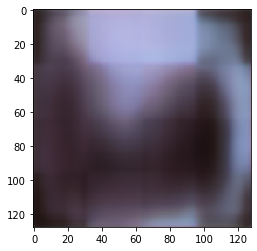

In [ ]:
plt.imshow(np.transpose(trans[0][0].detach().cpu().numpy(),(1,2,0)))

In [ ]:
pred=best_model(t_img)[0].detach().cpu().numpy()
mae_error = np.mean(np.abs(pred[0] - t_img.cpu().numpy()))
mae_error

0.21778965

##Поиск аномалий

['download (8).jpg', 'download (7).jpg', 'download (4).jpg', 'download (9).jpg', 'download (2).jpg', 'ISIC_0000165.jpg', 'download (10).jpg', 'ISIC_0000142.jpg', 'download (3).jpg', 'download (5).jpg', 'download (6).jpg', 'ISIC_0000175.jpg']


{'ISIC_0000142.jpg': ['no anomaly', 0.067003325],
 'ISIC_0000165.jpg': ['no anomaly', 0.08873247],
 'ISIC_0000175.jpg': ['no anomaly', 0.04902115],
 'download (10).jpg': ['anomaly', 0.15084253],
 'download (2).jpg': ['anomaly', 0.2628354],
 'download (3).jpg': ['anomaly', 0.21156268],
 'download (4).jpg': ['anomaly', 0.1980344],
 'download (5).jpg': ['anomaly', 0.22648849],
 'download (6).jpg': ['anomaly', 0.2169738],
 'download (7).jpg': ['anomaly', 0.21334277],
 'download (8).jpg': ['anomaly', 0.18039457],
 'download (9).jpg': ['anomaly', 0.20018359]}

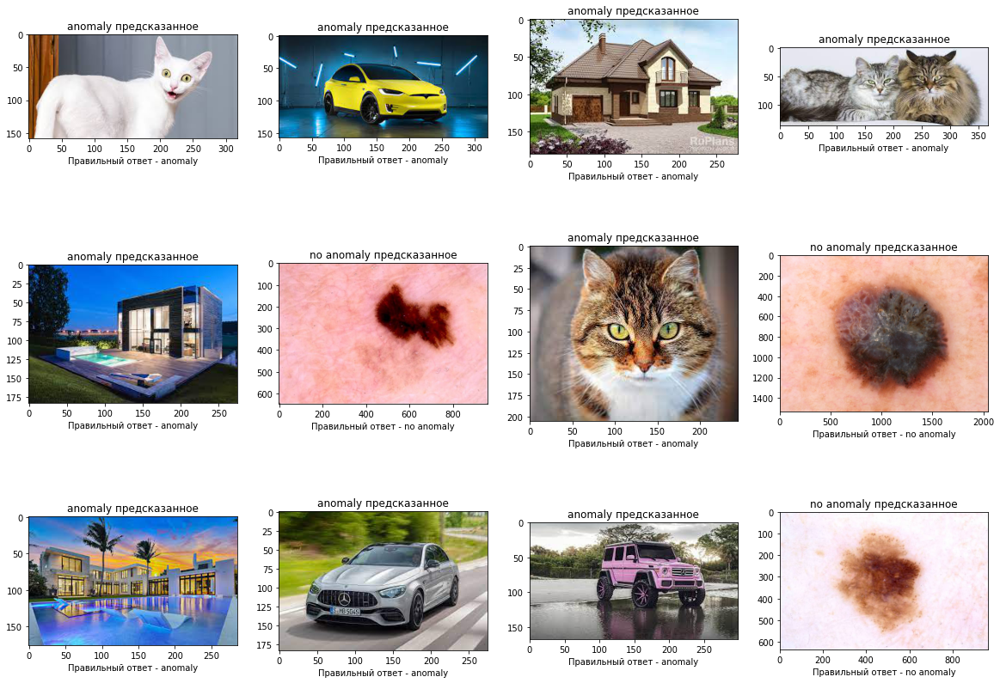

In [ ]:
show_anomalies(best_model,0.15)

In [ ]:
check_anomalies(best_model,0.15)

['download (8).jpg', 'download (7).jpg', 'download (4).jpg', 'download (9).jpg', 'download (2).jpg', 'ISIC_0000165.jpg', 'download (10).jpg', 'ISIC_0000142.jpg', 'download (3).jpg', 'download (5).jpg', 'download (6).jpg', 'ISIC_0000175.jpg']


{'ISIC_0000142.jpg': ['no anomaly', 0.06910416],
 'ISIC_0000165.jpg': ['no anomaly', 0.08948914],
 'ISIC_0000175.jpg': ['no anomaly', 0.05131936],
 'download (10).jpg': ['anomaly', 0.15631072],
 'download (2).jpg': ['anomaly', 0.25841174],
 'download (3).jpg': ['anomaly', 0.21089186],
 'download (4).jpg': ['anomaly', 0.19901584],
 'download (5).jpg': ['anomaly', 0.22124536],
 'download (6).jpg': ['anomaly', 0.21377344],
 'download (7).jpg': ['anomaly', 0.2109677],
 'download (8).jpg': ['anomaly', 0.18668361],
 'download (9).jpg': ['anomaly', 0.1951799]}

<h4>Данный vae хорошо справился с проблемой поиска аномалий. Можно заметить, что mae между родинками низкое, а между аномалиями большое. Ошибок нет. Все работает хорошо</h4>

## ======

## Обучение на другой loss

In [ ]:
vae=VAE().cuda()

In [ ]:
final_net,vae_error=train_vae(vae,train_vae_loader,epochs=20,network_name="vae_mse_model")

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 0 error = 63.756771177904945
Save best model with error 63.756771177904945


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 1 error = 0.5472715961081641
Save best model with error 0.5472715961081641


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 2 error = 0.3557858324476651
Save best model with error 0.3557858324476651


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 3 error = 0.2815722235611507
Save best model with error 0.2815722235611507


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 4 error = 0.19880642273596355
Save best model with error 0.19880642273596355


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 5 error = 0.15447861770434038
Save best model with error 0.15447861770434038


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 6 error = 0.12306948767176697
Save best model with error 0.12306948767176697


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 7 error = 0.10868365695433957
Save best model with error 0.10868365695433957


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 8 error = 0.09635664804705552
Save best model with error 0.09635664804705552


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 9 error = 0.09102629939360278
Save best model with error 0.09102629939360278


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 10 error = 0.08999185631317752
Save best model with error 0.08999185631317752


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 11 error = 0.060321445230926786
Save best model with error 0.060321445230926786


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 12 error = 0.06911332729671682
Don't save model. Val error is 0.06911332729671682


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 13 error = 0.06338131177638258
Don't save model. Val error is 0.06338131177638258


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 14 error = 0.05555345485252994
Save best model with error 0.05555345485252994


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 15 error = 0.05270590180797236
Save best model with error 0.05270590180797236


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 16 error = 0.04794228007750852
Save best model with error 0.04794228007750852


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 17 error = 0.046446517509009154
Save best model with error 0.046446517509009154


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 18 error = 0.04120999651827983
Save best model with error 0.04120999651827983


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 19 error = 0.04247832644198622
Don't save model. Val error is 0.04247832644198622


##Результаты

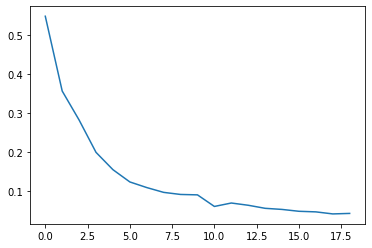

In [ ]:
plt.plot(vae_error[1:])

## Загрузка лучшей модели

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/vae_mse_model_best_model.pt")
best_model=VAE().cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

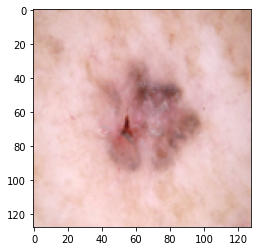

In [ ]:
img=train_vae_data.__getitem__(21)[0]
plt.imshow(np.transpose(img,(1,2,0)))

In [ ]:
best_model.eval()
img=train_vae_data.__getitem__(21)[0]
img=torch.unsqueeze(img,0)
img=img.cuda()
pred=best_model(img)

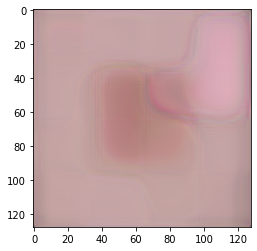

In [ ]:
plt.imshow(np.transpose(pred[0][0].detach().cpu().numpy(),(1,2,0)))

In [ ]:
pred=pred[0].detach().cpu().numpy()
mae_error = np.mean(np.abs(pred[0] - train_vae_data.__getitem__(21)[0].cpu().numpy()))
mae_error

0.12285934

## Находим порог

In [ ]:
th,max_errors=find_threshold(best_model,train_vae_data)

  0%|          | 0/2239 [00:00<?, ?it/s]

In [ ]:
th

0.35601112

(array([ 0.20384752,  0.54359355,  2.24232338,  4.48464676,  5.70772901,
         9.10519707, 10.19236745, 12.16290561, 11.68726125, 12.02700722,
        10.73597255,  9.51288707,  7.81415723,  9.10518159,  7.54236901,
         6.04747135,  5.23209382,  2.98976112,  3.39745582,  3.39746352,
         3.12565935,  2.514123  ,  1.76667702,  1.56283322,  1.35898233,
         1.08718833,  1.01923674,  1.69872791,  0.74744197,  0.8153894 ,
         0.47564489,  0.20384735,  0.20384781,  0.33974635,  0.27179585,
         0.06794927,  0.        ,  0.13589792,  0.06794927,  0.06794927,
         0.13589854,  0.        ,  0.        ,  0.06794927,  0.        ,
         0.06794927,  0.06794927,  0.        ,  0.        ,  0.13589854]),
 array([0.02736261, 0.03393558, 0.04050855, 0.04708152, 0.05365449,
        0.06022746, 0.06680043, 0.07337341, 0.07994638, 0.08651935,
        0.09309231, 0.09966528, 0.10623825, 0.11281122, 0.1193842 ,
        0.12595716, 0.13253014, 0.1391031 , 0.14567608, 0.152249

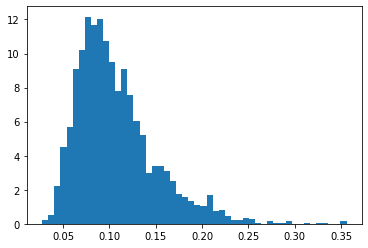

In [ ]:
max_errors=np.array(max_errors)
plt.hist(max_errors.ravel(), bins=50, density=True)

In [ ]:
import PIL

In [ ]:
img = PIL.Image.open("/content/f753d138df-nomark.jpg")
img_transform=transform_vae(img)
t_img=torch.tensor(img_transform)
t_img=torch.unsqueeze(t_img,0)
t_img=t_img.cuda()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
best_model.eval()
trans=best_model(t_img)

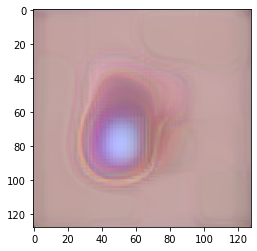

In [ ]:
plt.imshow(np.transpose(trans[0][0].detach().cpu().numpy(),(1,2,0)))

In [ ]:
pred=best_model(t_img)[0].detach().cpu().numpy()
mae_error = np.mean(np.abs(pred[0] - t_img.cpu().numpy()))
mae_error

0.31787023

##Поиск аномалий

['download (8).jpg', 'download (7).jpg', 'download (4).jpg', 'download (9).jpg', 'download (2).jpg', 'ISIC_0000165.jpg', 'download (10).jpg', 'ISIC_0000142.jpg', 'download (3).jpg', 'download (5).jpg', 'download (6).jpg', 'ISIC_0000175.jpg']


{'ISIC_0000142.jpg': ['no anomaly', 0.19692878],
 'ISIC_0000165.jpg': ['no anomaly', 0.18504219],
 'ISIC_0000175.jpg': ['no anomaly', 0.28399414],
 'download (10).jpg': ['no anomaly', 0.22373812],
 'download (2).jpg': ['anomaly', 0.36719874],
 'download (3).jpg': ['no anomaly', 0.21988678],
 'download (4).jpg': ['no anomaly', 0.23572165],
 'download (5).jpg': ['no anomaly', 0.2550252],
 'download (6).jpg': ['no anomaly', 0.26314244],
 'download (7).jpg': ['anomaly', 0.39958122],
 'download (8).jpg': ['no anomaly', 0.19593723],
 'download (9).jpg': ['no anomaly', 0.20795394]}

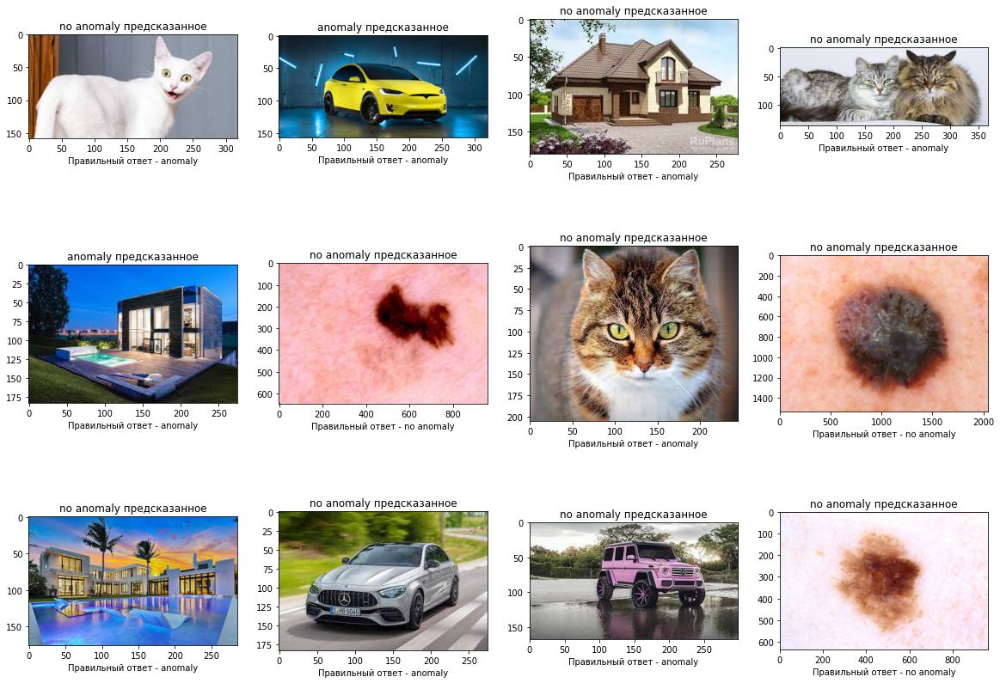

In [ ]:
show_anomalies(best_model,0.30)

In [ ]:
check_anomalies(best_model,0.30)

['download (8).jpg', 'download (7).jpg', 'download (4).jpg', 'download (9).jpg', 'download (2).jpg', 'ISIC_0000165.jpg', 'download (10).jpg', 'ISIC_0000142.jpg', 'download (3).jpg', 'download (5).jpg', 'download (6).jpg', 'ISIC_0000175.jpg']


{'ISIC_0000142.jpg': ['no anomaly', 0.19954556],
 'ISIC_0000165.jpg': ['no anomaly', 0.18550342],
 'ISIC_0000175.jpg': ['no anomaly', 0.28052694],
 'download (10).jpg': ['no anomaly', 0.22254898],
 'download (2).jpg': ['anomaly', 0.3675474],
 'download (3).jpg': ['no anomaly', 0.22105287],
 'download (4).jpg': ['no anomaly', 0.23574555],
 'download (5).jpg': ['no anomaly', 0.25286573],
 'download (6).jpg': ['no anomaly', 0.2617425],
 'download (7).jpg': ['anomaly', 0.40085664],
 'download (8).jpg': ['no anomaly', 0.19682741],
 'download (9).jpg': ['no anomaly', 0.20783459]}

<h4>Данный vae плохо справился с проблемой поиска аномалий. Очень много ошибок</h4>

#AE

In [ ]:
import pytorch_lightning as pl
from torch import nn
import torch
from pl_bolts.models.autoencoders.components import (
    resnet18_decoder,
    resnet18_encoder,
)


class AE(torch.nn.Module):
    def __init__(self, enc_out_dim=512, latent_dim=256, input_height=128):
        super(AE,self).__init__()
        self.encoder = resnet18_encoder(False, False)
        self.decoder = resnet18_decoder(
            latent_dim=latent_dim,
            input_height=input_height,
            first_conv=False,
            maxpool1=False
        )
        self.fc = torch.nn.Linear(enc_out_dim, latent_dim)
    def forward(self,batch):

        x_encoded = self.encoder(batch)
        x=self.fc(x_encoded) 
        x = self.decoder(x)
        return x

In [ ]:
def train_ae(network,train_loader,learning_rate=0.001,epochs=3,network_name=None,loaded_optimizer=None):
    optimizer=None
    if loaded_optimizer:
      optimizer=loaded_optimizer
    else:
      optimizer=torch.optim.Adam(network.parameters(),lr=learning_rate) # Optimizer


    network.train() # переводим сеть в состояние обучения
    loss_fn = torch.nn.MSELoss()
    vae_error=[]
    best_error=100000000000
    for i in tqdm(range(epochs)):
        error=0
        for x_batch,y_batch in tqdm(train_loader):
            x_batch=x_batch.cuda()
            optimizer.zero_grad()

            reconstructed=network(x_batch)

            loss=loss_fn(reconstructed,x_batch)

            loss.backward()
            optimizer.step()
            error+=loss.item()

        print(f"Epoch {i} error = {error/len(train_loader)}")
        vae_error.append(error/len(train_loader))

        if error/len(train_loader) < best_error:
            print(f'Save best model with error {error/len(train_loader)}')
            state = {
                        'state_dict': network.state_dict(),
                        'optimizer' : optimizer.state_dict()}
            if network_name:
                torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/{network_name}_best_model.pt") #Сохраняем наилучшую модель
            else:
                torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/best_model.pt")
            best_error=error/len(train_loader)
        else:
            print(f"Don't save model. Val error is {error/len(train_loader)}")
    return network,vae_error

## Обучение

In [ ]:
ae=AE().cuda()

In [ ]:
final_net,vae_error=train_ae(ae,train_vae_loader,epochs=20,network_name="vae_model")

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 0 error = 0.11374197511800697
Save best model with error 0.11374197511800697


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 1 error = 0.02015016863920859
Save best model with error 0.02015016863920859


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 2 error = 0.017116771052990642
Save best model with error 0.017116771052990642


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 3 error = 0.013406212614583118
Save best model with error 0.013406212614583118


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 4 error = 0.013206804317555257
Save best model with error 0.013206804317555257


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 5 error = 0.012584553552525385
Save best model with error 0.012584553552525385


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 6 error = 0.011703082653028624
Save best model with error 0.011703082653028624


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 7 error = 0.011376614110278231
Save best model with error 0.011376614110278231


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 8 error = 0.010443979681336453
Save best model with error 0.010443979681336453


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 9 error = 0.009739672212994524
Save best model with error 0.009739672212994524


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 10 error = 0.009991864866710136
Don't save model. Val error is 0.009991864866710136


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 11 error = 0.009768655909491436
Don't save model. Val error is 0.009768655909491436


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 12 error = 0.009543122657175575
Save best model with error 0.009543122657175575


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 13 error = 0.009433339130399482
Save best model with error 0.009433339130399482


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 14 error = 0.00892266710954053
Save best model with error 0.00892266710954053


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 15 error = 0.008950907524142947
Don't save model. Val error is 0.008950907524142947


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 16 error = 0.008893856366298029
Save best model with error 0.008893856366298029


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 17 error = 0.008533184962081058
Save best model with error 0.008533184962081058


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 18 error = 0.008823570276477507
Don't save model. Val error is 0.008823570276477507


  0%|          | 0/70 [00:00<?, ?it/s]

Epoch 19 error = 0.008354062174579928
Save best model with error 0.008354062174579928


## Результаты

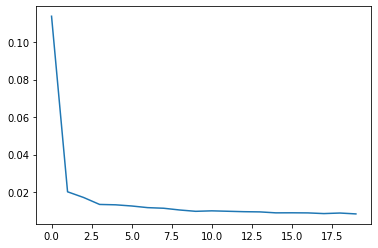

In [ ]:
plt.plot(vae_error)

## Загрузка лучшей модели

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/vae_model_best_model.pt")
best_model=AE().cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

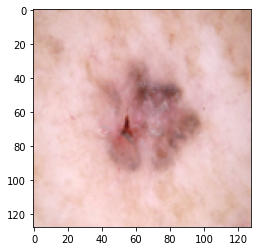

In [ ]:
img=train_vae_data.__getitem__(21)[0]
plt.imshow(np.transpose(img,(1,2,0)))

In [ ]:
best_model.eval()
img=train_vae_data.__getitem__(26)[0]
img=torch.unsqueeze(img,0)
img=img.cuda()
pred=best_model(img)

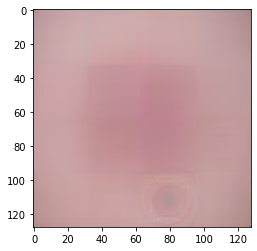

In [ ]:
plt.imshow(np.transpose(pred[0].detach().cpu().numpy(),(1,2,0)))

In [ ]:
pred=pred[0].detach().cpu().numpy()
mae_error = np.mean(np.abs(pred[0] - train_vae_data.__getitem__(21)[0].cpu().numpy()))
mae_error

0.09629371

## Находим порог

In [ ]:
th,max_errors=find_threshold(best_model,train_vae_data)

  0%|          | 0/2239 [00:00<?, ?it/s]

In [ ]:
th

0.318795

(array([ 0.65906601,  2.05958269,  2.141966  ,  3.87201013,  5.93159814,
         6.67304791,  7.24973106,  9.63883374,  8.23833076,  8.07356414,
        11.94557959, 10.95696485,  9.55646368, 10.38029675,  8.65024729,
         8.81501391,  7.4144773 ,  6.83781453,  6.34351468,  7.99118083,
         4.44869861,  5.10776507,  3.62486553,  4.3663153 ,  2.88340784,
         2.55388253,  2.38911592,  2.47149923,  2.55388253,  2.05958269,
         1.48289954,  1.15336314,  1.40051623,  0.74144977,  0.49429985,
         0.57668315,  0.57668315,  0.90621638,  0.16476662,  0.16476662,
         0.32953323,  0.16476662,  0.24714856,  0.        ,  0.        ,
         0.08238331,  0.        ,  0.        ,  0.        ,  0.08238331]),
 array([0.04772787, 0.05314922, 0.05857056, 0.0639919 , 0.06941324,
        0.07483459, 0.08025593, 0.08567727, 0.09109861, 0.09651995,
        0.10194129, 0.10736264, 0.11278398, 0.11820532, 0.12362666,
        0.129048  , 0.13446935, 0.1398907 , 0.14531204, 0.150733

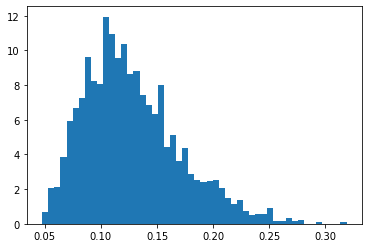

In [ ]:
max_errors=np.array(max_errors)
plt.hist(max_errors.ravel(), bins=50, density=True)

In [ ]:
import PIL

In [ ]:
img = PIL.Image.open("/content/f753d138df-nomark.jpg")
img_transform=transform_vae(img)
t_img=torch.tensor(img_transform)
t_img=torch.unsqueeze(t_img,0)
t_img=t_img.cuda()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
best_model.eval()
trans=best_model(t_img)

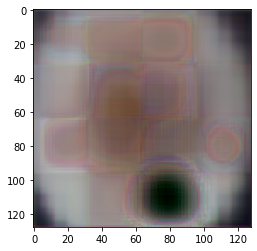

In [ ]:
plt.imshow(np.transpose(trans[0].detach().cpu().numpy(),(1,2,0)))

In [ ]:
pred=best_model(t_img)[0].detach().cpu().numpy()
mae_error = np.mean(np.abs(pred[0] - t_img.cpu().numpy()))
mae_error

0.28065243

##Поиск аномалий

['download (8).jpg', 'download (7).jpg', 'download (4).jpg', 'download (9).jpg', 'download (2).jpg', 'ISIC_0000165.jpg', 'download (10).jpg', 'ISIC_0000142.jpg', 'download (3).jpg', 'download (5).jpg', 'download (6).jpg', 'ISIC_0000175.jpg']


{'ISIC_0000142.jpg': ['no anomaly', 0.1862474],
 'ISIC_0000165.jpg': ['no anomaly', 0.19463664],
 'ISIC_0000175.jpg': ['no anomaly', 0.07419035],
 'download (10).jpg': ['no anomaly', 0.2004559],
 'download (2).jpg': ['anomaly', 0.29417548],
 'download (3).jpg': ['no anomaly', 0.20179622],
 'download (4).jpg': ['no anomaly', 0.23983575],
 'download (5).jpg': ['no anomaly', 0.23260792],
 'download (6).jpg': ['no anomaly', 0.21175432],
 'download (7).jpg': ['no anomaly', 0.24151534],
 'download (8).jpg': ['no anomaly', 0.2134906],
 'download (9).jpg': ['no anomaly', 0.19779365]}

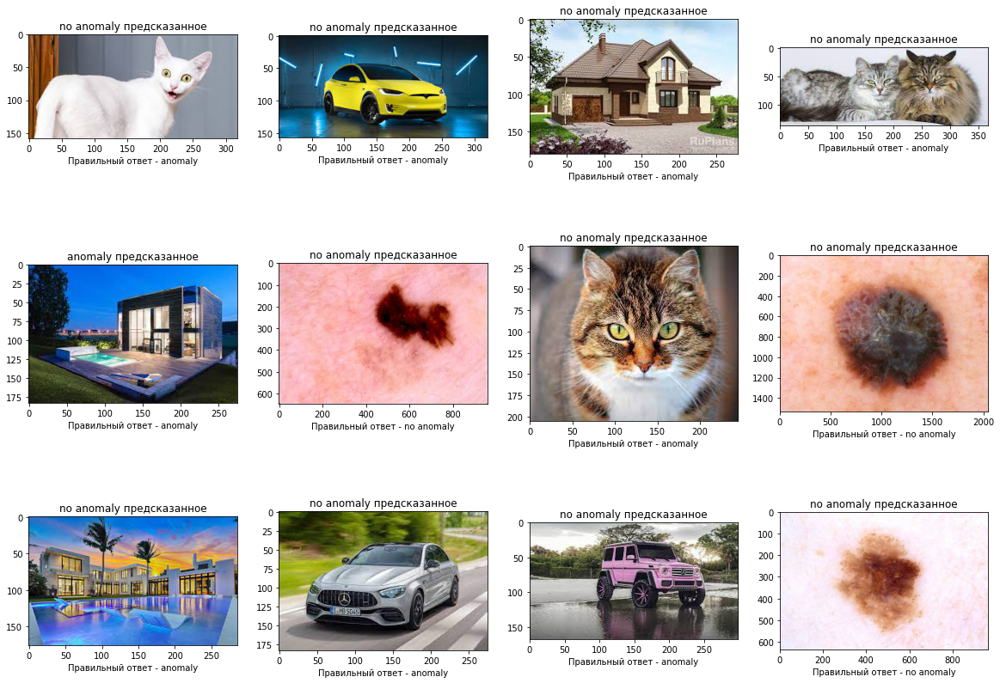

In [ ]:
show_anomalies(best_model,0.25)

In [ ]:
check_anomalies(best_model,0.25)

['download (8).jpg', 'download (7).jpg', 'download (4).jpg', 'download (9).jpg', 'download (2).jpg', 'ISIC_0000165.jpg', 'download (10).jpg', 'ISIC_0000142.jpg', 'download (3).jpg', 'download (5).jpg', 'download (6).jpg', 'ISIC_0000175.jpg']


{'ISIC_0000142.jpg': ['no anomaly', 0.1862474],
 'ISIC_0000165.jpg': ['no anomaly', 0.19463664],
 'ISIC_0000175.jpg': ['no anomaly', 0.07419035],
 'download (10).jpg': ['no anomaly', 0.2004559],
 'download (2).jpg': ['anomaly', 0.29417548],
 'download (3).jpg': ['no anomaly', 0.20179622],
 'download (4).jpg': ['no anomaly', 0.23983575],
 'download (5).jpg': ['no anomaly', 0.23260792],
 'download (6).jpg': ['no anomaly', 0.21175432],
 'download (7).jpg': ['no anomaly', 0.24151534],
 'download (8).jpg': ['no anomaly', 0.2134906],
 'download (9).jpg': ['no anomaly', 0.19779365]}

<h4>Данный ae плохо справился с проблемой поиска аномалий. Очень много ошибок</h4>

# Часть 1

<h4>Первая проблема, которую я решаю - это мультиклассовая классификация. Сеть должна распознать тип родинки, всего 9 классов</h4>

<h4>Данный набор состоит из 2357 изображений злокачественных и доброкачественных онкологических заболеваний, которые были сформированы из Международного Сотрудничества в Области Визуализации Кожи (ISIC). Все изображения были отсортированны в соответстие с классификацией взятой с ISIC, и все поднаборы были разделены на одинаковое количество изображений, за исключением меланом и родинок, чьи изображения немного преобладают.
</h4>

## Исследование данные на сбалансированость

### Тренировочные данные

In [ ]:
train_dict={}
for addrs,dirs,files in os.walk("/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Train"):
    for dir in dirs:
        for addrs_d,dirs_d,files_d in os.walk(f"/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Train/{dir}"):
            train_dict[dir]=len(files_d)
    break

In [ ]:
train_dict

{'actinic keratosis': 114,
 'basal cell carcinoma': 376,
 'dermatofibroma': 95,
 'melanoma': 438,
 'nevus': 357,
 'pigmented benign keratosis': 462,
 'seborrheic keratosis': 77,
 'squamous cell carcinoma': 181,
 'vascular lesion': 139}

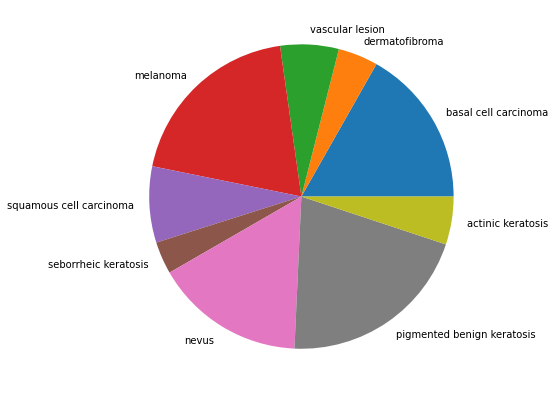

In [ ]:
fig = plt.figure(figsize =(10, 7))
plt.pie(list(train_dict.values()),labels =list(train_dict.keys()))
plt.show()

<h4>Как видно классы немного несбалансированны, но не критично</h4>

### Тестовые данные

In [ ]:
test_dict={}
for addrs,dirs,files in os.walk("/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Test"):
    for dir in dirs:
        for addrs_d,dirs_d,files_d in os.walk(f"/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Test/{dir}"):
            test_dict[dir]=len(files_d)
    break

In [ ]:
test_dict

{'actinic keratosis': 16,
 'basal cell carcinoma': 16,
 'dermatofibroma': 16,
 'melanoma': 16,
 'nevus': 16,
 'pigmented benign keratosis': 16,
 'seborrheic keratosis': 3,
 'squamous cell carcinoma': 16,
 'vascular lesion': 3}

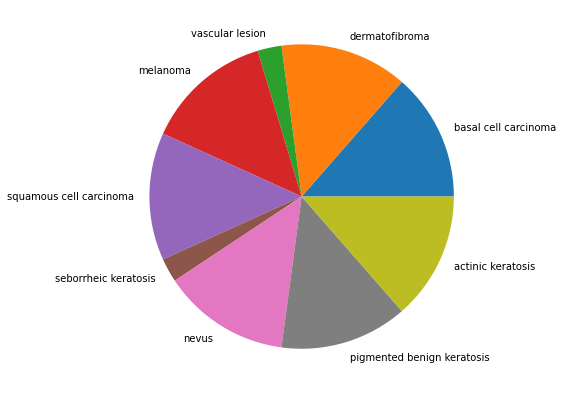

In [ ]:
fig = plt.figure(figsize =(10, 7))
plt.pie(list(test_dict.values()),labels =list(test_dict.keys()))
plt.show()

<h4>Данные относительно сбалансированны</h4>

## Подготовка данных

<h4>Я написал свой класс датасет и в getitem при обращении по индексу применил композицию трансформаций(которые имеют определенные вероятности) и тем самым на каждой эпохи при обращении по одному и тому же индексу я буду получать разные тензоры, тем самым реальных данных на входе в сеть будут поступать с определенными вероятностями. Вот так я реализовал аугментацию<h4>

In [ ]:
class CustomeDataset(Dataset):

    def __init__(self,filepath,transform=None):
        self.data=torchvision.datasets.ImageFolder(filepath)
        self.transform=transform

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        img,label=self.data[idx]
        img=img.convert('RGB')
        img=np.array(img)
        if self.transform:
            transformed=self.transform(image=img)
        
        return torch.tensor(np.transpose(transformed['image'],(2,0,1))),label

### transformations(аугментация)

In [ ]:
transform_train=A.Compose([  
        A.Resize(256,256),
        A.HorizontalFlip(p=0.5), 
        A.Rotate(limit=90,p=0.7),
        A.GaussNoise(p=0.5),
        A.RGBShift(p=0.5),
        Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])
transform_val=A.Compose([  
        A.Resize(256,256),
        Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])

inv_transform=A.Compose([
    Normalize(mean=[-0.485/0.229,-0.456/0.224,-0.406/0.225],std=[1/0.229,1/0.224,1/0.225],max_pixel_value=1)
])


In [ ]:
'''
Normalization is applied by the formula: img = (img - mean * max_pixel_value) / (std * max_pixel_value)
'''

'\nNormalization is applied by the formula: img = (img - mean * max_pixel_value) / (std * max_pixel_value)\n'

In [ ]:
train_data=CustomeDataset('/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Train',transform_train)
test_data=CustomeDataset('/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Test',transform_val)

<h4>Данные не имеют val, потому что во-первых он не был предоставлен в данных, а во вторых, он медицинский датасет и я сам не могу его разделить обычным train_test_split, потому что каждая родинка для каждого класса должны быть разная,а если я разделю данные с помощью train test split, то данные на val будут не репрезенативные</h4>

### Нормализация

<h4>Изобраение до нормализации</h4>

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

Text(0.5, 1.0, 'distribution of pixels')

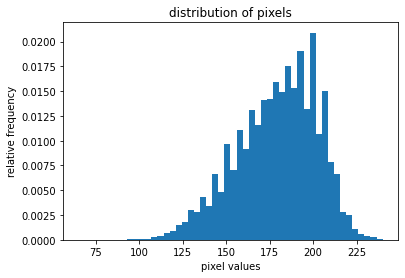

In [ ]:
img_np = Image.open("/content/Skin_cancer_ISIC_The_International_Skin_Imaging_Collaboration/Train/actinic keratosis/ISIC_0026040.jpg")
img_np=np.array(img_np)
plt.hist(img_np.ravel(), bins=50, density=True)
plt.xlabel("pixel values")
plt.ylabel("relative frequency")
plt.title("distribution of pixels")

<h4>Изобраение после нормализации</h4>

Text(0.5, 1.0, 'distribution of pixels')

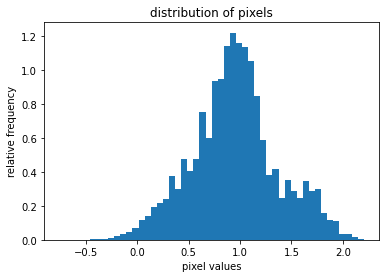

In [ ]:
img_np = train_data.__getitem__(6)[0]

plt.hist(img_np.ravel(), bins=50, density=True)
plt.xlabel("pixel values")
plt.ylabel("relative frequency")
plt.title("distribution of pixels")

## Show images

In [ ]:
def show_images(imgs,classes,network=None,aug=False):
    plt.figure(figsize=(30,30))
    if network:
      network.eval()
      with torch.no_grad():
          for i in range(1,5,1):
            idx = randint(1, len(imgs)-2)
            plt.subplot(1,4,i)
            img=imgs.__getitem__(idx)[0]

            img=img.cuda()
            img=torch.reshape(img,(1,3,256,256))

            y_predicted=network(img)

            y_predicted=torch.argmax(y_predicted,axis=1).detach().cpu().numpy()


            tr=inv_transform(image=np.transpose(imgs.__getitem__(idx)[0].numpy(),(1,2,0)))
            plt.imshow((tr["image"]*255).astype(np.uint8))

            plt.title(f"{classes[y_predicted[0]]} предсказанное")
            right_label=imgs.__getitem__(idx)[1]
            if right_label==y_predicted[0]:
              plt.xlabel(f"{classes[right_label]} \n правильно предсказано")
            else:
              plt.xlabel(f"{classes[right_label]} \n неправильно предсказано")

    else:
      for i in range(1,6,1):
          idx = randint(1, len(imgs))
          plt.subplot(1,5,i)
          tr=inv_transform(image=np.transpose(imgs.__getitem__(idx)[0].numpy(),(1,2,0)))
          plt.imshow((tr["image"]*255).astype(np.uint8))
          plt.title(classes[imgs.__getitem__(idx)[1]])

    if aug:
      idx = randint(1, len(imgs))
      for i in range(1,6,1):
          plt.subplot(1,5,i)
          tr=inv_transform(image=np.transpose(imgs.__getitem__(idx)[0].numpy(),(1,2,0)))
          plt.imshow((tr["image"]*255).astype(np.uint8))
          plt.title(classes[imgs.__getitem__(idx)[1]])

In [ ]:
classes={
    0:"actinic keratosis",
    1:"basal cell carcinoma",
    2:"dermatofibroma",
    3:"melanoma",
    4:"nevus",
    5:"pigmented benign keratosis",
    6:"seborrheic keratosis",
    7:"squamous cell carcinoma",
    8:"vascular lesion"
}
'''
0: старческий кератоз
1: базально-клеточная карцинома
2: фиброма кожи
3: меланома
4: родинка
5: пигментный доброкачественный кератоз
6: себорейный кератоз
7: плоскоклеточный рак
8: сосудистое поражение
'''

'\n0: старческий кератоз\n1: базально-клеточная карцинома\n2: фиброма кожи\n3: меланома\n4: родинка\n5: пигментный доброкачественный кератоз\n6: себорейный кератоз\n7: плоскоклеточный рак\n8: сосудистое поражение\n'

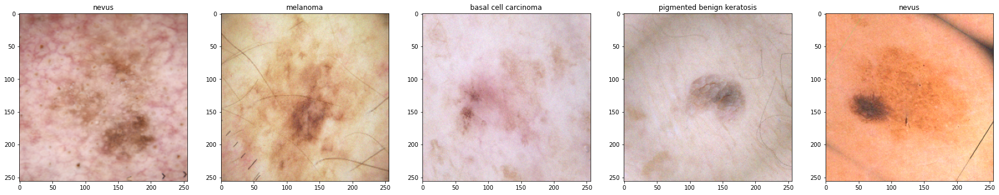

In [ ]:
show_images(train_data,classes)

<h4>Здесь показана аугментация</h4>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:40: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


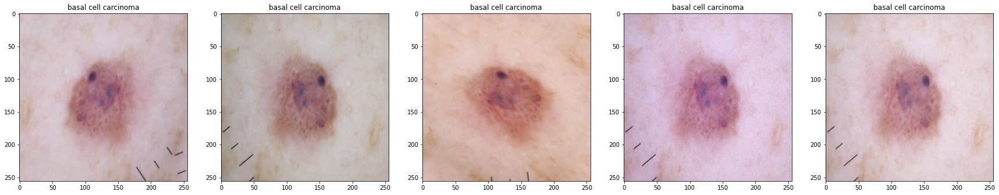

In [ ]:
show_images(train_data,classes,aug=True)

In [ ]:
train_loader=torch.utils.data.DataLoader(train_data,shuffle=True,batch_size=32,num_workers=2,pin_memory=True)
test_loader=torch.utils.data.DataLoader(test_data,shuffle=False,batch_size=64,num_workers=2,pin_memory=True)

## Train functions

<h4>Функция для тренировки</h4>

In [ ]:
def train_net(network,train_loader,val_loader,learning_rate=0.001,epochs=3,network_name=None,loaded_optimizer=None):
    optimizer=None
    if loaded_optimizer:
      optimizer=loaded_optimizer
    else:
      optimizer=torch.optim.AdamW(network.parameters(),lr=learning_rate) # Optimizer

    loss_fn=torch.nn.CrossEntropyLoss() # Функция стоимости
    best_accuracy=0
    errors=[] 
    errors_val=[]
    acc_val=[]
    network.train() # переводим сеть в состояние обучения
    
    for epoch in tqdm(range(epochs)):
        error=0
        for x_batch,y_batch in tqdm(train_loader):

            x_batch=x_batch.cuda() # передаем данные на куду
            y_batch=y_batch.cuda() 

            optimizer.zero_grad()
                
            y_pred=network(x_batch)
            loss=loss_fn(y_pred,y_batch)
                
            error+=loss.item()

            loss.backward()

            optimizer.step()        
            
        y_preds=[]
        y_trues=[]
        network.eval() #переводим сеть в состояние оценивание: исключаем слои, которые используются только train
        with torch.no_grad(): # временно устанавливает флаги requires_grad=False
            error_val=0
            for x_val,y_true in val_loader:
                x_val=x_val.cuda()    
                y_predicted=network(x_val)
                y_preds.append(torch.argmax(y_predicted,axis=1).detach().cpu().numpy())
                y_trues.append(y_true.detach().numpy())

                y_predicted=y_predicted.cuda()
                y_true=y_true.cuda()

                loss_val=loss_fn(y_predicted,y_true)
                error_val+=loss_val.item()
            errors_val.append(error_val/len(val_loader))
            y_preds_union=y_preds[0]
            for arr in y_preds[1:]:
                y_preds_union=np.concatenate((y_preds_union,arr))

            y_true_union=y_trues[0]
            for arr in y_trues[1:]:
                y_true_union=np.concatenate((y_true_union,arr))   

            acc=accuracy_score(y_true_union,y_preds_union)
            acc_val.append(acc)
            if best_accuracy<acc:
                print(f'Save best model with accuracy {acc}')
                state = {
                        'state_dict': network.state_dict(),
                        'optimizer' : optimizer.state_dict()}
                if network_name:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/{network_name}_best_model.pt") #Сохраняем наилучшую модель
                else:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/best_model.pt")
                best_accuracy=acc
            else:
                print(f"Don't save model. Accuracy is {acc}")

        network.train()
        
        print(f"{epoch}: {error/len(train_loader)}")
        errors.append(error/len(train_loader))
    return network,errors,errors_val,acc_val

## Test Function

<h4>Функция, которая тестирует сеть</h4>

In [ ]:
def test_network(network,test_cnn_loader):
  network.eval()
  y_preds=[]
  y_trues=[]
  with torch.no_grad():
      for x_test,y_true in test_cnn_loader:
          x_test=x_test.cuda()   
          y_predicted=network(x_test)
          y_preds.append(torch.argmax(y_predicted,axis=1).detach().cpu().numpy())
          y_trues.append(y_true.detach().numpy())

      y_preds_union=y_preds[0]
      for arr in y_preds[1:]:
          y_preds_union=np.concatenate((y_preds_union,arr))

      y_true_union=y_trues[0]
      for arr in y_trues[1:]:
          y_true_union=np.concatenate((y_true_union,arr))  

      print(classification_report(y_true_union,y_preds_union))
      
  return 1

## Plot acc, error

<h4>Строит графики того как изменяется ошибка и точность на каждой эпохе</h4>

In [ ]:
def plot_acc_error(train_error, val_error, val_accuracy):
  plt.figure(figsize=(20,5))

  plt.subplot(1,3,1)
  plt.plot(train_error)
  plt.title("Train")
  plt.xlabel("epoch")
  plt.ylabel("error")

  plt.subplot(1,3,2)
  plt.plot(val_error)
  plt.title("Val")
  plt.xlabel("epoch")
  plt.ylabel("error")

  plt.subplot(1,3,3)
  plt.plot(val_accuracy)
  plt.title("Val")
  plt.xlabel("epoch")
  plt.ylabel("acc")

## Файнтюнинг крупных сверточных сетей

<h3>Суть:<p><h4>Замораживаются верхние (первые) слои сети, нижние дообучаются, так как первые слои выделяют низкоуровневую информацию, а последние выделяют информацию под мою конкретную задачу<h4><p> <h3>

### VGG-16

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

24964

#### Загрузка модели

<h4>num_params = 138357544</h4>

In [ ]:
from torchvision.models import vgg16
vgg16 = vgg16(pretrained=True)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

#### Файнюнинг Vgg16

##### Удаление последнего слоя

In [ ]:
vgg16.classifier=torch.nn.Sequential(*list(vgg16.classifier.children())[:-1])

In [ ]:
vgg16.parameters

<bound method Module.parameters of VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size

##### Добавление слоев в сеть

In [ ]:
class MyVgg16(torch.nn.Module):
    def __init__(self,network):
        super(MyVgg16,self).__init__()
        self.fc1=torch.nn.Linear(4096,128)
        self.fc2=torch.nn.Linear(128,9)
        self.network=network
        for param in self.network.features.parameters():
            param.requires_grad=False

        self.dropout=torch.nn.Dropout(0.4)
        self.bn=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn(self.fc1(x))))
        x=self.fc2(x)
        return x

#### Тренировка

In [ ]:
my_vgg16=MyVgg16(vgg16).cuda()

In [ ]:
final_net,errors_train,errors_val,acc_val=train_net(my_vgg16,train_loader,test_loader,network_name="MyVgg16_256",epochs=20)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3389830508474576
0: 128.70391535758972


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3644067796610169
1: 102.75991988182068


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3644067796610169
2: 95.62327116727829


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3813559322033898
3: 87.59243369102478


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3983050847457627
4: 82.89578866958618


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4491525423728814
5: 82.67157870531082


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3474576271186441
6: 76.35478729009628


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4152542372881356
7: 73.87645077705383


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4491525423728814
8: 73.57919406890869


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.423728813559322
9: 71.2963063120842


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4576271186440678
10: 69.28505223989487


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4322033898305085
11: 65.70574820041656


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4745762711864407
12: 63.510674357414246


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4661016949152542
13: 64.26855462789536


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4830508474576271
14: 62.2964506149292


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.423728813559322
15: 59.83041885495186


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5169491525423728
16: 58.51122182607651


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5254237288135594
17: 59.03229337930679


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5084745762711864
18: 60.610825419425964


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5
19: 57.09555819630623


#### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/MyVgg16_256_best_model.pt")

In [ ]:
best_model=MyVgg16(vgg16).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

#### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       0.70      0.44      0.54        16
           1       0.63      0.75      0.69        16
           2       1.00      0.38      0.55        16
           3       0.10      0.06      0.08        16
           4       0.44      0.88      0.58        16
           5       0.48      0.88      0.62        16
           6       0.00      0.00      0.00         3
           7       0.62      0.31      0.42        16
           8       0.75      1.00      0.86         3

    accuracy                           0.53       118
   macro avg       0.53      0.52      0.48       118
weighted avg       0.56      0.53      0.49       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>Результаты не очень хорошие, попробую сделать лучше</h4>

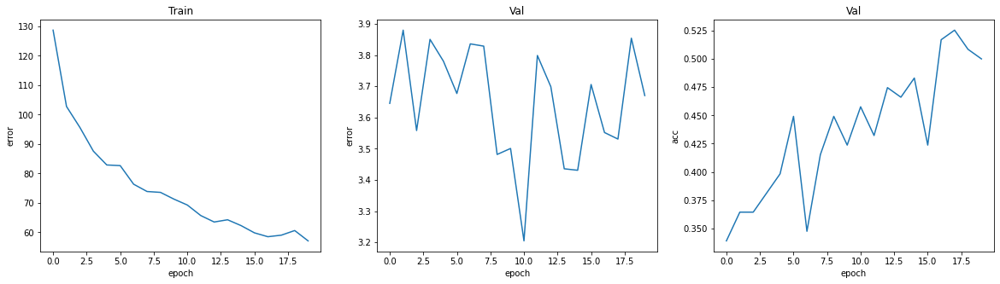

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

<h4>Как видно из результатов ошибка на train падает, а точность на val растет</h4>

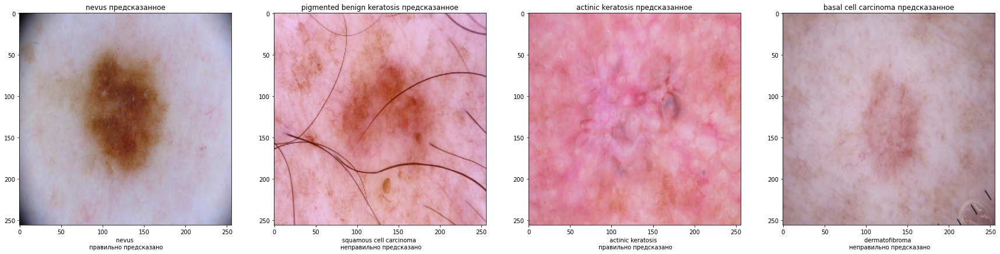

In [ ]:
show_images(test_data,classes,network=best_model) 

## VGG-16 но уже без заморозки промежуточных слоев

<h4>Я могу предположить, что такие не очень хорошие результаты моги быть из-за того, что я заморозил слои сверток, как мы знаем на перых слоях происходит выделление общих признаков, но это хорошо работает когда мы работаем с обычными объектами, а не родинками. Родинки похожи одна на другую, поэтому нужно разморозить начальные слои для того, чтобы выделить признаки которые соответсвуют различным типам родинок</h4>

In [ ]:
from torchvision.models import vgg16
vgg16 = vgg16(pretrained=True)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


#### Удаление последнего слоя

In [ ]:
vgg16.classifier=torch.nn.Sequential(*list(vgg16.classifier.children())[:-1])

In [ ]:
vgg16.parameters

In [ ]:
class NewVgg16(torch.nn.Module):
    def __init__(self,network):
        super(NewVgg16,self).__init__()
        self.fc1=torch.nn.Linear(4096,128)
        self.fc2=torch.nn.Linear(128,9)
        self.network=network

        self.dropout=torch.nn.Dropout(0.4)
        self.bn=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn(self.fc1(x))))
        x=self.fc2(x)
        return x

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

1119

#### Тренировка

In [ ]:
new_vgg16=NewVgg16(vgg16).cuda()

In [ ]:
final_net,errors_train,errors_val,acc_val=train_net(new_vgg16,train_loader,test_loader,network_name="NewVgg16_256",epochs=15)

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.2288135593220339
0: 138.8317005634308


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.23728813559322035
1: 133.78893506526947


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3135593220338983
2: 126.67367160320282


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3050847457627119
3: 120.67308616638184


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.2796610169491525
4: 117.4515632390976


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3050847457627119
5: 113.42192113399506


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3305084745762712
6: 111.87357330322266


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3389830508474576
7: 108.73173487186432


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3050847457627119
8: 109.93067479133606


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3389830508474576
9: 107.91923582553864


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3220338983050847
10: 108.16895461082458


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.288135593220339
11: 105.4661318063736


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3389830508474576
12: 106.32416129112244


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3305084745762712
13: 104.91326856613159


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3220338983050847
14: 104.9022843837738


#### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/NewVgg16_256_best_model.pt")

In [ ]:
best_model=NewVgg16(vgg16).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

#### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        16
           1       0.31      0.56      0.40        16
           2       0.00      0.00      0.00        16
           3       0.11      0.06      0.08        16
           4       0.50      0.94      0.65        16
           5       0.28      0.81      0.42        16
           6       0.00      0.00      0.00         3
           7       0.00      0.00      0.00        16
           8       0.50      0.67      0.57         3

    accuracy                           0.34       118
   macro avg       0.19      0.34      0.24       118
weighted avg       0.18      0.34      0.22       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>Как видно из результатов, моя гипотеза не подтвердилась и если не замораживать веса, то результаты получатся еще хуже</h4>

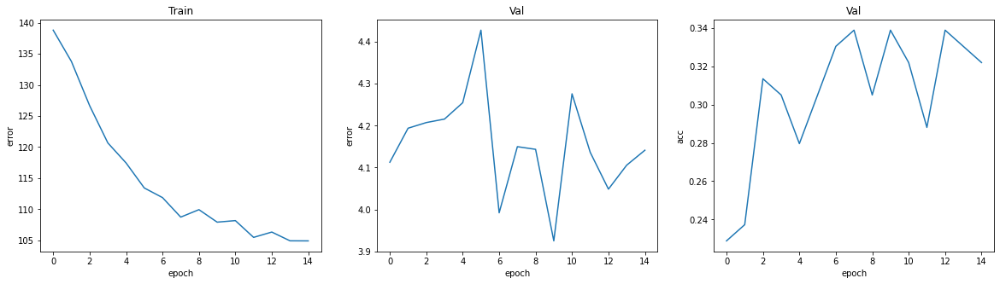

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

<h4>Как видно из результатов ошибка на train падает, а точность на val растет</h4>

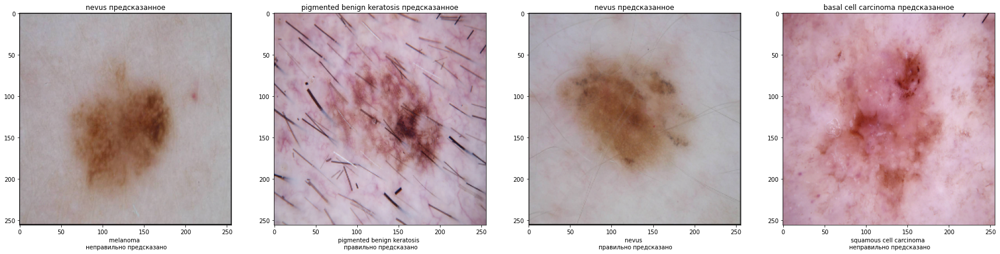

In [ ]:
show_images(test_data,classes,network=best_model) 

## WIDE_RESNET50_2

<h4>num_params = 68883240</h4>

In [ ]:
from torchvision.models import wide_resnet50_2
from torchvision.models import Wide_ResNet50_2_Weights
wide_res = wide_resnet50_2(weights=Wide_ResNet50_2_Weights.IMAGENET1K_V2)

In [ ]:
wide_res.parameters

<bound method Module.parameters of ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d

In [ ]:
wide_res.fc=torch.nn.Sequential(*list(wide_res.fc.children())[:-1])

In [ ]:
wide_res.parameters

<bound method Module.parameters of ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d

In [ ]:
class MyWideRestNet(torch.nn.Module):
    def __init__(self,network):
        super(MyWideRestNet,self).__init__()
        self.fc1=torch.nn.Linear(2048,128)
        self.fc2=torch.nn.Linear(128,9)
        self.network=network

        self.dropout=torch.nn.Dropout(0.4)
        self.bn=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn(self.fc1(x))))
        x=self.fc2(x)
        return x

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

710

#### Тренировка

In [ ]:
my_wide_res=MyWideRestNet(wide_res).cuda()

In [ ]:
final_net,errors_train,errors_val,acc_val=train_net(my_wide_res,train_loader,test_loader,network_name="WIDE_RESNET50_2_256",epochs=15)

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3050847457627119
0: 111.25503969192505


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4152542372881356
1: 88.85014683008194


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4152542372881356
2: 82.12730038166046


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4915254237288136
3: 75.9265930056572


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4322033898305085
4: 71.42973828315735


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4745762711864407
5: 68.05200070142746


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4576271186440678
6: 63.26960536837578


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4830508474576271
7: 61.21246001124382


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4406779661016949
8: 62.13991665840149


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5
9: 59.800300896167755


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4661016949152542
10: 55.71298497915268


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4745762711864407
11: 56.482808858156204


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5423728813559322
12: 53.259389758110046


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.576271186440678
13: 52.330136477947235


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4491525423728814
14: 50.095737755298615


#### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/WIDE_RESNET50_2_256_best_model.pt")

In [ ]:
best_model=MyWideRestNet(wide_res).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

#### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       1.00      0.44      0.61        16
           1       0.71      0.75      0.73        16
           2       1.00      0.50      0.67        16
           3       0.20      0.06      0.10        16
           4       0.36      1.00      0.53        16
           5       0.60      0.94      0.73        16
           6       0.00      0.00      0.00         3
           7       0.67      0.38      0.48        16
           8       1.00      1.00      1.00         3

    accuracy                           0.58       118
   macro avg       0.62      0.56      0.54       118
weighted avg       0.64      0.58      0.55       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>Результаты лучше чем у vgg16, хотя модель имеет меньше весов</h4>

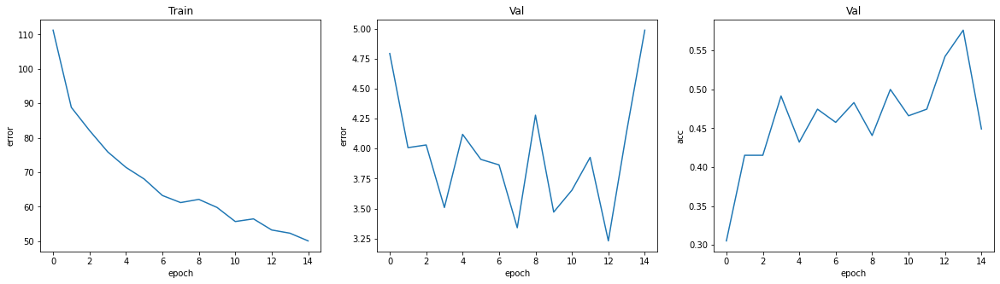

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

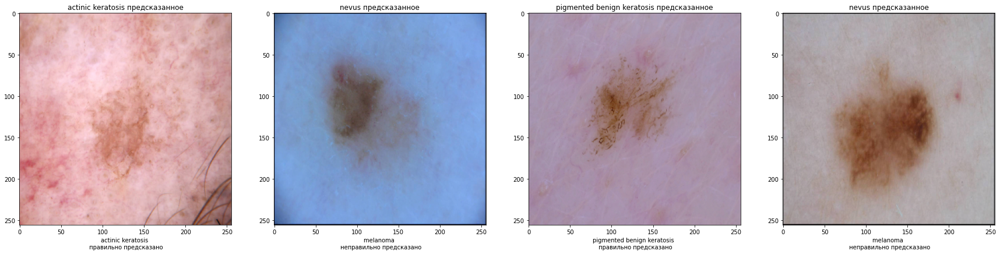

In [ ]:
show_images(test_data,classes,network=best_model) 

## WIDE_RESNET50_2 только длинный fc

In [ ]:
from torchvision.models import wide_resnet50_2
from torchvision.models import Wide_ResNet50_2_Weights
wide_res = wide_resnet50_2(weights=Wide_ResNet50_2_Weights.IMAGENET1K_V2)

In [ ]:
wide_res.parameters

<bound method Module.parameters of ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d

In [ ]:
wide_res.fc=torch.nn.Sequential(*list(wide_res.fc.children())[:-1])

In [ ]:
wide_res.parameters

<bound method Module.parameters of ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d

In [ ]:
class MyWideLongRestNet(torch.nn.Module):
    def __init__(self,network):
        super(MyWideLongRestNet,self).__init__()
        self.fc1=torch.nn.Linear(2048,1024)
        self.fc2=torch.nn.Linear(1024,256)
        self.fc3=torch.nn.Linear(256,128)
        self.fc4=torch.nn.Linear(128,9)
        self.network=network

        self.dropout=torch.nn.Dropout(0.4)
        self.bn1=torch.nn.BatchNorm1d(1024)
        self.bn2=torch.nn.BatchNorm1d(256)
        self.bn3=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn1(self.fc1(x))))
        x=self.dropout(self.relu(self.bn2(self.fc2(x))))
        x=self.dropout(self.relu(self.bn3(self.fc3(x))))
        x=self.fc4(x)
        return x

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

419

#### Тренировка

In [ ]:
my_wide_long_res=MyWideLongRestNet(wide_res).cuda()

In [ ]:
final_net,errors_train,errors_val,acc_val=train_net(my_wide_long_res,train_loader,test_loader,network_name="WIDE_LONG_RESNET50_2_256",epochs=12)

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3898305084745763
0: 1.9027612379619054


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3135593220338983
1: 1.6374872497149877


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4576271186440678
2: 1.4531251345361982


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3813559322033898
3: 1.391376518351691


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3644067796610169
4: 1.302401672090803


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.3135593220338983
5: 1.2393939554691316


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4322033898305085
6: 1.200567716360092


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4576271186440678
7: 1.1526973451886857


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4830508474576271
8: 1.1295901605061123


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4322033898305085
9: 1.0564253219536373


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5254237288135594
10: 1.0588237685816628


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4915254237288136
11: 1.0094987715993609


#### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/WIDE_LONG_RESNET50_2_256_best_model.pt")

In [ ]:
best_model=MyWideLongRestNet(wide_res).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

#### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       1.00      0.25      0.40        16
           1       0.80      0.75      0.77        16
           2       0.70      0.44      0.54        16
           3       0.07      0.06      0.06        16
           4       0.48      0.88      0.62        16
           5       0.52      0.88      0.65        16
           6       0.00      0.00      0.00         3
           7       0.50      0.44      0.47        16
           8       0.75      1.00      0.86         3

    accuracy                           0.53       118
   macro avg       0.54      0.52      0.49       118
weighted avg       0.57      0.53      0.50       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>Результаты хуже чем у wide_resnet50_2 с коротким выходным слоем</h4>

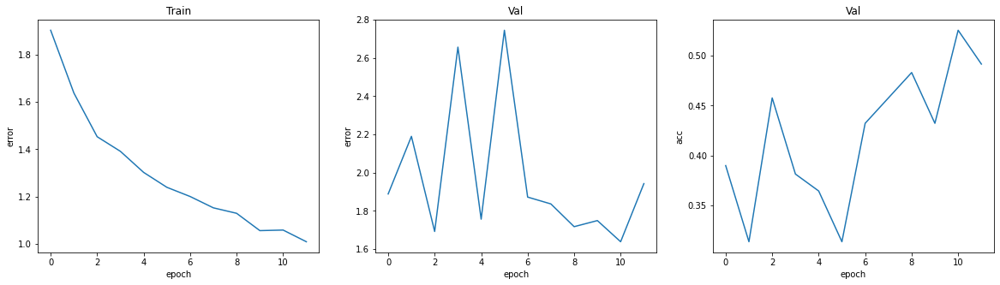

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

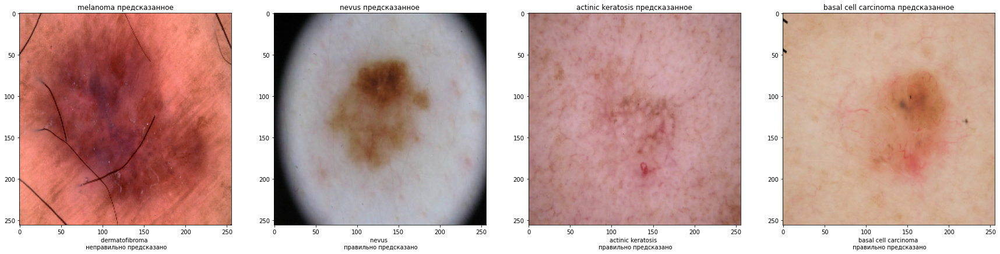

In [ ]:
show_images(test_data,classes,network=best_model) 

## EfficientNet_V2_L

### Архитектура

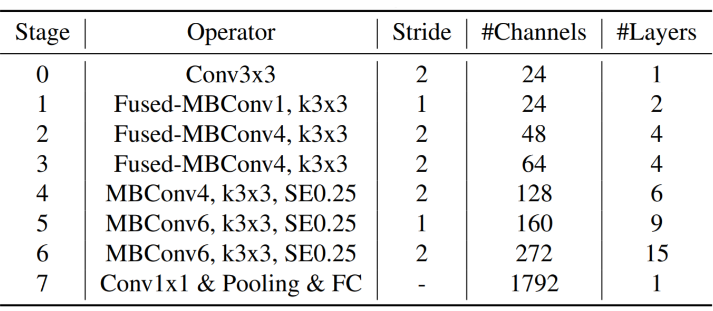

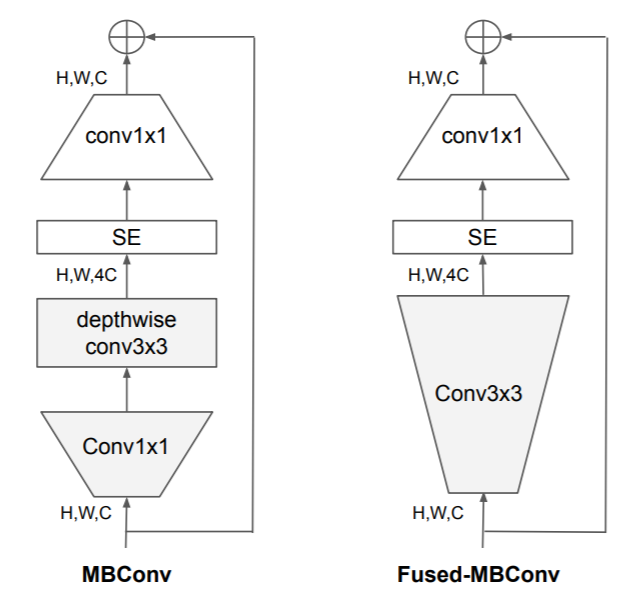

<h4>num_params = 12233232
</h4>

<h4>Специально выбралл маленькую сеть, чтобы посмотреть как она справиться с поставленной задачей</h4>

In [ ]:
from torchvision.models import efficientnet_b3
from torchvision.models import EfficientNet_B3_Weights
efficientnet = efficientnet_b3(weights=EfficientNet_B3_Weights.IMAGENET1K_V1)

Downloading: "https://download.pytorch.org/models/efficientnet_b3_rwightman-cf984f9c.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b3_rwightman-cf984f9c.pth


  0%|          | 0.00/47.2M [00:00<?, ?B/s]

In [ ]:
efficientnet.parameters

<bound method Module.parameters of EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
            (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
       

In [ ]:
efficientnet.classifier=torch.nn.Sequential(*list(efficientnet.classifier.children())[:-1])

In [ ]:
efficientnet.parameters

<bound method Module.parameters of EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
            (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
       

In [ ]:
class MyEfficientnet(torch.nn.Module):
    def __init__(self,network):
        super(MyEfficientnet,self).__init__()
        self.fc1=torch.nn.Linear(1536,128)
        self.fc2=torch.nn.Linear(128,9)
        self.network=network

        self.dropout=torch.nn.Dropout(0.4)
        self.bn1=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn1(self.fc1(x))))
        x=self.fc2(x)
        return x

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

375

### Тренировка

In [ ]:
my_efficientnet=MyEfficientnet(efficientnet).cuda()

In [ ]:
final_net,errors_train,errors_val,acc_val=train_net(my_efficientnet,train_loader,test_loader,network_name="MyEfficientnet_256",epochs=12)

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5169491525423728
0: 1.5126471076692853


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5
1: 1.1065772014004844


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5
2: 0.9703523925372532


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.576271186440678
3: 0.8964567533561162


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5423728813559322
4: 0.8067348497254508


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.652542372881356
5: 0.71999665754182


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.576271186440678
6: 0.686632805636951


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.6440677966101694
7: 0.661038709964071


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.6610169491525424
8: 0.6236256395067488


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5847457627118644
9: 0.5787075826099941


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.6101694915254238
10: 0.5410359923328673


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.6779661016949152
11: 0.5118569680622646


### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/MyEfficientnet_256_best_model.pt")

In [ ]:
best_model=MyEfficientnet(efficientnet).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       0.91      0.62      0.74        16
           1       0.74      0.88      0.80        16
           2       0.91      0.62      0.74        16
           3       0.33      0.38      0.35        16
           4       0.50      0.94      0.65        16
           5       0.93      0.81      0.87        16
           6       0.00      0.00      0.00         3
           7       0.82      0.56      0.67        16
           8       0.75      1.00      0.86         3

    accuracy                           0.68       118
   macro avg       0.65      0.65      0.63       118
weighted avg       0.72      0.68      0.68       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>Результаты получились самые лучшие</h4>

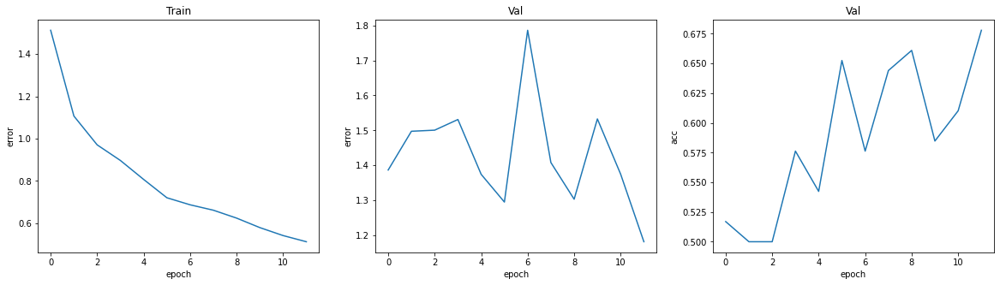

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

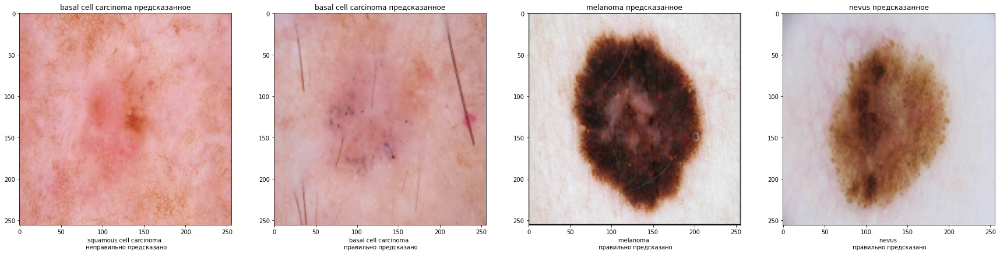

In [ ]:
show_images(test_data,classes,network=best_model) 

<h4>Результаты получились самые лучшие</h4>

## EfficientNet_V2_L с заморозкой промежуточных слоев

In [ ]:
from torchvision.models import efficientnet_b3
from torchvision.models import EfficientNet_B3_Weights
efficientnet = efficientnet_b3(weights=EfficientNet_B3_Weights.IMAGENET1K_V1)

Downloading: "https://download.pytorch.org/models/efficientnet_b3_rwightman-cf984f9c.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b3_rwightman-cf984f9c.pth


  0%|          | 0.00/47.2M [00:00<?, ?B/s]

In [ ]:
efficientnet.parameters

<bound method Module.parameters of EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
            (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
       

In [ ]:
efficientnet.classifier=torch.nn.Sequential(*list(efficientnet.classifier.children())[:-1])

In [ ]:
efficientnet.parameters

<bound method Module.parameters of EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
            (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
       

In [ ]:
class MyEfficientnet(torch.nn.Module):
    def __init__(self,network):
        super(MyEfficientnet,self).__init__()
        self.fc1=torch.nn.Linear(1536,128)
        self.fc2=torch.nn.Linear(128,9)
        self.network=network
        for param in self.network.features.parameters():
            param.requires_grad=False
        self.dropout=torch.nn.Dropout(0.4)
        self.bn1=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn1(self.fc1(x))))
        x=self.fc2(x)
        return x

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

770

### Тренировка

In [ ]:
my_efficientnet=MyEfficientnet(efficientnet).cuda()

In [ ]:
final_net,errors_train,errors_val,acc_val=train_net(my_efficientnet,train_loader,test_loader,network_name="MyEfficientnetrgfalse_256",epochs=12)

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3644067796610169
0: 1.8079757843698774


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3813559322033898
1: 1.5322606989315577


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4322033898305085
2: 1.446733580316816


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4745762711864407
3: 1.3950445652008057


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4745762711864407
4: 1.3466706803866795


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4830508474576271
5: 1.3428039312362672


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4915254237288136
6: 1.3059913277626038


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5254237288135594
7: 1.304683985880443


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5169491525423728
8: 1.2645373088972909


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5423728813559322
9: 1.2558463292462485


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5338983050847458
10: 1.2956296307700021


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5254237288135594
11: 1.2613844786371504


### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/MyEfficientnetrgfalse_256_best_model.pt")

In [ ]:
best_model=MyEfficientnet(efficientnet).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       1.00      0.25      0.40        16
           1       0.65      0.69      0.67        16
           2       0.88      0.44      0.58        16
           3       0.29      0.25      0.27        16
           4       0.48      1.00      0.65        16
           5       0.48      0.81      0.60        16
           6       0.00      0.00      0.00         3
           7       0.60      0.38      0.46        16
           8       0.60      1.00      0.75         3

    accuracy                           0.54       118
   macro avg       0.55      0.53      0.49       118
weighted avg       0.61      0.54      0.51       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>Результаты получились самые лучшие</h4>

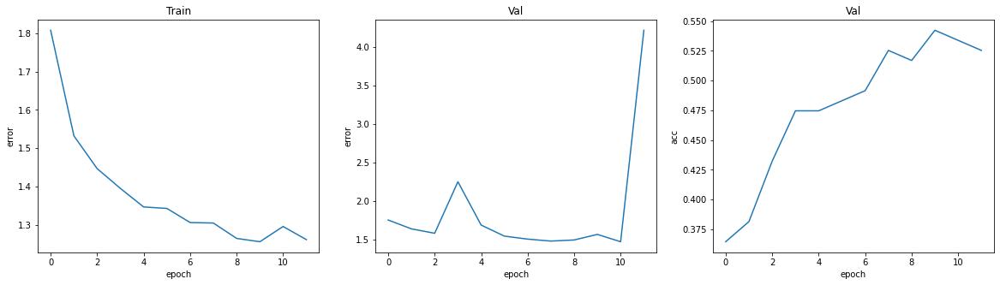

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

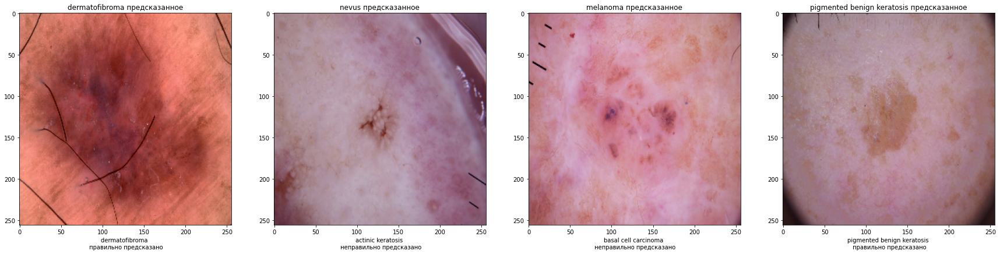

In [ ]:
show_images(test_data,classes,network=best_model) 

## MOBILENET_V3_SMALL

<h4>num_params = 2542856
</h4>

<h4>Специально выбралл маленькую сеть, чтобы она в будущем выступала как модель ученика</h4>

In [ ]:
from torchvision.models import mobilenet_v3_small
from torchvision.models import MobileNet_V3_Small_Weights
mobilenet = mobilenet_v3_small(weights=MobileNet_V3_Small_Weights.IMAGENET1K_V1)

In [ ]:
mobilenet.parameters

<bound method Module.parameters of MobileNetV3(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(16, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 16, kernel_size=(1, 1), stride=(1, 1))
          (activation): ReLU()
          (scale_activation): Hardsigmoid()
        )
        (2): Conv2dNormActivation(
          (0): 

In [ ]:
mobilenet.classifier=torch.nn.Sequential(*list(mobilenet.classifier.children())[:-1])

In [ ]:
mobilenet.parameters

<bound method Module.parameters of MobileNetV3(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
      (2): Hardswish()
    )
    (1): InvertedResidual(
      (block): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=16, bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.01, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
        (1): SqueezeExcitation(
          (avgpool): AdaptiveAvgPool2d(output_size=1)
          (fc1): Conv2d(16, 8, kernel_size=(1, 1), stride=(1, 1))
          (fc2): Conv2d(8, 16, kernel_size=(1, 1), stride=(1, 1))
          (activation): ReLU()
          (scale_activation): Hardsigmoid()
        )
        (2): Conv2dNormActivation(
          (0): 

In [ ]:
class MyMobilenet(torch.nn.Module):
    def __init__(self,network):
        super(MyMobilenet,self).__init__()
        self.fc1=torch.nn.Linear(1024,128)
        self.fc2=torch.nn.Linear(128,9)
        self.network=network

        self.dropout=torch.nn.Dropout(0.4)
        self.bn1=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn1(self.fc1(x))))
        x=self.fc2(x)
        return x

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

557

#### Тренировка

In [ ]:
my_mobilenet=MyMobilenet(mobilenet).cuda()

In [ ]:
final_net,errors_train,errors_val,acc_val=train_net(my_mobilenet,train_loader,test_loader,network_name="MyMobilenet_256",epochs=12)

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3728813559322034
0: 1.498209261042731


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.3983050847457627
1: 1.136753091641835


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5
2: 1.007685548067093


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5338983050847458
3: 0.9381669291428157


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5084745762711864
4: 0.8627036711999349


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4830508474576271
5: 0.7913833188159125


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5084745762711864
6: 0.7599019391196115


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.576271186440678
7: 0.7436803822006498


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4576271186440678
8: 0.6914856310401644


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5508474576271186
9: 0.6561633229255677


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5084745762711864
10: 0.6150210074016026


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.6271186440677966
11: 0.5962584355047771


#### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/MyMobilenet_256_best_model.pt")

In [ ]:
best_model=MyMobilenet(mobilenet).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

#### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       0.65      0.69      0.67        16
           1       0.92      0.69      0.79        16
           2       0.88      0.44      0.58        16
           3       0.33      0.44      0.38        16
           4       0.50      0.94      0.65        16
           5       0.73      0.69      0.71        16
           6       0.00      0.00      0.00         3
           7       0.75      0.56      0.64        16
           8       1.00      1.00      1.00         3

    accuracy                           0.63       118
   macro avg       0.64      0.60      0.60       118
weighted avg       0.67      0.63      0.62       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>Результаты чуть хуже чем у EfficientNet_V2_L</h4>

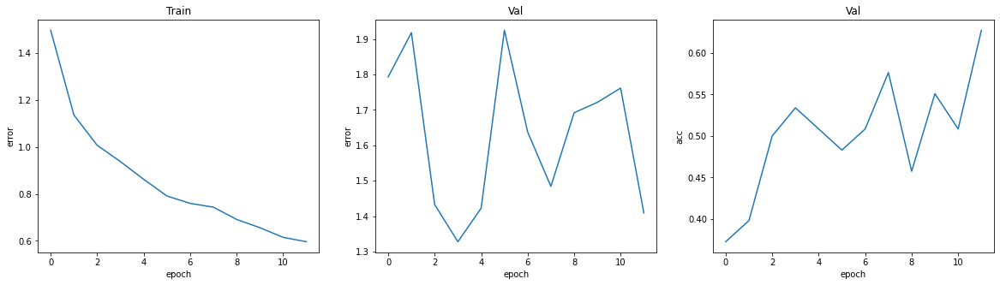

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

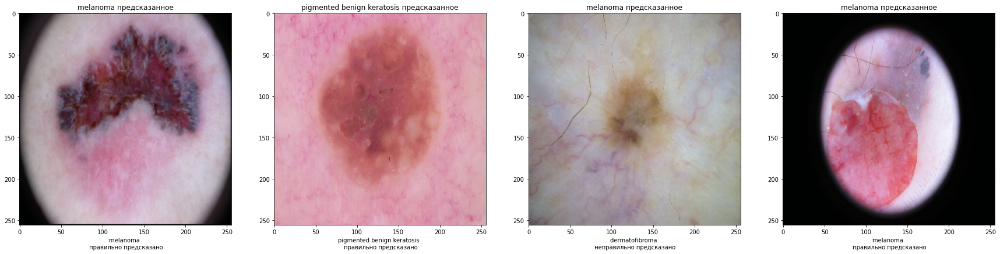

In [ ]:
show_images(test_data,classes,network=best_model) 

<h4>Результаты неплохие, модель эта маленькая поэтому попробуем ее дистиллировать</h4>

## Дистилляция

<h3>Суть:<p><h4>В реальности очень большие модели, тяжело интегрировать в продакшен, одна из причин это огромный вес модели. Поэтому придумали подход, благодаря которому маленькая модель может получить похожие результаты как и большая или даже лучше. В начале мы обучем большую модель на основе наших данных, потом тренируем маленькую модель на основе тех же данных в связке с этой большой сетью и интегрируем в продакшен маленькую модель. В качестве учителя будет выступать EfficientNet_V2_L, а в качестве ученика MOBILENET_V3_SMALL. Размер модели ученика в 5 раз меньше модели учителя, а точность хуже на 5%</h4></p></h3>

### Модель учителя

<h4>В качестве модели учителя возьмем EfficientNet_V2_L, так как она дала самые лучшие результаты на тестовых данных</h4>

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/MyEfficientnet_256_best_model.pt")

In [ ]:
teacher_model=MyEfficientnet(efficientnet).cuda()
teacher_model.load_state_dict(state['state_dict'])

<All keys matched successfully>

In [ ]:
test_network(teacher_model,test_loader)

              precision    recall  f1-score   support

           0       0.91      0.62      0.74        16
           1       0.74      0.88      0.80        16
           2       0.91      0.62      0.74        16
           3       0.33      0.38      0.35        16
           4       0.50      0.94      0.65        16
           5       0.93      0.81      0.87        16
           6       0.00      0.00      0.00         3
           7       0.82      0.56      0.67        16
           8       0.75      1.00      0.86         3

    accuracy                           0.68       118
   macro avg       0.65      0.65      0.63       118
weighted avg       0.72      0.68      0.68       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

### Модель ученика

<h4>В качестве модели ученика возьму MOBILENET_V3_SMALL</h4>

In [ ]:
from torchvision.models import mobilenet_v3_small
from torchvision.models import MobileNet_V3_Small_Weights
mobilenet = mobilenet_v3_small(weights=MobileNet_V3_Small_Weights.IMAGENET1K_V1)

In [ ]:
mobilenet.classifier=torch.nn.Sequential(*list(mobilenet.classifier.children())[:-1])

In [ ]:
class StudentModel(torch.nn.Module):
    def __init__(self,network):
        super(StudentModel,self).__init__()
        self.fc1=torch.nn.Linear(1024,128)
        self.fc2=torch.nn.Linear(128,9)
        self.network=network

        self.dropout=torch.nn.Dropout(0.4)
        self.bn1=torch.nn.BatchNorm1d(128)
        self.relu=torch.nn.ReLU()

    def forward(self,x):
        x=self.network(x)
        x=self.dropout(self.relu(self.bn1(self.fc1(x))))
        x=self.fc2(x)
        return x

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

1283

### Функции дистилляции

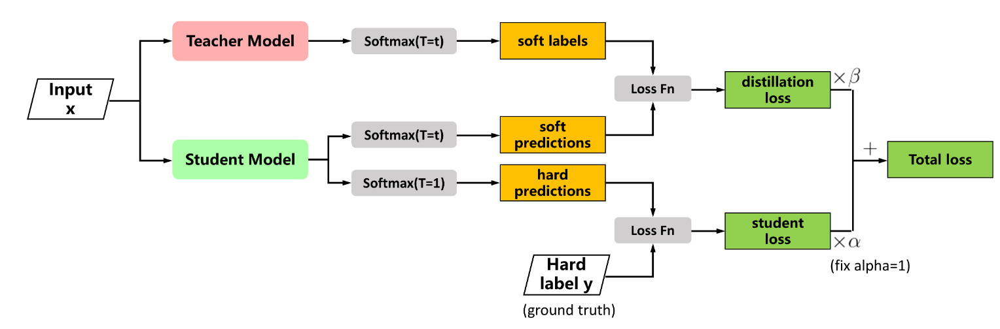

<h4>Как показанно на схеме функция стоимости состоит из суммы CE и дивергенции кульбака-лейблера умноженные на свои коэффициенты. В CE в качестве правидьных результатов hard label, то есть one-hot-vector, а в KL подается в качестве правильных результатов soft label модели учителя</h4>

<h4>Также softmax не обычный, а с сглаживающим параметром</h4>

In [ ]:
def loss_fn_kd(outputs,labels,teacher_output,alpha,T):
  ce_loss=torch.nn.CrossEntropyLoss()
  kl_loss = torch.nn.KLDivLoss(reduction="batchmean")
  log_softmax=torch.nn.LogSoftmax(dim=1)
  softmax=torch.nn.Softmax(dim=1)
  loss = ce_loss(outputs,labels)*(1.-alpha) +  kl_loss(log_softmax(outputs/T),softmax(teacher_output/T))*(alpha*T*T)
  return loss

### Train distillation

In [ ]:
def train_kd(network, teacher_model, optimizer, loss_fn_kd, train_loader, val_loader, alpha, T,epochs=3,network_name=None):
    loss_fn=torch.nn.CrossEntropyLoss()
    best_accuracy=0
    errors=[] 
    errors_val=[]
    acc_val=[]
    network.train() # переводим сеть в состояние обучения
    teacher_model.eval()
    for epoch in tqdm(range(epochs)):
        error=0
        for x_batch,y_batch in tqdm(train_loader):

            x_batch=x_batch.cuda() # передаем данные на куду
            y_batch=y_batch.cuda() 

            optimizer.zero_grad()
                
            y_pred=network(x_batch)

            with torch.no_grad():
                y_pred_teacher=teacher_model(x_batch)
            y_pred_teacher.requires_grad=False
            loss=loss_fn_kd(y_pred,y_batch,y_pred_teacher,alpha,T) # Функция стоимости для KD
                
            error+=loss.item()

            loss.backward()

            optimizer.step()         
            
        y_preds=[]
        y_trues=[]
        network.eval() #переводим сеть в состояние оценивание: исключаем слои, которые используются только train
        with torch.no_grad(): # временно устанавливает флаги requires_grad=False
            error_val=0
            for x_val,y_true in val_loader:
                x_val=x_val.cuda()    
                y_predicted=network(x_val)
                y_preds.append(torch.argmax(y_predicted,axis=1).detach().cpu().numpy())
                y_trues.append(y_true.detach().numpy())

                y_predicted=y_predicted.cuda()
                y_true=y_true.cuda()

                loss_val=loss_fn(y_predicted,y_true)
                error_val+=loss_val.item()
            errors_val.append(error_val/len(val_loader))
            y_preds_union=y_preds[0]
            for arr in y_preds[1:]:
                y_preds_union=np.concatenate((y_preds_union,arr))

            y_true_union=y_trues[0]
            for arr in y_trues[1:]:
                y_true_union=np.concatenate((y_true_union,arr))   

            acc=accuracy_score(y_true_union,y_preds_union)
            acc_val.append(acc)
            if best_accuracy<acc:
                print(f'Save best model with accuracy {acc}')
                state = {
                        'state_dict': network.state_dict(),
                        'optimizer' : optimizer.state_dict()}
                if network_name:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/{network_name}_best_model.pt") #Сохраняем наилучшую модель
                else:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/best_model.pt")
                best_accuracy=acc
            else:
                print(f"Don't save model. Accuracy is {acc}")

        network.train()
        
        print(f"{epoch}: {error/len(train_loader)}")
        errors.append(error/len(train_loader))
    return network,errors,errors_val,acc_val

### Обучение

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

142

In [ ]:
student_model=StudentModel(mobilenet).cuda()
optimizer=torch.optim.Adam(student_model.parameters(),lr=0.001)

In [ ]:
final_net,errors_train,errors_val,acc_val=train_kd(student_model,teacher_model,optimizer,loss_fn_kd,train_loader,test_loader,0.2,1.5,epochs=17,network_name="DistMobileNet")

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4067796610169492
0: 1.6585877639906748


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4576271186440678
1: 1.1968548229762486


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.4576271186440678
2: 1.0285999366215297


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4745762711864407
3: 0.9607541399342673


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.4915254237288136
4: 0.8879305796963828


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5254237288135594
5: 0.7885829218796321


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.5677966101694916
6: 0.7877163061073849


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5508474576271186
7: 0.7239849541868483


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5338983050847458
8: 0.7014246195554733


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5084745762711864
9: 0.6607753787721906


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5423728813559322
10: 0.6077848847423281


  0%|          | 0/70 [00:00<?, ?it/s]

Save best model with accuracy 0.6271186440677966
11: 0.6081660853964942


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.5677966101694916
12: 0.567494524376733


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.576271186440678
13: 0.5398809169019971


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.6101694915254238
14: 0.5310718540634428


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.6271186440677966
15: 0.5265405989118985


  0%|          | 0/70 [00:00<?, ?it/s]

Don't save model. Accuracy is 0.6016949152542372
16: 0.49602974695818763


### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/DistMobileNet_best_model.pt")

In [ ]:
best_model=StudentModel(mobilenet).cuda()
best_model.load_state_dict(state['state_dict'])
optimize_best_model=state['optimizer']

### Оценка модели

In [ ]:
test_network(best_model,test_loader)

              precision    recall  f1-score   support

           0       1.00      0.56      0.72        16
           1       0.78      0.88      0.82        16
           2       1.00      0.50      0.67        16
           3       0.18      0.12      0.15        16
           4       0.47      1.00      0.64        16
           5       0.71      0.75      0.73        16
           6       0.00      0.00      0.00         3
           7       0.56      0.62      0.59        16
           8       1.00      1.00      1.00         3

    accuracy                           0.63       118
   macro avg       0.63      0.60      0.59       118
weighted avg       0.66      0.63      0.61       118



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


1

<h4>После дистилляции качество модели ухудшилось</h4>

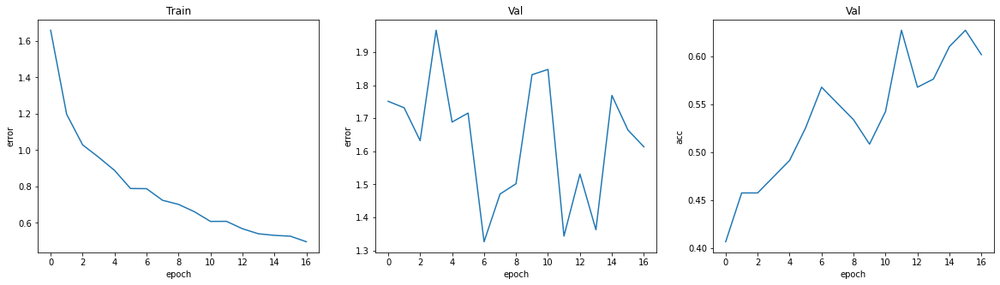

In [ ]:
plot_acc_error(errors_train,errors_val,acc_val)

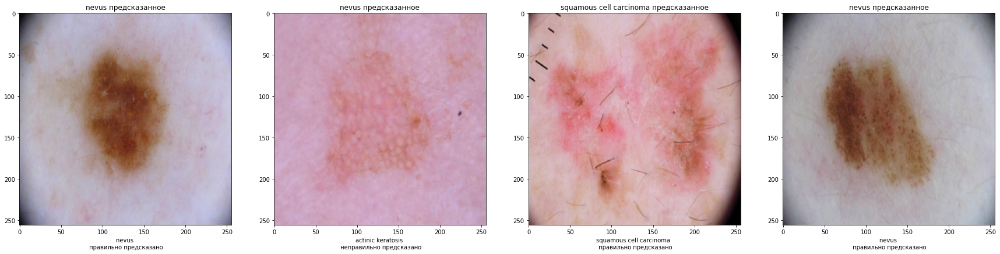

In [ ]:
show_images(test_data,classes,network=best_model) 

## Вывод

<h4>Как видно из результатов самые лучшие оценки получилось у EfficientNet_V2_L accuracy =0.68, macro avg = 0.63, weighted avg = 0.68, как видно результаты довольно неплохие. Несмотря на то что EfficientNet_V2_L имеет кооличество параметров во много раз меньше чем vgg16 и wide_resnet50_2, результаты vgg16 и wide_resnet50_2 хуже, могу предположить, что это из-за того что модель просто переобучается. Также дистилляция к сожалению не помогла</h4>

# Часть 2

<h4>Вторая задача включает в себя определение поражения родинки, задача сегментации</h4>

<h4>Dataset представляет собой train data: 2000 lesion images in JPEG format and 2000 corresponding superpixel masks in PNG format и validation data и тестовые данные</h4>

## Скачивем данные

In [ ]:
!wget https://isic-challenge-data.s3.amazonaws.com/2017/ISIC-2017_Training_Data.zip
!unzip ISIC-2017_Training_Data.zip

In [ ]:
!wget https://isic-challenge-data.s3.amazonaws.com/2017/ISIC-2017_Training_Part1_GroundTruth.zip
!unzip ISIC-2017_Training_Part1_GroundTruth.zip

In [ ]:
!wget https://isic-challenge-data.s3.amazonaws.com/2017/ISIC-2017_Validation_Data.zip
!unzip ISIC-2017_Validation_Data.zip

In [ ]:
!wget https://isic-challenge-data.s3.amazonaws.com/2017/ISIC-2017_Validation_Part1_GroundTruth.zip
!unzip ISIC-2017_Validation_Part1_GroundTruth.zip

In [ ]:
!wget https://isic-challenge-data.s3.amazonaws.com/2017/ISIC-2017_Test_v2_Data.zip
!unzip ISIC-2017_Test_v2_Data.zip

In [ ]:
!wget https://isic-challenge-data.s3.amazonaws.com/2017/ISIC-2017_Test_v2_Part1_GroundTruth.zip
!unzip ISIC-2017_Test_v2_Part1_GroundTruth.zip

## Подготовка данных

<h4>Удалил не нужные данные</h4>

In [ ]:
for address, dirs, files in os.walk('/content/ISIC-2017_Training_Data'):
    for f in files:
        if not f.endswith(".jpg"):
            os.remove(f"/content/ISIC-2017_Training_Data/{f}")

In [ ]:
for address, dirs, files in os.walk('/content/ISIC-2017_Validation_Data'):
    for f in files:
        if not f.endswith(".jpg"):
            os.remove(f"/content/ISIC-2017_Validation_Data/{f}")

In [ ]:
for address, dirs, files in os.walk('/content/ISIC-2017_Test_v2_Data'):
    for f in files:
        if not f.endswith(".jpg"):
            os.remove(f"/content/ISIC-2017_Test_v2_Data/{f}")

<h4>Выделил все уникальные путь, потому что walk files не структурированны</h4>

In [ ]:
all_path=[]
for address, dirs, files in os.walk('/content/ISIC-2017_Training_Data'):
    for f in files:
        all_path.append(f[5:12])

In [ ]:
len(all_path)

2000

In [ ]:
all_path_val=[]
for address, dirs, files in os.walk('/content/ISIC-2017_Validation_Data'):
    for f in files:
        all_path_val.append(f[5:12])

In [ ]:
len(all_path_val)

150

In [ ]:
all_path_test=[]
for address, dirs, files in os.walk('/content/ISIC-2017_Test_v2_Data'):
    for f in files:
        all_path_test.append(f[5:12])

In [ ]:
len(all_path_test)

600

<h4>Создание массивов</h4>

In [ ]:
load_transform=A.Compose([  
        A.Resize(256,256)
])

<h4>Картинки в очень высоком входном разрешении, после их скачки их необходимо преобразовать в разрешение 256x256 или colab просто вылетит</h4>

In [ ]:
images=[]
labels=[]
for path in tqdm(all_path):
    path_x=f"/content/ISIC-2017_Training_Data/ISIC_{path}.jpg"
    path_y=f"/content/ISIC-2017_Training_Part1_GroundTruth/ISIC_{path}_segmentation.png"
    img=imread(path_x)
    label=imread(path_y)
    transformed=load_transform(image=img,mask=label)

    images.append(transformed['image'])
    labels.append(transformed['mask'])

  0%|          | 0/2000 [00:00<?, ?it/s]

In [ ]:
len(images),len(labels)

(2000, 2000)

In [ ]:
images_val=[]
labels_val=[]
for path in tqdm(all_path_val):
    path_x=f"/content/ISIC-2017_Validation_Data/ISIC_{path}.jpg"
    path_y=f"/content/ISIC-2017_Validation_Part1_GroundTruth/ISIC_{path}_segmentation.png"
    img=imread(path_x)
    label=imread(path_y)
    transformed=load_transform(image=img,mask=label)

    images_val.append(transformed['image'])
    labels_val.append(transformed['mask'])

  0%|          | 0/150 [00:00<?, ?it/s]

In [ ]:
len(images_val),len(labels_val)

(150, 150)

In [ ]:
images_test=[]
labels_test=[]
for path in tqdm(all_path_test):
    path_x=f"/content/ISIC-2017_Test_v2_Data/ISIC_{path}.jpg"
    path_y=f"/content/ISIC-2017_Test_v2_Part1_GroundTruth/ISIC_{path}_segmentation.png"
    img=imread(path_x)
    label=imread(path_y)
    transformed=load_transform(image=img,mask=label)

    images_test.append(transformed['image'])
    labels_test.append(transformed['mask'])

  0%|          | 0/600 [00:00<?, ?it/s]

In [ ]:
len(images_test),len(labels_test)

(600, 600)

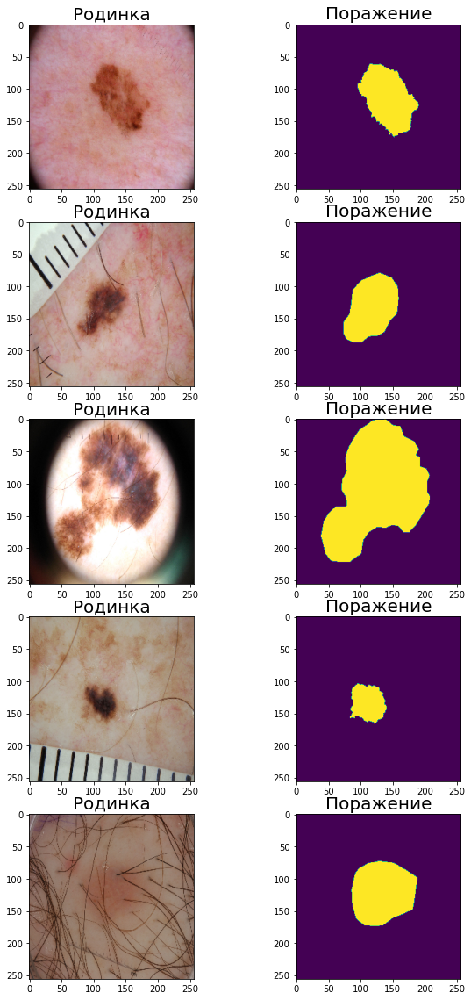

In [ ]:
plt.figure(figsize=(10,20))
num_img=5
for i in range(num_img):
    idx = randint(1, len(images))

    plt.subplot(num_img,2,i*2+1)
    plt.imshow(images[idx])
    plt.title('Родинка',fontsize=20)

    plt.subplot(num_img,2,i*2+2)
    plt.imshow(labels[idx])
    plt.title('Поражение',fontsize=20)

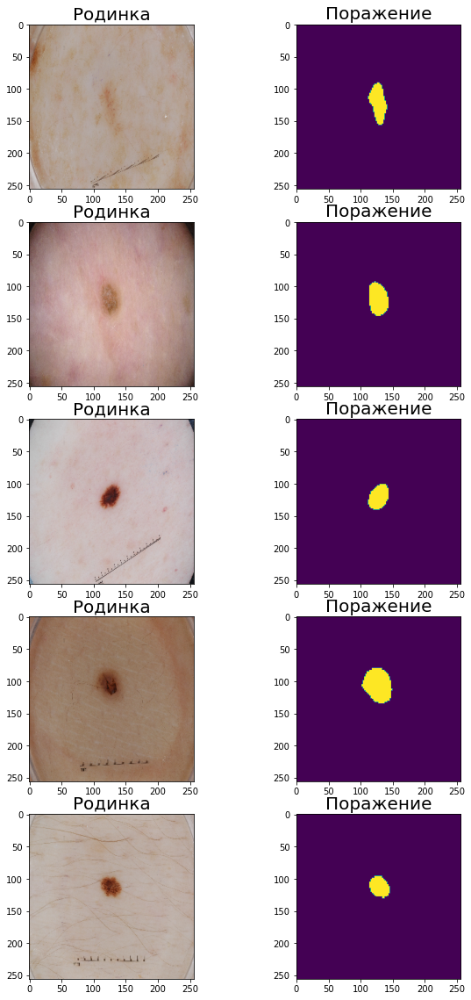

In [ ]:
plt.figure(figsize=(10,20))
num_img=5
for i in range(num_img):
    idx = randint(1, len(images_val))

    plt.subplot(num_img,2,i*2+1)
    plt.imshow(images_val[idx])
    plt.title('Родинка',fontsize=20)

    plt.subplot(num_img,2,i*2+2)
    plt.imshow(labels_val[idx])
    plt.title('Поражение',fontsize=20)

### Image Preprocessing

In [ ]:
images_np=np.array(images)
labels_np=[torch.tensor(label>1).byte().numpy() for label in labels] # преобразование в 0 1

In [ ]:
labels_np=np.array(labels_np,dtype='f')

In [ ]:
np.unique(labels_np[8])

array([0., 1.], dtype=float32)

In [ ]:
images_val_np=np.array(images_val)
labels_val_np=[torch.tensor(label_val>1).byte().numpy() for label_val in labels_val] # преобразование в 0 1

In [ ]:
labels_val_np=np.array(labels_val_np,dtype='f')

In [ ]:
np.unique(labels_val_np[8])

array([0., 1.], dtype=float32)

In [ ]:
images_test_np=np.array(images_test)
labels_test_np=[torch.tensor(label_test>1).byte().numpy() for label_test in labels_test] # преобразование в 0 1

In [ ]:
labels_test_np=np.array(labels_test_np,dtype='f')

In [ ]:
np.unique(labels_test_np[8])

array([0., 1.], dtype=float32)

### Dataset

In [ ]:
class CustomDataset(Dataset):
    def __init__(self,X_data,Y_data,transform=None):
        self.X_data=X_data
        self.Y_data=Y_data
        self.transform=transform

    def __getitem__(self, index):
        x=self.X_data[index]
        y=self.Y_data[index]
        
        if self.transform:
            transformed=self.transform(image=x,mask=y)
        return torch.tensor(np.transpose(transformed['image'],(2,0,1))),torch.tensor(transformed['mask'])

    def __len__(self):
        return len(self.X_data)

In [ ]:
train_data=CustomDataset(images_np,labels_np,transform_train)
val_data=CustomDataset(images_val_np,labels_val_np,transform_val)
test_data=CustomDataset(images_test_np,labels_test_np,transform_val)

In [ ]:
img_1,mask_1=train_data[8]

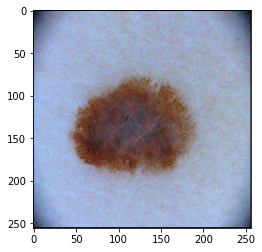

In [ ]:
tr=inv_transform(image=np.transpose(img_1.numpy(),(1,2,0)))
plt.imshow((tr["image"]*255).astype(np.uint8))

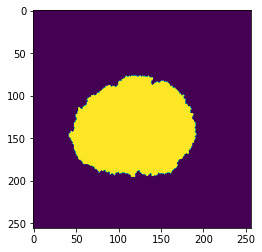

In [ ]:
plt.imshow(torch.squeeze(mask_1))

In [ ]:
img_1,mask_1=val_data[8]

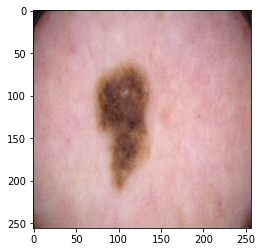

In [ ]:
tr=inv_transform(image=np.transpose(img_1.numpy(),(1,2,0)))
plt.imshow((tr["image"]*255).astype(np.uint8))

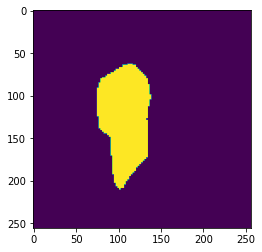

In [ ]:
plt.imshow(torch.squeeze(mask_1))

In [ ]:
img_1,mask_1=test_data[9]

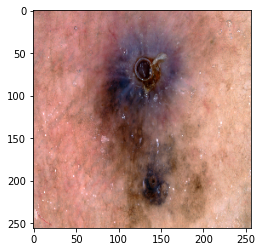

In [ ]:
tr=inv_transform(image=np.transpose(img_1.numpy(),(1,2,0)))
plt.imshow((tr["image"]*255).astype(np.uint8))

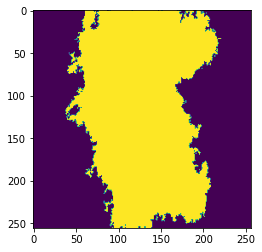

In [ ]:
plt.imshow(torch.squeeze(mask_1))

In [ ]:
train_loader=torch.utils.data.DataLoader(train_data,shuffle=True,batch_size=32,num_workers=2,pin_memory=True)
val_loader=torch.utils.data.DataLoader(val_data,shuffle=False,batch_size=32,num_workers=2,pin_memory=True)
test_loader=torch.utils.data.DataLoader(test_data,shuffle=False,batch_size=32,num_workers=2,pin_memory=True)

## Plot acc, error

<h4>Строит графики того как изменяется ошибка и точность на каждой эпохе</h4>

In [ ]:
def plot_acc_error(loss_error,IoU_score_1,errors_val,IoU_score_val_1):
  plt.figure(figsize=(20,10))

  plt.subplot(2,2,1)
  plt.plot(loss_error)
  plt.title("Train error")
  plt.xlabel("epoch")
  plt.ylabel("error")

  plt.subplot(2,2,2)
  plt.plot(IoU_score_1)
  plt.title("IoU train")
  plt.xlabel("epoch")
  plt.ylabel("error")

  plt.subplot(2,2,3)
  plt.plot(errors_val)
  plt.title("Val error")
  plt.xlabel("epoch")
  plt.ylabel("error")

  plt.subplot(2,2,4)
  plt.plot(IoU_score_val_1)
  plt.title("Val error")
  plt.xlabel("epoch")
  plt.ylabel("error")

## IoU

<h4>Intersection over union - метрика которая показывает качество модели, делит пересечение масок на их объединение.</h4>

In [ ]:
def IoU(mask_true,mask_pred,threshold):
    with torch.no_grad():
        mask_true=mask_true.to('cpu')
        mask_pred=mask_pred.to('cpu')

        if mask_true.dim()==2:
            mask_true=torch.unsqueeze(mask_true,0)
        if mask_pred.dim()==2:
            mask_pred=torch.unsqueeze(mask_pred,0)
        epsilon=1e-8

        mask_pred=mask_pred>threshold

        mask_pred=mask_pred.byte()
        mask_true=mask_true.byte()

        mask_union=(mask_pred|mask_true).float().sum((1,2))
        mask_intersaption=(mask_pred&mask_true).float().sum((1,2))

        iou=(mask_intersaption+epsilon)/(mask_union+epsilon)

    return iou

## Выбор порога

<h4>Эта функция строит графики IoU glass и IoU seal для разных порогов</h4>

In [ ]:
def plot_thresholds(IoU_score,thresholds):
    plt.figure(figsize=(10,5))

    plt.plot(thresholds,IoU_score)
    plt.xlabel("Thresholds")
    plt.xlabel("IoU score")

<h4>Порог нужно настраивать для того, чтобы IoU был максимальным</h4>

## config_threshold

<h4>Эта функция расчитывает для модели и данных на val IoU glass и IoU seal для разных порогов</h4>

In [ ]:
def config_threshold(network,val_loader,thresholds):
    network.eval()
    IoU_score_val=[]
    best_iou=0
    best_threshold=0
    for threshold in thresholds:
        with torch.no_grad():
            iou_metric_val=0
            for x_val,y_true in val_loader:
                x_val=x_val.cuda()    
                y_predicted=network(x_val.detach())

                y_predicted=y_predicted.cuda()
                y_true=y_true.cuda()
                y_true=torch.unsqueeze(y_true,1)

                iou_metric_val+=IoU(y_true.detach(),y_predicted.detach(),threshold).mean().item()

            IoU_score_val.append(iou_metric_val/len(val_loader))

            if best_iou<iou_metric_val/len(val_loader):
                best_iou=iou_metric_val/len(val_loader)
                best_threshold=threshold

    return IoU_score_val,best_threshold

## Predict test

In [ ]:
def predict_test(network,test_loader):
    network.eval()
    with torch.no_grad():
        for x_val in test_loader:
            x_val=x_val.cuda()    
            y_predicted=network(x_val.detach())

            y_predicted=y_predicted.detach()
    return y_predicted

## plot_mask

<h4>Функция отображает снимок, реальную маску и предсказанную</h4>

In [ ]:
def plot_mask(x_ray,mask_true,mask_predicted,threshold):
    plt.figure(figsize=(15,15))
    mask_predicted=mask_predicted.to('cpu')
    plt.subplot(1,3,1)

    tr=inv_transform(image=np.transpose(x_ray.numpy(),(1,2,0)))
    plt.imshow((tr["image"]*255).astype(np.uint8))

    # plt.imshow(np.transpose(x_ray,(1,2,0)))
    plt.title("Mole")

    plt.subplot(1,3,2)
    plt.imshow(mask_true)
    plt.title("True")

    plt.subplot(1,3,3)
    mask_predicted=mask_predicted>threshold
    mask_predicted=mask_predicted.byte()
    plt.imshow(mask_predicted)
    plt.title("Predicted")

## predict_mask

In [ ]:
from PIL import Image

In [ ]:
def predict_mask(network,img):
    network.eval()
    img=torch.unsqueeze(img,axis=0)
    img=img.cuda()
    mask_pred=network(img)

    return mask_pred

## Train function

<h4>train_net нужна для того чтобы тренировать мою сеть. В качестве аргументов она принимает сеть, train и val данные, скорость обучения количество эпох, название сети и т.д.<h4>

In [ ]:
def train_seg_net(network,train_loader,val_loader,learning_rate=0.001,epochs=3,loaded_optimizer=None,threshold=1,network_name=None):
    optimizer=None
    if loaded_optimizer:
      optimizer=loaded_optimizer
    else:
      optimizer=torch.optim.AdamW(network.parameters(),lr=learning_rate) # Optimizer
    
    loss_fn=torch.nn.BCEWithLogitsLoss() # Функция стоимости
    best_error=999
    iou_score=0
    errors=[]
    errors_val=[]
    IoU_score_1=[]
    IoU_score_val_1=[]

    network.train() # переводим сеть в состояние обучения
    
    for epoch in tqdm(range(epochs)):
        error=0
        iou_score=0
        for x_batch,y_batch in tqdm(train_loader):

            x_batch=x_batch.cuda() # передаем данные на куду
            y_batch=y_batch.cuda() 

            optimizer.zero_grad()

            y_pred=network(x_batch)

            y_batch=torch.unsqueeze(y_batch,1)

            loss=loss_fn(y_pred,y_batch)

            error+=loss.item()

            loss.backward()

            optimizer.step()

            iou_score+=IoU(y_batch.detach(),y_pred.detach(),threshold).mean().item()

        print(error/len(train_loader))
        errors.append(error/len(train_loader))
        IoU_score_1.append(iou_score/len(train_loader))

        print(f"Epoch = {epoch}")
        print(f"Train error = {error/len(train_loader)}, IoU = {iou_score/len(train_loader)}")
        
        network.eval() #переводим сеть в состояние оценивание: исключаем слои, которые используются только train
        with torch.no_grad(): # временно устанавливает флаги requires_grad=False
            error_val=0
            iou_metric_val=0
            for x_val,y_true in val_loader:
                x_val=x_val.cuda()    
                y_predicted=network(x_val.detach())

                y_predicted=y_predicted.cuda()
                y_true=y_true.cuda()
                y_true=torch.unsqueeze(y_true,1)

                loss_val=loss_fn(y_predicted.detach(),y_true.detach())
                error_val+=loss_val.item()

                iou_metric_val+=IoU(y_true.detach(),y_predicted.detach(),threshold).mean().item() # IoU на маске матовое стекло с порогом 1

            IoU_score_val_1.append(iou_metric_val/len(val_loader))
            errors_val.append(error_val/len(val_loader))
            print(f"Val error = {error_val/len(val_loader)}, IoU val= {iou_metric_val/len(val_loader)}")

            if best_error>error_val/len(val_loader):
                print(f'Save best model with val error {error_val/len(val_loader)}')
                state = {
                        'state_dict': network.state_dict(),
                        'optimizer' : optimizer.state_dict()}
                if network_name:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/{network_name}_best_model.pt") #Сохраняем наилучшую модель
                else:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/best_model.pt")
                best_error=error_val/len(val_loader)
            else:
                print(f"Don't save model. Val error is {error_val/len(val_loader)}")
            
        network.train()

    return network,errors,IoU_score_1,errors_val,IoU_score_val_1

## plot_mask_and_preds

In [ ]:
def plot_mask_and_preds(network,data,threshold):
    for i in range(5):
        idx = randint(1, len(data))

        img_1,mask_1=data[idx]

        mask_pred=predict_mask(network,img_1)

        iou_score=IoU(mask_1.detach(),mask_pred.detach(),threshold).mean().item()

        mask_pred=torch.squeeze(mask_pred)
        mask_1=torch.squeeze(mask_1)
        plt.figure(figsize=(15,15))
        mask_pred=mask_pred.to('cpu')
        plt.subplot(5,3,i*3+1)

        tr=inv_transform(image=np.transpose(img_1.numpy(),(1,2,0)))
        plt.imshow((tr["image"]*255).astype(np.uint8))

        plt.title("Mole")

        plt.subplot(5,3,i*3+2)
        plt.imshow(mask_1)
        plt.title("True")

        plt.subplot(5,3,i*3+3)
        mask_pred=mask_pred>threshold
        mask_pred=mask_pred.byte()
        plt.imshow(mask_pred)
        plt.title("Predicted")
        plt.xlabel(f"IoU score = {round(iou_score,4)}")

## Unet

### Encoder resnet18

<h4>В качестве encoder выбрана resnet18 глубиной 5 и с весами imagenet. Это маленькая модель, она имеет 11M весов.</h4>

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

194

In [ ]:
pretrained_model=smp.Unet(encoder_name="resnet18",encoder_depth=5,encoder_weights='imagenet',
                          decoder_channels=(256, 128, 64, 32, 16),decoder_use_batchnorm=True,
                          in_channels=3,classes=1,activation=None
                          ).cuda()

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

#### Обучение

In [ ]:
final_net,errors,IoU_score_1,errors_val,IoU_score_val_1=train_seg_net(pretrained_model,train_loader,val_loader,epochs=10,threshold=0.5,network_name="UnetResNet18")

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

0.2245681324885005
Epoch = 0
Train error = 0.2245681324885005, IoU = 0.7540242231436192
Val error = 0.20837849527597427, IoU val= 0.7994085907936096
Save best model with val error 0.20837849527597427


  0%|          | 0/63 [00:00<?, ?it/s]

0.1395308803471308
Epoch = 1
Train error = 0.1395308803471308, IoU = 0.8332536561148507
Val error = 0.16520317047834396, IoU val= 0.8459583163261414
Save best model with val error 0.16520317047834396


  0%|          | 0/63 [00:00<?, ?it/s]

0.1219431281326309
Epoch = 2
Train error = 0.1219431281326309, IoU = 0.8467433376917763
Val error = 0.17622990757226945, IoU val= 0.8199095845222473
Don't save model. Val error is 0.17622990757226945


  0%|          | 0/63 [00:00<?, ?it/s]

0.11921644530126027
Epoch = 3
Train error = 0.11921644530126027, IoU = 0.848461527673025
Val error = 0.2051479071378708, IoU val= 0.832358980178833
Don't save model. Val error is 0.2051479071378708


  0%|          | 0/63 [00:00<?, ?it/s]

0.11338836167539869
Epoch = 4
Train error = 0.11338836167539869, IoU = 0.8540848663875035
Val error = 0.17229464054107665, IoU val= 0.8504320502281189
Don't save model. Val error is 0.17229464054107665


  0%|          | 0/63 [00:00<?, ?it/s]

0.1092476388883023
Epoch = 5
Train error = 0.1092476388883023, IoU = 0.8563589974055215
Val error = 0.17045210301876068, IoU val= 0.8599910974502564
Don't save model. Val error is 0.17045210301876068


  0%|          | 0/63 [00:00<?, ?it/s]

0.10995876114992868
Epoch = 6
Train error = 0.10995876114992868, IoU = 0.8548378102363102
Val error = 0.1636068657040596, IoU val= 0.8543485045433045
Save best model with val error 0.1636068657040596


  0%|          | 0/63 [00:00<?, ?it/s]

0.10025179114133592
Epoch = 7
Train error = 0.10025179114133592, IoU = 0.864297316187904
Val error = 0.14934964925050737, IoU val= 0.8605160355567932
Save best model with val error 0.14934964925050737


  0%|          | 0/63 [00:00<?, ?it/s]

0.10680122295069316
Epoch = 8
Train error = 0.10680122295069316, IoU = 0.8579657030484032
Val error = 0.12671724259853362, IoU val= 0.8668522238731384
Save best model with val error 0.12671724259853362


  0%|          | 0/63 [00:00<?, ?it/s]

0.10235023297487743
Epoch = 9
Train error = 0.10235023297487743, IoU = 0.8615840853206695
Val error = 0.1466466471552849, IoU val= 0.8589569687843323
Don't save model. Val error is 0.1466466471552849


#### Результаты модели

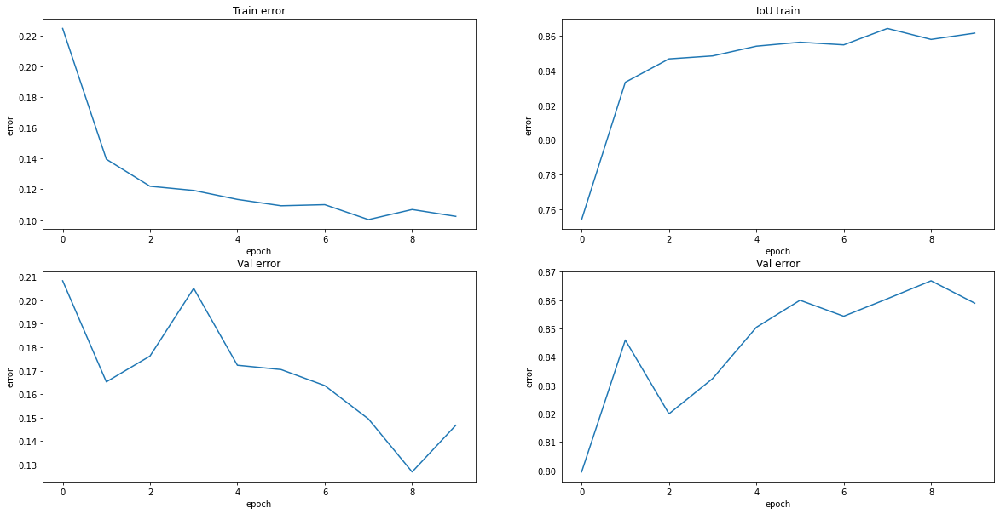

In [ ]:
plot_acc_error(errors,IoU_score_1,errors_val,IoU_score_val_1)

<h4>Как видно из результатов, ошибка на train и val падает, IoU на train и val увеличивается.</h4>

#### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/UnetResNet18_best_model.pt")
best_seg_model=smp.Unet(encoder_name="resnet18",encoder_depth=5,encoder_weights='imagenet',
                          decoder_channels=(256, 128, 64, 32, 16),decoder_use_batchnorm=True,
                          in_channels=3,classes=1,activation=None
                          ).cuda()
best_seg_model.load_state_dict(state['state_dict'])

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

<All keys matched successfully>

#### Выбор порога

In [ ]:
thresholds=np.arange(-1,3,0.1)

In [ ]:
IoU_score,best_threshold=config_threshold(best_seg_model,test_loader,thresholds)

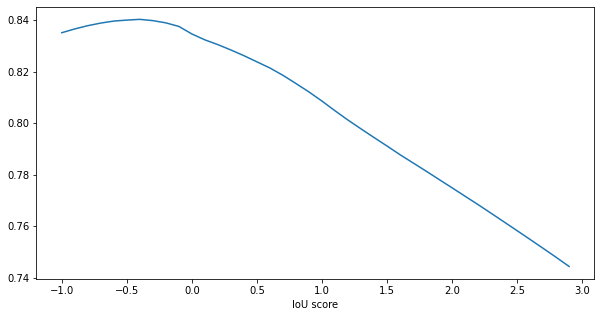

In [ ]:
plot_thresholds(IoU_score,thresholds)

In [ ]:
round(best_threshold,3)

-0.4

<h4>Лучшая IoU достигается при пороге -0.4 и IoU = 0.84</h4>

#### Plot mole with mask

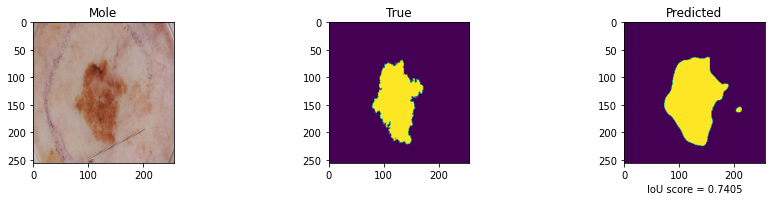

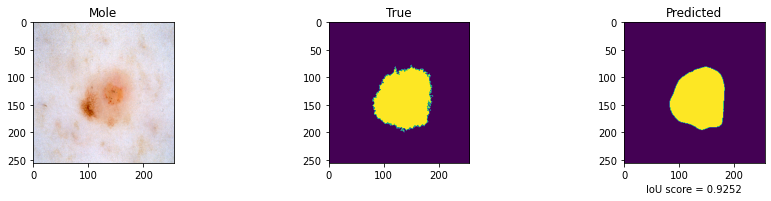

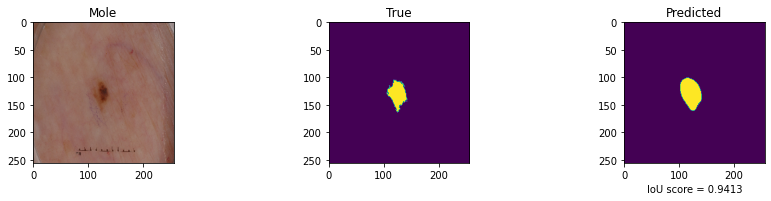

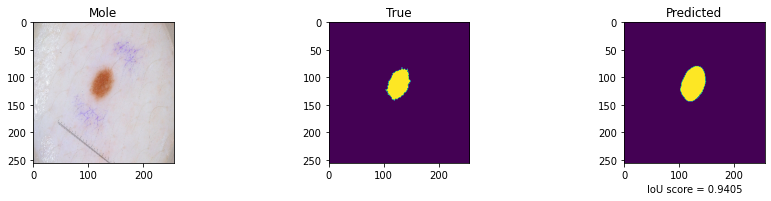

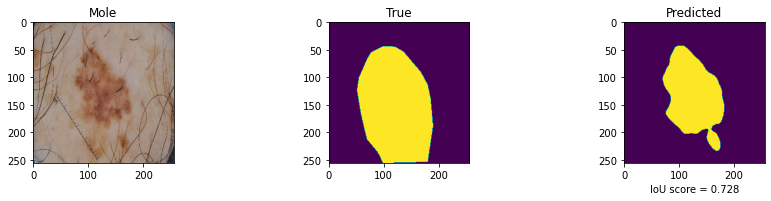

In [ ]:
plot_mask_and_preds(best_seg_model,test_data,-0.4)

<h4>Можно увидеть из результатов, что сегментация хорошая</h4>

### Encoder resnet101

<h4>В качестве encoder выбрана resnet101 глубиной 5 и с весами imagenet. Это достаточно большая модель, она имеет 42M весов в будущем она будет использоваться, как модель учитель при дистиляции</h4>

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

62127

In [ ]:
pretrained_model=smp.Unet(encoder_name="resnet101",encoder_depth=5,encoder_weights='imagenet',
                          decoder_channels=(256, 128, 64, 32, 16),decoder_use_batchnorm=True,
                          in_channels=3,classes=1,activation=None
                          ).cuda()

Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to /root/.cache/torch/hub/checkpoints/resnet101-5d3b4d8f.pth


  0%|          | 0.00/170M [00:00<?, ?B/s]

#### Обучение

In [ ]:
final_net,errors,IoU_score_1,errors_val,IoU_score_val_1=train_seg_net(pretrained_model,train_loader,val_loader,epochs=10,threshold=0.5,network_name="UnetResNet101")

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

0.25157959735582747
Epoch = 0
Train error = 0.25157959735582747, IoU = 0.7397873210055488
Val error = 0.25334743559360506, IoU val= 0.7644801020622254
Save best model with val error 0.25334743559360506


  0%|          | 0/63 [00:00<?, ?it/s]

0.15773265430378536
Epoch = 1
Train error = 0.15773265430378536, IoU = 0.8131990612499298
Val error = 0.18637623488903046, IoU val= 0.8152175903320312
Save best model with val error 0.18637623488903046


  0%|          | 0/63 [00:00<?, ?it/s]

0.14047642643489536
Epoch = 2
Train error = 0.14047642643489536, IoU = 0.8266418169415186
Val error = 0.17842218279838562, IoU val= 0.829259717464447
Save best model with val error 0.17842218279838562


  0%|          | 0/63 [00:00<?, ?it/s]

0.14075773623254564
Epoch = 3
Train error = 0.14075773623254564, IoU = 0.8249797575057499
Val error = 0.19799629002809524, IoU val= 0.8328664422035217
Don't save model. Val error is 0.19799629002809524


  0%|          | 0/63 [00:00<?, ?it/s]

0.12651014375308203
Epoch = 4
Train error = 0.12651014375308203, IoU = 0.836964173922463
Val error = 0.1614271178841591, IoU val= 0.8533403635025024
Save best model with val error 0.1614271178841591


  0%|          | 0/63 [00:00<?, ?it/s]

0.1238315740511531
Epoch = 5
Train error = 0.1238315740511531, IoU = 0.8437563540443541
Val error = 0.14350369721651077, IoU val= 0.8474474787712097
Save best model with val error 0.14350369721651077


  0%|          | 0/63 [00:00<?, ?it/s]

0.11958232533837122
Epoch = 6
Train error = 0.11958232533837122, IoU = 0.8494318108710032
Val error = 0.15786978751420974, IoU val= 0.8377451300621033
Don't save model. Val error is 0.15786978751420974


  0%|          | 0/63 [00:00<?, ?it/s]

0.11607817761481755
Epoch = 7
Train error = 0.11607817761481755, IoU = 0.8499666594323658
Val error = 0.15943962782621385, IoU val= 0.8436686754226684
Don't save model. Val error is 0.15943962782621385


  0%|          | 0/63 [00:00<?, ?it/s]

0.1202838115748905
Epoch = 8
Train error = 0.1202838115748905, IoU = 0.847723540805635
Val error = 0.1568594753742218, IoU val= 0.8426281929016113
Don't save model. Val error is 0.1568594753742218


  0%|          | 0/63 [00:00<?, ?it/s]

0.11512963733975849
Epoch = 9
Train error = 0.11512963733975849, IoU = 0.8500506849516005
Val error = 0.18704178929328918, IoU val= 0.8364732146263123
Don't save model. Val error is 0.18704178929328918


#### Результаты модели

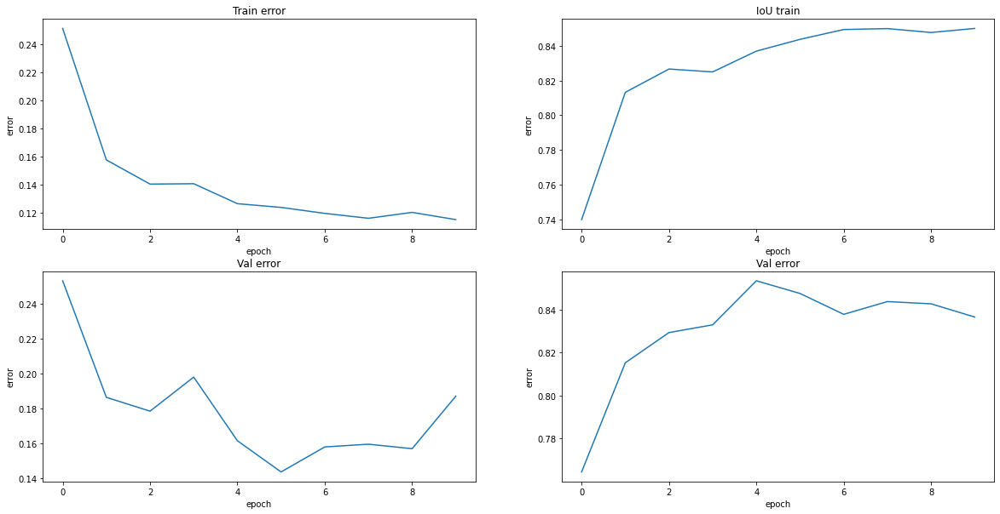

In [ ]:
plot_acc_error(errors,IoU_score_1,errors_val,IoU_score_val_1)

<h4>Как видно из результатов, ошибка на train и val падает, IoU на train и val увеличивается.</h4>

#### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/UnetResNet101_best_model.pt")
best_seg_model=smp.Unet(encoder_name="resnet101",encoder_depth=5,encoder_weights='imagenet',
                          decoder_channels=(256, 128, 64, 32, 16),decoder_use_batchnorm=True,
                          in_channels=3,classes=1,activation=None
                          ).cuda()
best_seg_model.load_state_dict(state['state_dict'])

<All keys matched successfully>

#### Выбор порога

In [ ]:
thresholds=np.arange(-1,3,0.1)

In [ ]:
IoU_score,best_threshold=config_threshold(best_seg_model,test_loader,thresholds)

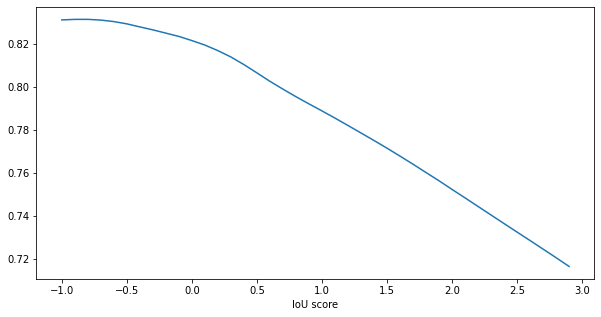

In [ ]:
plot_thresholds(IoU_score,thresholds)

In [ ]:
round(best_threshold,3)

-0.8

<h4>Лучшая  IoU при пороге -0.8 IoU = 0.835</h4>

#### Plot mole with mask

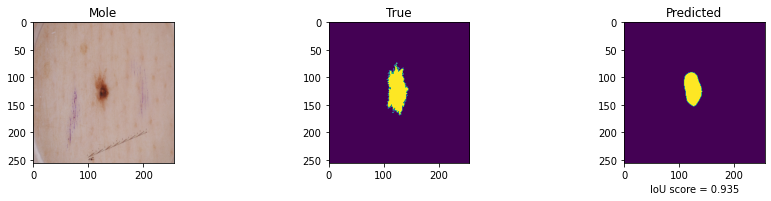

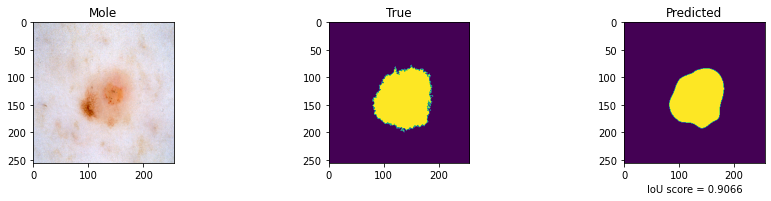

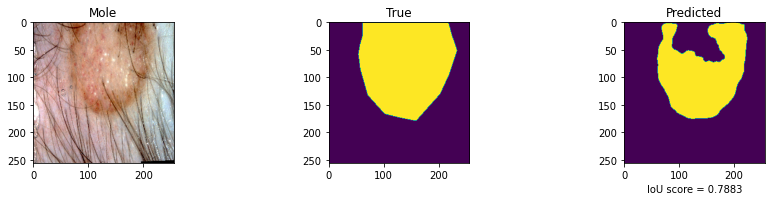

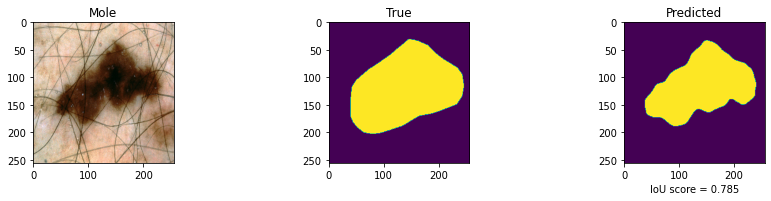

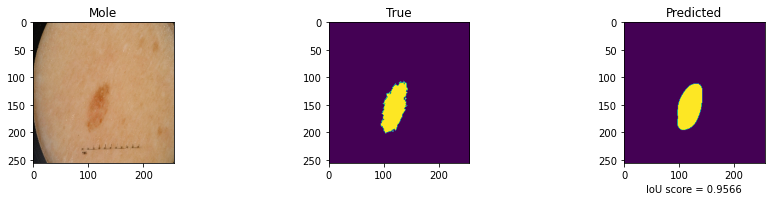

In [ ]:
plot_mask_and_preds(best_seg_model,test_data,best_threshold)

<h4>Можно увидеть из результатов, что сегментация хорошая</h4>

## LinkNet

### Architecture

<h4>Архитектура модели</h4>

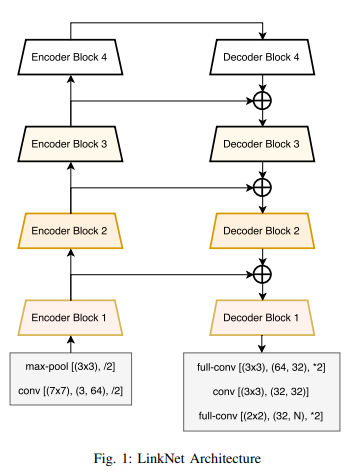

<h4>Архитектура encoder</h4>

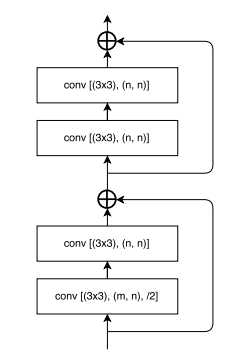

<h4>Архитектура decoder</h4>

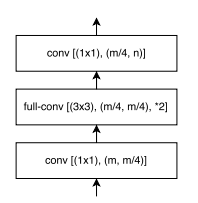

<h4>Как написано в статье, эта модель маленькая, имеет 11М параметров. Идея была такая, создать маленькую модель, которая по точности не уступала бы моделям с огромным числом параметров, и в будущем для использования ее в продакшене</h4>

### Создание и обучение модели

<h4>ImageNet Pretrained resnet34</h4>

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

219

In [ ]:
pretrained_model=smp.Linknet(encoder_name="resnet34",encoder_weights='imagenet',
                          in_channels=3,classes=1,activation=None,
                          decoder_use_batchnorm=True
                          ).cuda()

In [ ]:
final_net,errors,IoU_score_1,errors_val,IoU_score_val_1=train_seg_net(pretrained_model,train_loader,val_loader,epochs=10,threshold=0.5,network_name="LinkNet34")

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

0.44449029366175336
Epoch = 0
Train error = 0.44449029366175336, IoU = 0.6958730366258394
Val error = 0.3099722981452942, IoU val= 0.7978264093399048
Save best model with val error 0.3099722981452942


  0%|          | 0/63 [00:00<?, ?it/s]

0.22048776348431906
Epoch = 1
Train error = 0.22048776348431906, IoU = 0.822475516606891
Val error = 0.21547022759914397, IoU val= 0.8219444155693054
Save best model with val error 0.21547022759914397


  0%|          | 0/63 [00:00<?, ?it/s]

0.15949571132659912
Epoch = 2
Train error = 0.15949571132659912, IoU = 0.8345369233025445
Val error = 0.19778053015470504, IoU val= 0.8380210399627686
Save best model with val error 0.19778053015470504


  0%|          | 0/63 [00:00<?, ?it/s]

0.142705133273488
Epoch = 3
Train error = 0.142705133273488, IoU = 0.8392524113730778
Val error = 0.1845486119389534, IoU val= 0.8256611227989197
Save best model with val error 0.1845486119389534


  0%|          | 0/63 [00:00<?, ?it/s]

0.12936599659068243
Epoch = 4
Train error = 0.12936599659068243, IoU = 0.8514655402728489
Val error = 0.220638307929039, IoU val= 0.8280354261398315
Don't save model. Val error is 0.220638307929039


  0%|          | 0/63 [00:00<?, ?it/s]

0.12099685567238974
Epoch = 5
Train error = 0.12099685567238974, IoU = 0.8508850260386391
Val error = 0.1383773148059845, IoU val= 0.8596364378929138
Save best model with val error 0.1383773148059845


  0%|          | 0/63 [00:00<?, ?it/s]

0.11186832148167822
Epoch = 6
Train error = 0.11186832148167822, IoU = 0.856679692154839
Val error = 0.17265134304761887, IoU val= 0.8326013088226318
Don't save model. Val error is 0.17265134304761887


  0%|          | 0/63 [00:00<?, ?it/s]

0.10949032434395381
Epoch = 7
Train error = 0.10949032434395381, IoU = 0.8578711719740004
Val error = 0.1841095745563507, IoU val= 0.8395918369293213
Don't save model. Val error is 0.1841095745563507


  0%|          | 0/63 [00:00<?, ?it/s]

0.1047393891309935
Epoch = 8
Train error = 0.1047393891309935, IoU = 0.86252147337747
Val error = 0.15400349721312523, IoU val= 0.8529372334480285
Don't save model. Val error is 0.15400349721312523


  0%|          | 0/63 [00:00<?, ?it/s]

0.10167090600681683
Epoch = 9
Train error = 0.10167090600681683, IoU = 0.863059005093953
Val error = 0.1504358172416687, IoU val= 0.8607970356941224
Don't save model. Val error is 0.1504358172416687


### Результаты модели

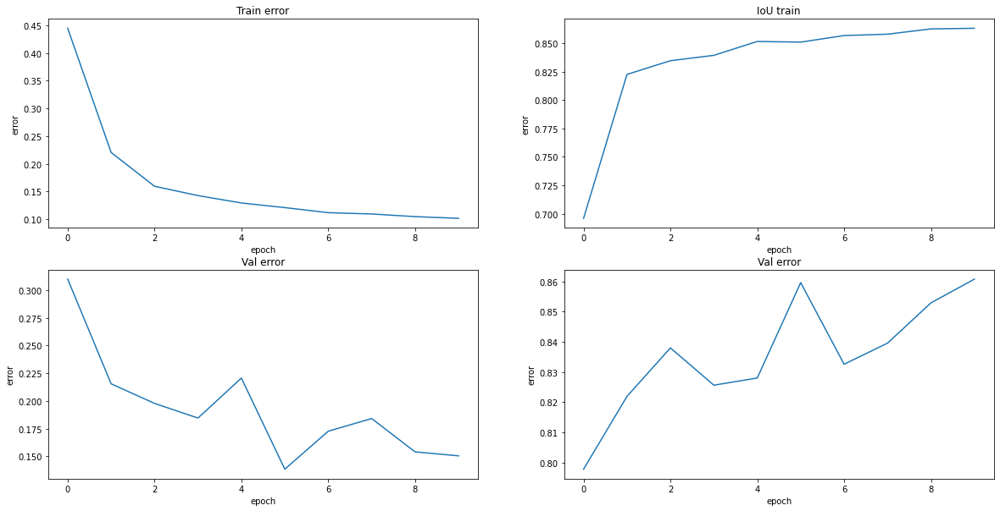

In [ ]:
plot_acc_error(errors,IoU_score_1,errors_val,IoU_score_val_1)

<h4>Как видно из результатов, ошибка на train и val падает, IoU на train и val увеличивается.</h4>

### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/LinkNet34_best_model.pt")
best_seg_model=smp.Linknet(encoder_name="resnet34",encoder_weights='imagenet',
                          in_channels=3,classes=1,activation=None,
                          decoder_use_batchnorm=True
                          ).cuda()
best_seg_model.load_state_dict(state['state_dict'])

<All keys matched successfully>

### Выбор порога

In [ ]:
thresholds=np.arange(-1,3,0.1)

In [ ]:
IoU_score,best_threshold=config_threshold(best_seg_model,test_loader,thresholds)

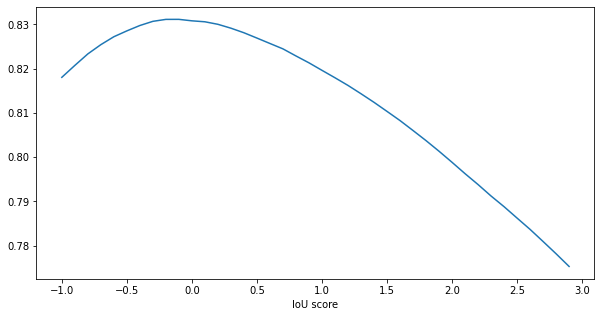

In [ ]:
plot_thresholds(IoU_score,thresholds)

In [ ]:
round(best_threshold,3)

-0.1

<h4>Лучший IoU при пороге -0.1, IoU = 0.83</h4>

### Plot mole with mask

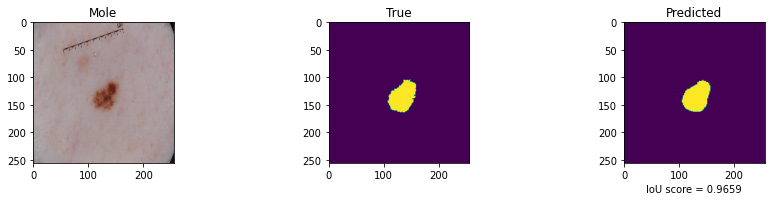

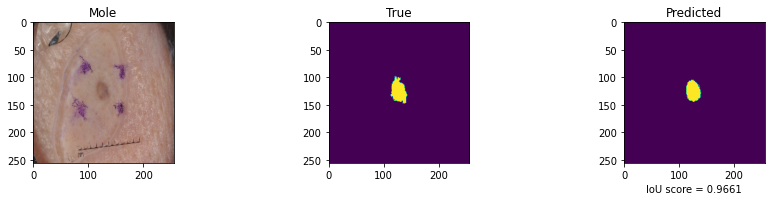

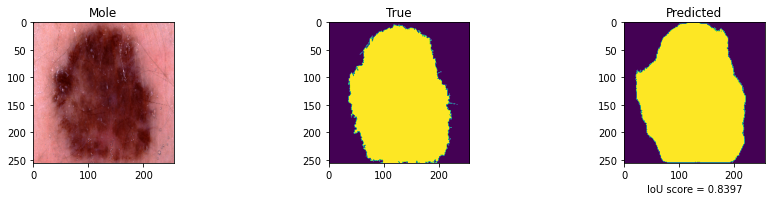

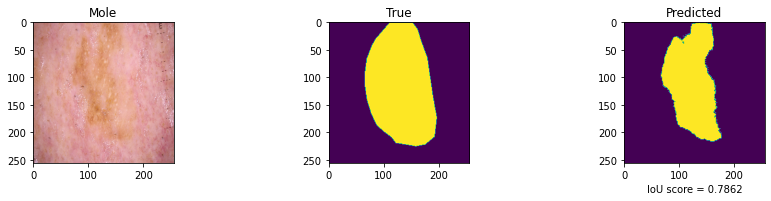

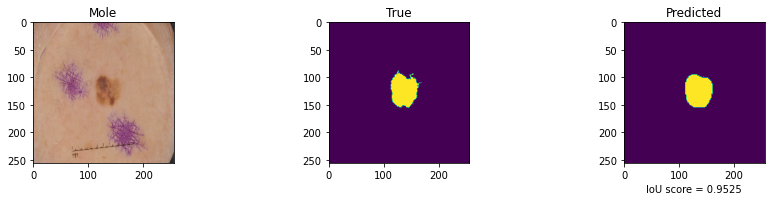

In [ ]:
plot_mask_and_preds(best_seg_model,test_data,best_threshold)

<h4>Можно увидеть из результатов, что сегментация хорошая</h4>

## PSPNet

### Architecture

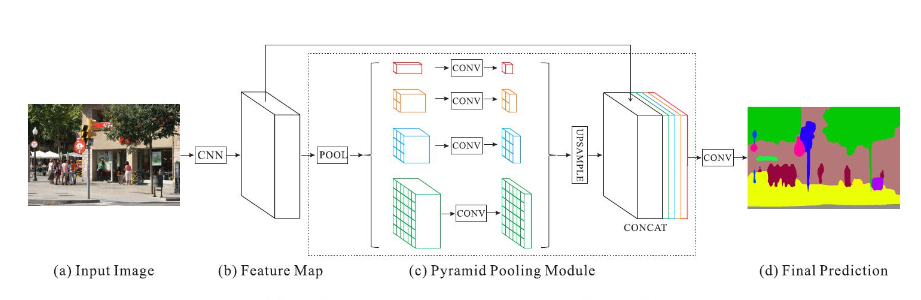

### Создание и обучение модели

<h4>ImageNet Pretrained resnet101</h4>

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

31252

In [ ]:
pretrained_model=smp.PSPNet(encoder_name="resnet101",encoder_weights='imagenet',
                          encoder_depth=3,psp_out_channels=512,
                          in_channels=3,classes=1,activation=None,
                          psp_use_batchnorm=True
                          ).cuda()

In [ ]:
final_net,errors,IoU_score_1,errors_val,IoU_score_val_1=train_seg_net(pretrained_model,train_loader,val_loader,epochs=10,threshold=0.5,network_name="PSPNet101")

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

0.21748282795860654
Epoch = 0
Train error = 0.21748282795860654, IoU = 0.7617818183369107
Val error = 0.16964096277952195, IoU val= 0.8235561966896057
Save best model with val error 0.16964096277952195


  0%|          | 0/63 [00:00<?, ?it/s]

0.15305184632066696
Epoch = 1
Train error = 0.15305184632066696, IoU = 0.816167550427573
Val error = 0.15582001209259033, IoU val= 0.8323339104652405
Save best model with val error 0.15582001209259033


  0%|          | 0/63 [00:00<?, ?it/s]

0.13266568146054708
Epoch = 2
Train error = 0.13266568146054708, IoU = 0.8358767751663451
Val error = 0.13788540810346603, IoU val= 0.8466405510902405
Save best model with val error 0.13788540810346603


  0%|          | 0/63 [00:00<?, ?it/s]

0.1279629608468404
Epoch = 3
Train error = 0.1279629608468404, IoU = 0.8408336232578943
Val error = 0.19273802191019057, IoU val= 0.8298915266990662
Don't save model. Val error is 0.19273802191019057


  0%|          | 0/63 [00:00<?, ?it/s]

0.12266693276072306
Epoch = 4
Train error = 0.12266693276072306, IoU = 0.842598107126024
Val error = 0.15470921397209167, IoU val= 0.8340900659561157
Don't save model. Val error is 0.15470921397209167


  0%|          | 0/63 [00:00<?, ?it/s]

0.11362435444006844
Epoch = 5
Train error = 0.11362435444006844, IoU = 0.852428880948869
Val error = 0.19809735268354417, IoU val= 0.838081955909729
Don't save model. Val error is 0.19809735268354417


  0%|          | 0/63 [00:00<?, ?it/s]

0.11928758640137929
Epoch = 6
Train error = 0.11928758640137929, IoU = 0.8489396505885654
Val error = 0.1373612716794014, IoU val= 0.8452440142631531
Save best model with val error 0.1373612716794014


  0%|          | 0/63 [00:00<?, ?it/s]

0.11182095713558651
Epoch = 7
Train error = 0.11182095713558651, IoU = 0.8554056353039212
Val error = 0.1463746353983879, IoU val= 0.8519366979598999
Don't save model. Val error is 0.1463746353983879


  0%|          | 0/63 [00:00<?, ?it/s]

0.1096093709033633
Epoch = 8
Train error = 0.1096093709033633, IoU = 0.8561362624168396
Val error = 0.13606686890125275, IoU val= 0.8584437966346741
Save best model with val error 0.13606686890125275


  0%|          | 0/63 [00:00<?, ?it/s]

0.10312742893657988
Epoch = 9
Train error = 0.10312742893657988, IoU = 0.8616305059856839
Val error = 0.17881264835596083, IoU val= 0.8485334873199463
Don't save model. Val error is 0.17881264835596083


### Результаты модели

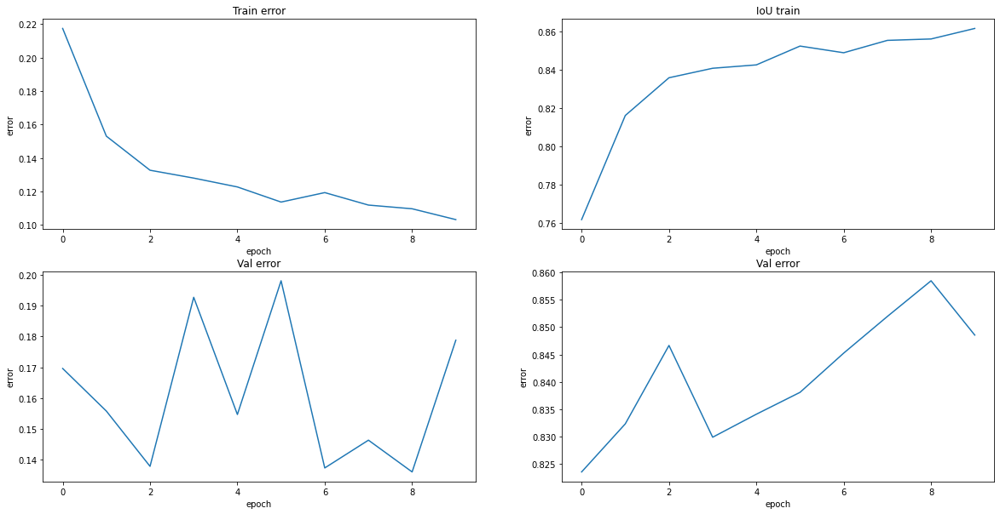

In [ ]:
plot_acc_error(errors,IoU_score_1,errors_val,IoU_score_val_1)

<h4>Как видно из результатов, ошибка на train падает на val что-то странное, IoU на train и val увеличивается.</h4>

### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/PSPNet101_best_model.pt")
best_seg_model=smp.PSPNet(encoder_name="resnet101",encoder_weights='imagenet',
                          encoder_depth=3,psp_out_channels=512,
                          in_channels=3,classes=1,activation=None,
                          psp_use_batchnorm=True
                          ).cuda()
best_seg_model.load_state_dict(state['state_dict'])

<All keys matched successfully>

### Выбор порога

In [ ]:
thresholds=np.arange(-1,3,0.1)

In [ ]:
IoU_score,best_threshold=config_threshold(best_seg_model,test_loader,thresholds)

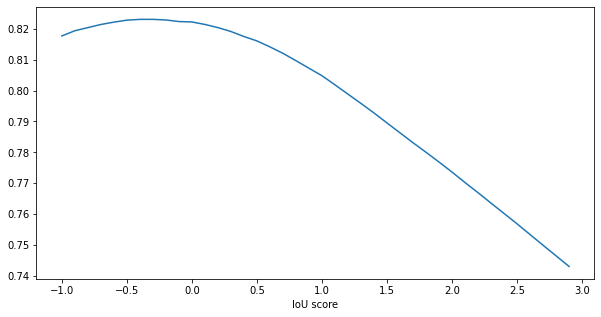

In [ ]:
plot_thresholds(IoU_score,thresholds)

In [ ]:
round(best_threshold,3)

-0.3

<h4>Лучший IoU при пороге -0.3, IoU равен 0.82</h4>

### Plot mole with mask

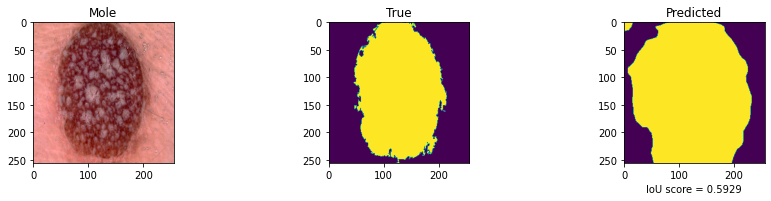

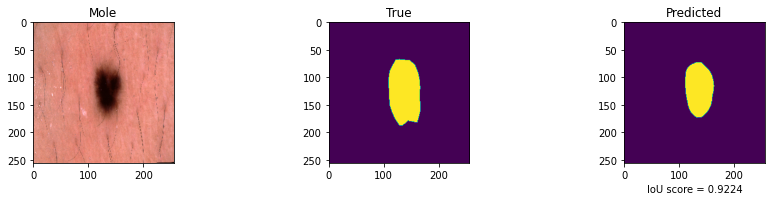

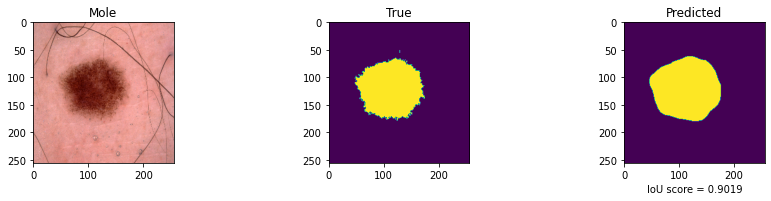

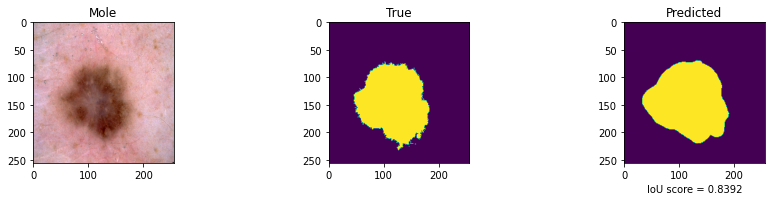

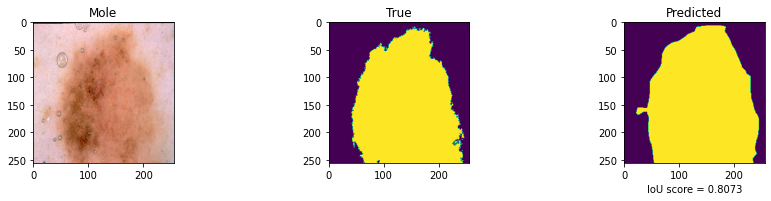

In [ ]:
plot_mask_and_preds(best_seg_model,test_data,best_threshold)

<h4>Можно увидеть из результатов, что сегментация хорошая</h4>

## PAN

### Architecture

<h4>Network Architecture
</h4>

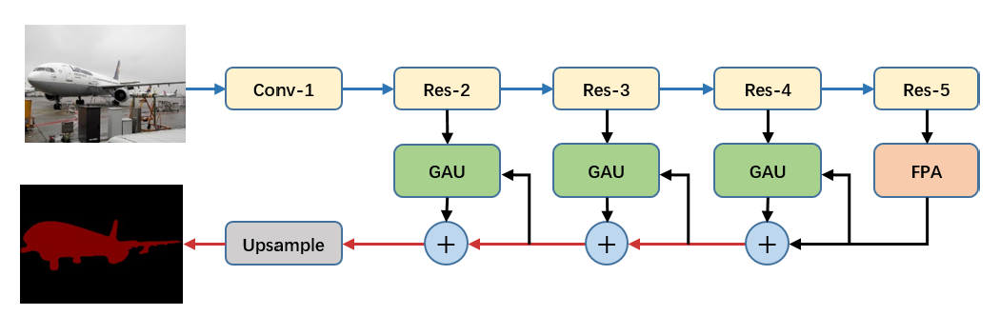

 <h4>Feature Pyramid Attention (FPA) Module</h4>

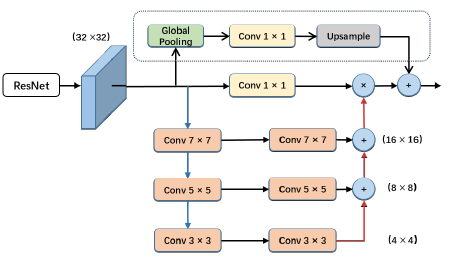

<h4>Feature Pyramid Attention (FPA) представлен для создания пространственной пирамидальной структуры внимания на высокоуровневых выходных данных и объединения global pooling для изучения лучшего представления функций.</h4>

<h4>Global Attention Upsample (GAU) Module</h4>


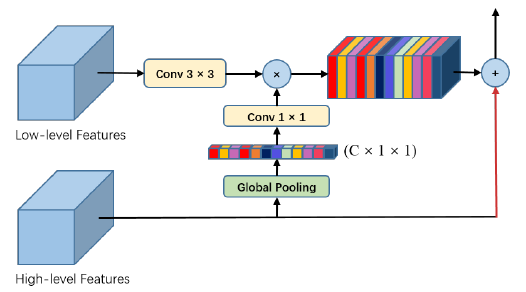

<h4>Модуль Global Attention Upsample (GAU) представлен на каждом уровне декодера, чтобы предоставить глобальный контекст в качестве руководства по низкоуровневым функциям для выбора деталей локализации категории.</h4>

### Создание и обучение модели

<h4>ImageNet Pretrained ResNet-101, with dilated convolution, is used as baseline</h4>

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

31224

In [ ]:
pretrained_model=smp.PAN(encoder_name="resnet101",encoder_weights='imagenet',
                          decoder_channels=32,in_channels=3,classes=1,activation=None
                          ).cuda()

In [ ]:
final_net,errors,IoU_score_1,errors_val,IoU_score_val_1=train_seg_net(pretrained_model,train_loader,val_loader,epochs=10,threshold=0.5,network_name="PANNet101")

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

0.22380455027497004
Epoch = 0
Train error = 0.22380455027497004, IoU = 0.7687184235879353
Val error = 0.19962063580751419, IoU val= 0.8064802169799805
Save best model with val error 0.19962063580751419


  0%|          | 0/63 [00:00<?, ?it/s]

0.14703903749348626
Epoch = 1
Train error = 0.14703903749348626, IoU = 0.8237648833365667
Val error = 0.1476704880595207, IoU val= 0.8375597357749939
Save best model with val error 0.1476704880595207


  0%|          | 0/63 [00:00<?, ?it/s]

0.11474896577142533
Epoch = 2
Train error = 0.11474896577142533, IoU = 0.8511618073024447
Val error = 0.22397356182336808, IoU val= 0.8141118168830872
Don't save model. Val error is 0.22397356182336808


  0%|          | 0/63 [00:00<?, ?it/s]

0.110108292410298
Epoch = 3
Train error = 0.110108292410298, IoU = 0.8565508959785341
Val error = 0.18767450898885726, IoU val= 0.8379613399505615
Don't save model. Val error is 0.18767450898885726


  0%|          | 0/63 [00:00<?, ?it/s]

0.10973267742092647
Epoch = 4
Train error = 0.10973267742092647, IoU = 0.8558493332257346
Val error = 0.15328251272439958, IoU val= 0.8489103078842163
Don't save model. Val error is 0.15328251272439958


  0%|          | 0/63 [00:00<?, ?it/s]

0.10492047360019079
Epoch = 5
Train error = 0.10492047360019079, IoU = 0.8611212136253478
Val error = 0.16028864681720734, IoU val= 0.8408710956573486
Don't save model. Val error is 0.16028864681720734


  0%|          | 0/63 [00:00<?, ?it/s]

0.1050576785845416
Epoch = 6
Train error = 0.1050576785845416, IoU = 0.8618707817698282
Val error = 0.1315827563405037, IoU val= 0.8629798769950867
Save best model with val error 0.1315827563405037


  0%|          | 0/63 [00:00<?, ?it/s]

0.10028428678947782
Epoch = 7
Train error = 0.10028428678947782, IoU = 0.8657269685987442
Val error = 0.15093925595283508, IoU val= 0.8614732027053833
Don't save model. Val error is 0.15093925595283508


  0%|          | 0/63 [00:00<?, ?it/s]

0.09607742667671233
Epoch = 8
Train error = 0.09607742667671233, IoU = 0.8696313651781233
Val error = 0.14452620595693588, IoU val= 0.8565972328186036
Don't save model. Val error is 0.14452620595693588


  0%|          | 0/63 [00:00<?, ?it/s]

0.09495600691390416
Epoch = 9
Train error = 0.09495600691390416, IoU = 0.8708477833914379
Val error = 0.13235390409827233, IoU val= 0.867650830745697
Don't save model. Val error is 0.13235390409827233


### Результаты модели

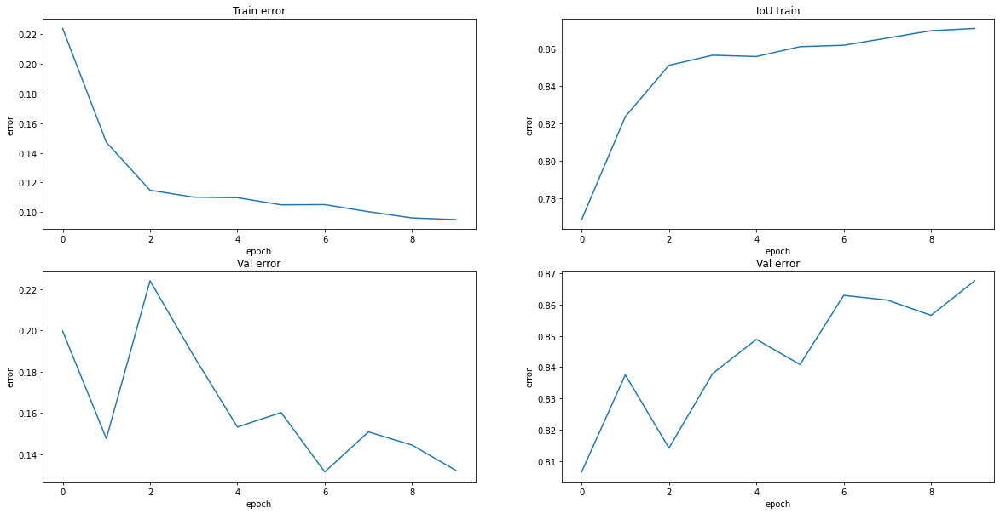

In [ ]:
plot_acc_error(errors,IoU_score_1,errors_val,IoU_score_val_1)

<h4>Как видно из результатов, ошибка на train и val падает, IoU на train и val увеличивается.</h4>

### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/PANNet101_best_model.pt")
best_seg_model=smp.PAN(encoder_name="resnet101",encoder_weights='imagenet',
                          decoder_channels=32,in_channels=3,classes=1,activation=None
                          ).cuda()
best_seg_model.load_state_dict(state['state_dict'])

<All keys matched successfully>

### Выбор порога

In [ ]:
thresholds=np.arange(-1,3,0.1)

In [ ]:
IoU_score,best_threshold=config_threshold(best_seg_model,test_loader,thresholds)

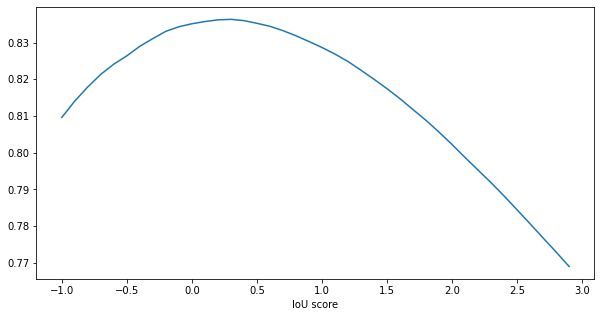

In [ ]:
plot_thresholds(IoU_score,thresholds)

In [ ]:
round(best_threshold,3)

0.3

<h4>Лучший IoU при пороге 0.3, IoU = 0.84</h4>

### Plot mole with mask

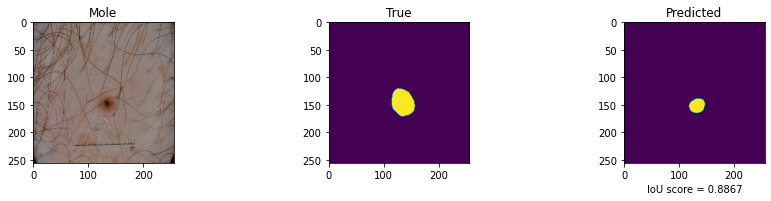

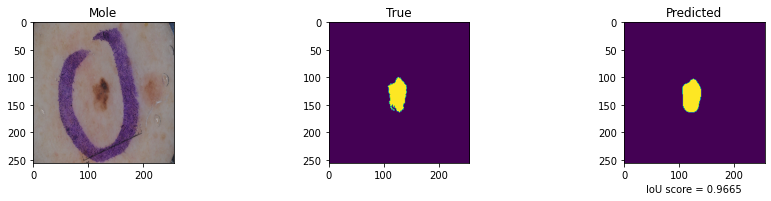

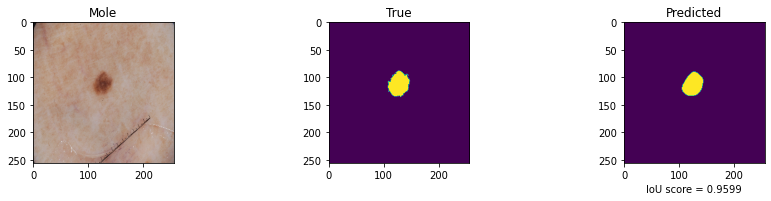

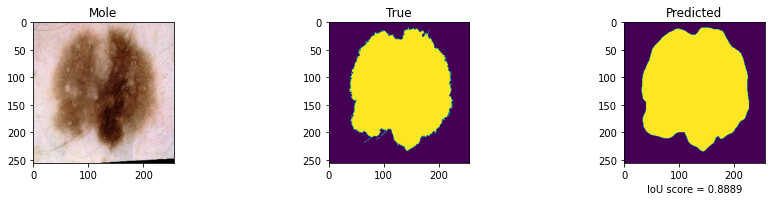

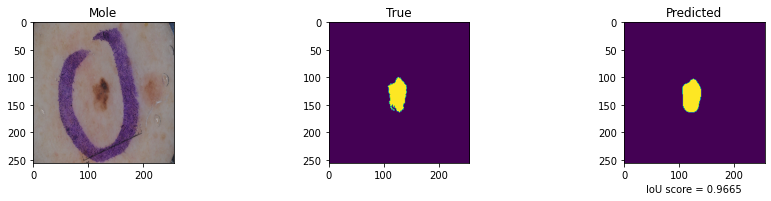

In [ ]:
plot_mask_and_preds(best_seg_model,test_data,best_threshold)

<h4>Можно увидеть из результатов, что сегментация хорошая</h4>

## Дистилляция модели

<h3>Суть:<p><h4>В реальности очень большие модели, например такие как Unet resnet101(в реальности намного больше) очень тяжело интегрировать в продакшен, одна из причин это огромный вес модели, число ее параметров. Поэтому придумали подход, благодаря которому маленькая модель может получить похожие результаты как и большая. В начале мы обучем большую модель на основе наших данных, потом тренируем маленькую модель на основе тех же данных в связке с этой большой сетью и интегрируем в продакшен маленькую модель. В качестве учителя будет выступать Unet resnet101, а в качестве ученика LinkNet resnet34, потому что она показала самые плохие результаты</h4></p></h3>

### Модель учителя

<h4>В качестве модели учителя возьмем Unet resnet101, так как она дала самые лучшие результаты на тестовых данных</h4>

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/UnetResNet101_best_model.pt")
teacher_model=smp.Unet(encoder_name="resnet101",encoder_depth=5,encoder_weights='imagenet',
                          decoder_channels=(256, 128, 64, 32, 16),decoder_use_batchnorm=True,
                          in_channels=3,classes=1,activation=None
                          ).cuda()
teacher_model.load_state_dict(state['state_dict'])

Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to /root/.cache/torch/hub/checkpoints/resnet101-5d3b4d8f.pth


  0%|          | 0.00/170M [00:00<?, ?B/s]

<All keys matched successfully>

### Модель ученика

<h4>В качестве модели ученика возьму LinkNet resnet34</h4>

In [ ]:
student_model=smp.Linknet(encoder_name="resnet34",encoder_weights='imagenet',
                          in_channels=3,classes=1,activation=None,
                          decoder_use_batchnorm=True
                          ).cuda()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.cache/torch/hub/checkpoints/resnet34-333f7ec4.pth


  0%|          | 0.00/83.3M [00:00<?, ?B/s]

### Функции дистилляции

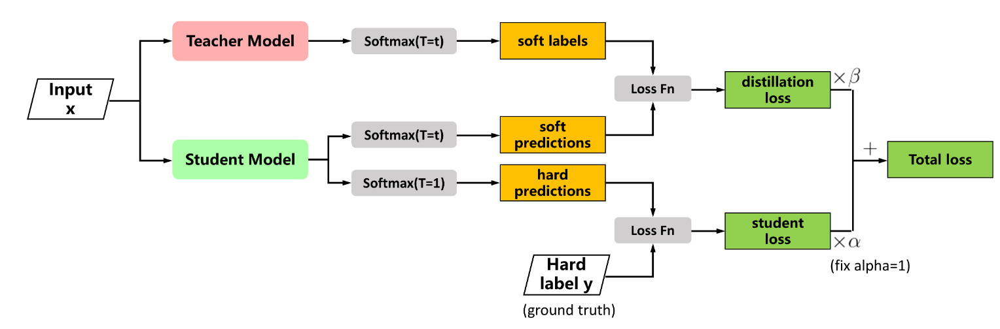

<h4>Как показанно на схеме функция стоимости состоит из суммы CE и дивергенции кульбака-лейблера умноженные на свои коэффициенты. В CE в качестве правидьных результатов hard label, то есть one-hot-vector, а в KL подается в качестве правильных результатов soft label модели учителя</h4>

<h4>Также softmax не обычный, а с сглаживающим параметром</h4>

In [ ]:
def loss_fn_kd_seg(student_mask,true_mask,teacher_mask,alpha,T):
  ce_loss=torch.nn.BCEWithLogitsLoss()
  kl_loss = torch.nn.KLDivLoss(reduction="batchmean")
  log_softmax=torch.nn.LogSoftmax(dim=1)
  softmax=torch.nn.Softmax(dim=1)
  loss = ce_loss(student_mask,true_mask)*(1.-alpha) +  kl_loss(log_softmax(student_mask/T),softmax(teacher_mask/T))*(alpha*T*T)
  return loss

### Train distillation

In [ ]:
def train_seg_net_kd(network,teacher_model,train_loader,val_loader,alpha,T,learning_rate=0.001,epochs=3,loaded_optimizer=None,threshold=1,network_name=None):
    optimizer=None
    if loaded_optimizer:
      optimizer=loaded_optimizer
    else:
      optimizer=torch.optim.AdamW(network.parameters(),lr=learning_rate) # Optimizer
    
    loss_fn=torch.nn.BCEWithLogitsLoss() # Функция стоимости
    best_error=999
    iou_score=0
    errors=[]
    errors_val=[]
    IoU_score_1=[]
    IoU_score_val_1=[]

    network.train() # переводим сеть в состояние обучения
    teacher_model.eval()

    for epoch in tqdm(range(epochs)):
        error=0
        iou_score=0
        for x_batch,y_batch in tqdm(train_loader):

            x_batch=x_batch.cuda() # передаем данные на куду
            y_batch=y_batch.cuda() 

            optimizer.zero_grad()

            y_pred=network(x_batch)

            y_batch=torch.unsqueeze(y_batch,1)

            with torch.no_grad():
                y_pred_teacher=teacher_model(x_batch)
            y_pred_teacher.requires_grad=False

            loss=loss_fn_kd_seg(y_pred,y_batch,y_pred_teacher,alpha,T)

            error+=loss.item()

            loss.backward()

            optimizer.step()

            iou_score+=IoU(y_batch.detach(),y_pred.detach(),threshold).mean().item()

        print(error/len(train_loader))
        errors.append(error/len(train_loader))
        IoU_score_1.append(iou_score/len(train_loader))

        print(f"Epoch = {epoch}")
        print(f"Train error = {error/len(train_loader)}, IoU = {iou_score/len(train_loader)}")
        
        network.eval() #переводим сеть в состояние оценивание: исключаем слои, которые используются только train
        with torch.no_grad(): # временно устанавливает флаги requires_grad=False
            error_val=0
            iou_metric_val=0
            for x_val,y_true in val_loader:
                x_val=x_val.cuda()    
                y_predicted=network(x_val.detach())

                y_predicted=y_predicted.cuda()
                y_true=y_true.cuda()
                y_true=torch.unsqueeze(y_true,1)

                loss_val=loss_fn(y_predicted.detach(),y_true.detach())
                error_val+=loss_val.item()

                iou_metric_val+=IoU(y_true.detach(),y_predicted.detach(),threshold).mean().item() # IoU на маске матовое стекло с порогом 1

            IoU_score_val_1.append(iou_metric_val/len(val_loader))
            errors_val.append(error_val/len(val_loader))
            print(f"Val error = {error_val/len(val_loader)}, IoU val= {iou_metric_val/len(val_loader)}")

            if best_error>error_val/len(val_loader):
                print(f'Save best model with val error {error_val/len(val_loader)}')
                state = {
                        'state_dict': network.state_dict(),
                        'optimizer' : optimizer.state_dict()}
                if network_name:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/{network_name}_best_model.pt") #Сохраняем наилучшую модель
                else:
                    torch.save(state, f"/content/drive/MyDrive/ML_models/FinalProject/Weight/best_model.pt")
                best_error=error_val/len(val_loader)
            else:
                print(f"Don't save model. Val error is {error_val/len(val_loader)}")
            
        network.train()

    return network,errors,IoU_score_1,errors_val,IoU_score_val_1

### Обучение

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

32992

In [ ]:
final_net,errors,IoU_score_1,errors_val,IoU_score_val_1=train_seg_net_kd(student_model,teacher_model,train_loader,val_loader,0.2,1.5,epochs=10,threshold=0.5,network_name="DistillationLinkNetresnet101")

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

0.2700191658167612
Epoch = 0
Train error = 0.2700191658167612, IoU = 0.7347311202495818
Val error = 0.23786733150482178, IoU val= 0.8191808342933655
Save best model with val error 0.23786733150482178


  0%|          | 0/63 [00:00<?, ?it/s]

0.14110105307329268
Epoch = 1
Train error = 0.14110105307329268, IoU = 0.8301921751764085
Val error = 0.2056701064109802, IoU val= 0.8019031405448913
Save best model with val error 0.2056701064109802


  0%|          | 0/63 [00:00<?, ?it/s]

0.11870252246421481
Epoch = 2
Train error = 0.11870252246421481, IoU = 0.8343896373869881
Val error = 0.1546068787574768, IoU val= 0.8551352500915528
Save best model with val error 0.1546068787574768


  0%|          | 0/63 [00:00<?, ?it/s]

0.1012959535869341
Epoch = 3
Train error = 0.1012959535869341, IoU = 0.8496743610927037
Val error = 0.15790525078773499, IoU val= 0.8557365298271179
Don't save model. Val error is 0.15790525078773499


  0%|          | 0/63 [00:00<?, ?it/s]

0.10076309799674958
Epoch = 4
Train error = 0.10076309799674958, IoU = 0.8471338417794969
Val error = 0.1619622752070427, IoU val= 0.8469014644622803
Don't save model. Val error is 0.1619622752070427


  0%|          | 0/63 [00:00<?, ?it/s]

0.09361347786727406
Epoch = 5
Train error = 0.09361347786727406, IoU = 0.8528073988263569
Val error = 0.170859494805336, IoU val= 0.8383107900619506
Don't save model. Val error is 0.170859494805336


  0%|          | 0/63 [00:00<?, ?it/s]

0.09187436470436672
Epoch = 6
Train error = 0.09187436470436672, IoU = 0.8561529952382284
Val error = 0.15055073499679567, IoU val= 0.8476127505302429
Save best model with val error 0.15055073499679567


  0%|          | 0/63 [00:00<?, ?it/s]

0.08916308719014364
Epoch = 7
Train error = 0.08916308719014364, IoU = 0.8577807507817707
Val error = 0.12788028717041017, IoU val= 0.8671175479888916
Save best model with val error 0.12788028717041017


  0%|          | 0/63 [00:00<?, ?it/s]

0.08621844915407044
Epoch = 8
Train error = 0.08621844915407044, IoU = 0.8605741659800211
Val error = 0.19088196456432344, IoU val= 0.8271763443946838
Don't save model. Val error is 0.19088196456432344


  0%|          | 0/63 [00:00<?, ?it/s]

0.08460387238670909
Epoch = 9
Train error = 0.08460387238670909, IoU = 0.8596250982511611
Val error = 0.14715124815702438, IoU val= 0.856382155418396
Don't save model. Val error is 0.14715124815702438


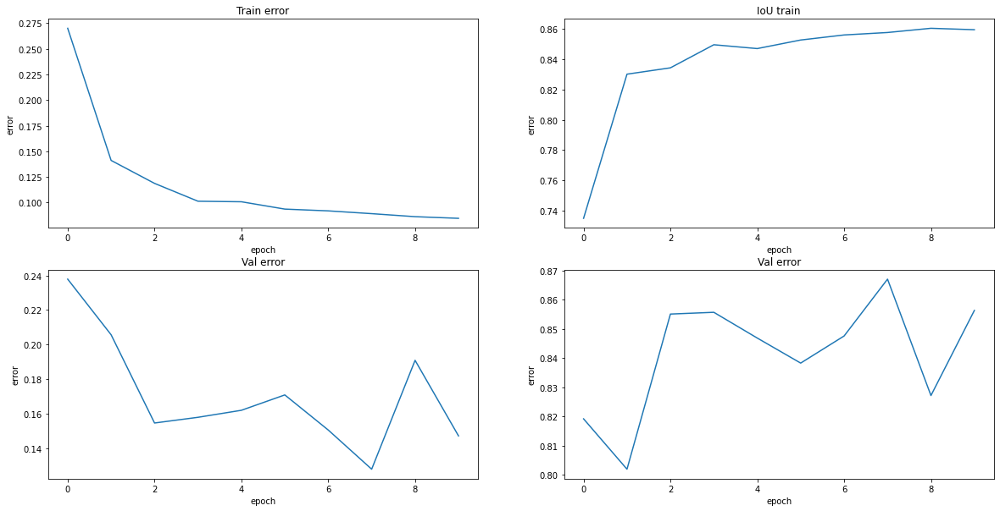

In [ ]:
plot_acc_error(errors,IoU_score_1,errors_val,IoU_score_val_1)

<h4>Как видно из результатов, ошибка на train и val падает, IoU на train и val увеличивается.</h4>

### Загрузка самой лучшей

In [ ]:
state=torch.load("/content/drive/MyDrive/ML_models/FinalProject/Weight/DistillationLinkNetresnet101_best_model.pt")
best_seg_model=smp.Linknet(encoder_name="resnet34",encoder_weights='imagenet',
                          in_channels=3,classes=1,activation=None,
                          decoder_use_batchnorm=True
                          ).cuda()
best_seg_model.load_state_dict(state['state_dict'])

<All keys matched successfully>

### Выбор порога

In [ ]:
thresholds=np.arange(-1,3,0.1)

In [ ]:
IoU_score,best_threshold=config_threshold(best_seg_model,test_loader,thresholds)

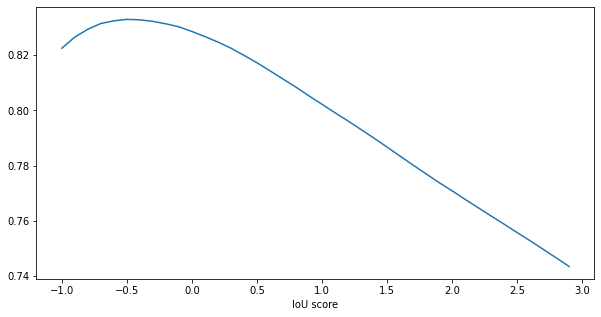

In [ ]:
plot_thresholds(IoU_score,thresholds)

In [ ]:
round(best_threshold,3)

-0.5

<h4>Лучшая IoU при пороге -0.5, IoU = 0.84</h4>

### Plot mole with mask

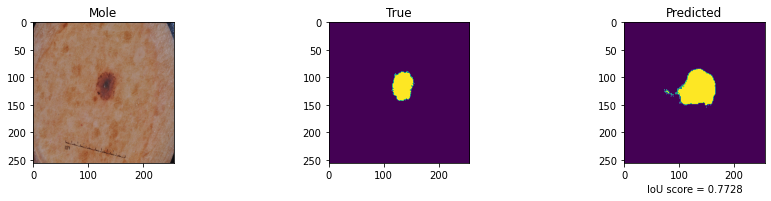

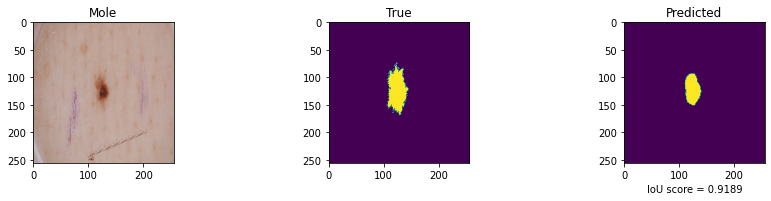

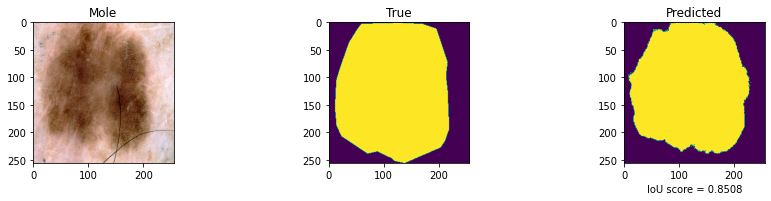

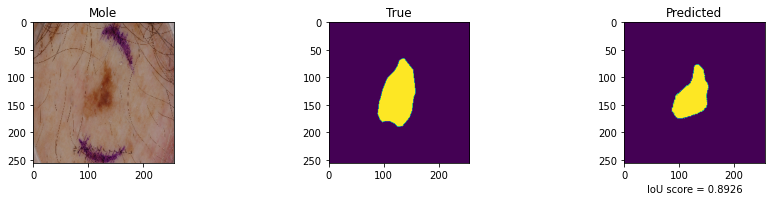

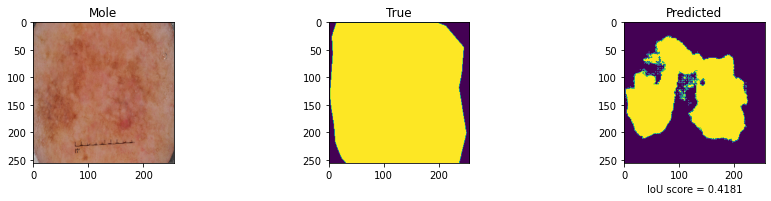

In [ ]:
plot_mask_and_preds(best_seg_model,test_data,best_threshold)

<h4>Можно увидеть из результатов, что сегментация хорошая</h4>

## Выводы

<h4>Как видно из резльтатов все модели справились с задачей сегментации хорошо, IoU равна 0.82 - 0.84. Самые лучшие модели это Unet и PAN. После дистилляции качетво модели LeakyNet увеличилось на 1%</h4>

# Часть 3

<h4>В данной части будет классифицирована степень ожога и детектирован ожег</h4>

## Загрузка данных

In [ ]:
import cv2

In [ ]:
!mkdir skd

In [ ]:
%cp /content/drive/MyDrive/Kaggle/skin-burn-dataset.zip /content/skd/skin-burn-dataset.zip

In [ ]:
%cd /content/skd

/content/skd


In [ ]:
!unzip /content/skd/skin-burn-dataset.zip

<h4>YOLO v5 requires the dataset to be in the *darknet format*. Here's an outline of what it looks like:

- One txt with labels file per image
- One row per object
- Each row contains: `class_index bbox_x_center bbox_y_center bbox_width bbox_height`
- Box coordinates must be normalized between 0 and 1

## print_border

In [ ]:
def print_border(img,df):
    img=cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    height,width,_=img.shape
    d={
        0:"first degree",
        1:"second degree",
        2:"third degree"
    }
    df.columns = ['class', 'bbox_x_center', 'bbox_y_center', 'bbox_width','bbox_height']
    plt.figure(figsize=(10,10))
    for i in range(len(df)):
        x_min=(df["bbox_x_center"][i]-df["bbox_width"][i]/2)*width
        x_max=(df["bbox_x_center"][i]+df["bbox_width"][i]/2)*width
        y_min=(df["bbox_y_center"][i]-df["bbox_height"][i]/2)*height
        y_max=(df["bbox_y_center"][i]+df["bbox_height"][i]/2)*height

        cv2.rectangle(img,
            (int(x_min),int(y_min)),
            (int(x_max),int(y_max)),
            color = (255, 0, 0),
            thickness=2)
        
        label=d[df['class'][i]]

        cv2.putText(
        img,
        label,
        org=(int(x_min), int(y_min)),
        fontFace=cv2.FONT_HERSHEY_PLAIN,
        fontScale=0.75,
        color=(255, 255, 255),
        thickness=1
        )
    plt.imshow(img)   
    return 0

In [ ]:
img=cv2.imread("/content/skd/img43.jpg")
df=pd.read_csv("/content/skd/img43.txt",sep=" ",header=None)

0

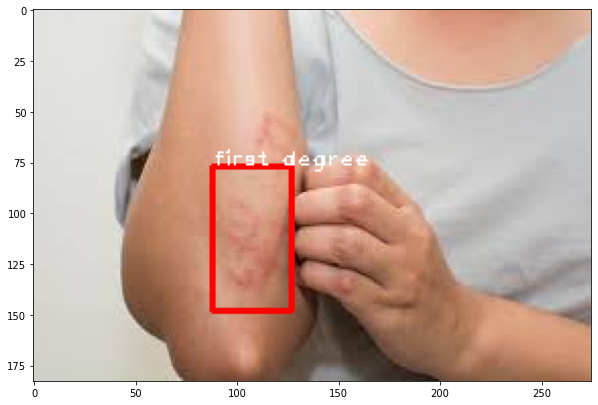

In [ ]:
print_border(img,df)

## Подготовка данных

<h4>Данные должны быть расположены так</h4>

In [ ]:
'''
burns
├── images
│   ├── train
│   └── val
└── labels
    ├── train
    └── val
'''

In [ ]:
!sudo apt-get install tree -qq > /dev/null

debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 


In [ ]:
!git clone https://github.com/NVIDIA/apex && cd apex && pip install -v --no-cache-dir --global-option="--cpp_ext" --global-option="--cuda_ext" . --user && cd .. && rm -rf apex

Cloning into 'apex'...
remote: Enumerating objects: 10117, done.
remote: Counting objects: 100% (233/233), done.
remote: Compressing objects: 100% (165/165), done.
remote: Total 10117 (delta 119), reused 152 (delta 62), pack-reused 9884
Receiving objects: 100% (10117/10117), 14.97 MiB | 16.88 MiB/s, done.
Resolving deltas: 100% (6927/6927), done.
/usr/local/lib/python3.7/dist-packages/pip/_internal/commands/install.py:232: UserWarning: Disabling all use of wheels due to the use of --build-option / --global-option / --install-option.
  cmdoptions.check_install_build_global(options)
Using pip 21.1.3 from /usr/local/lib/python3.7/dist-packages/pip (python 3.7)
User install by explicit request
Created temporary directory: /tmp/pip-ephem-wheel-cache-70euwxdf
Created temporary directory: /tmp/pip-req-tracker-3m491bi_
Initialized build tracking at /tmp/pip-req-tracker-3m491bi_
Created build tracker: /tmp/pip-req-tracker-3m491bi_
Entered build tracker: /tmp/pip-req-tracker-3m491bi_
Created tem

In [ ]:
import re

In [ ]:
adds=[]
for addres,dirs,files in os.walk("/content/skd"):
    for f in files:
        if f.endswith(".jpg"):
            adds.append(re.findall(r'\d+',f)[0])

In [ ]:
%cd /content/
!mkdir burns

/content


In [ ]:
%cd /content/burns
!mkdir images
!mkdir labels

/content/burns


In [ ]:
%cd /content/burns/images
!mkdir train
!mkdir val

/content/burns/images


In [ ]:
%cd /content/burns/labels
!mkdir train
!mkdir val

/content/burns/labels


In [ ]:
%cd /content/

/content


In [ ]:
train_data,test_data=train_test_split(adds,test_size=0.15,shuffle=True,random_state=123)

In [ ]:
len(train_data),len(test_data)

(1041, 184)

### Формируем train/val

In [ ]:
for f_name in tqdm(train_data):
    %cp /content/skd/img{f_name}.jpg /content/burns/images/train/{f_name}.jpg
    %cp /content/skd/img{f_name}.txt /content/burns/labels/train/{f_name}.txt

  0%|          | 0/1041 [00:00<?, ?it/s]

In [ ]:
for f_name in tqdm(test_data):
    %cp /content/skd/img{f_name}.jpg /content/burns/images/val/{f_name}.jpg
    %cp /content/skd/img{f_name}.txt /content/burns/labels/val/{f_name}.txt

  0%|          | 0/184 [00:00<?, ?it/s]

## Yolov5s(640x640)

### Обучение

<h3>
<p>В data переместить burns.yaml (содердит пути к моим данным)</p>
<p>В models yolov5x.yaml изменить количество nc</p>

<p>В /content/yolov5/runs/train/yolov5x_cars/weights/best.pt лежат лучшие веса</p>
<p>yolov5x.pt содержит веса модели</p>
<p>models/yolov5x.yaml содержит архитектуру модели(Но там еще есть и другие)</p>
</h3>

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 12618, done.
remote: Total 12618 (delta 0), reused 0 (delta 0), pack-reused 12618
Receiving objects: 100% (12618/12618), 12.45 MiB | 5.54 MiB/s, done.
Resolving deltas: 100% (8651/8651), done.


In [ ]:
%cd /content/yolov5

/content/yolov5


In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/burns.yaml /content/yolov5/data/burns.yaml

In [ ]:
!python train.py --img 640 --batch 4 --epochs 30 \
  --data ./data/burns.yaml --cfg ./models/yolov5s.yaml --weights yolov5s.pt \
  --name yolov5s_burns --cache

train: weights=yolov5s.pt, cfg=./models/yolov5s.yaml, data=./data/burns.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=4, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_burns, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-357-ga75a110 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, 

### Результаты

In [ ]:
from PIL import Image

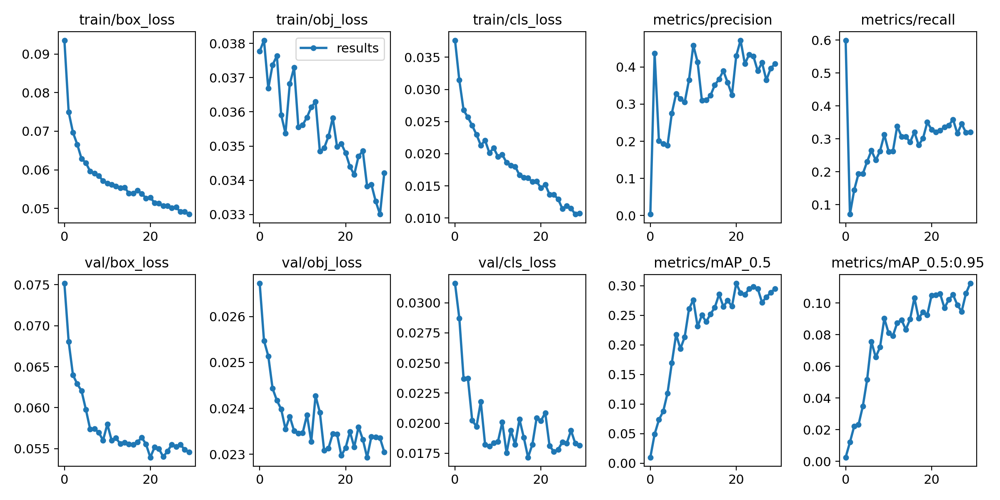

In [ ]:
image_res=Image.open("/content/yolov5/runs/train/yolov5s_burns2/results.png")
image_res

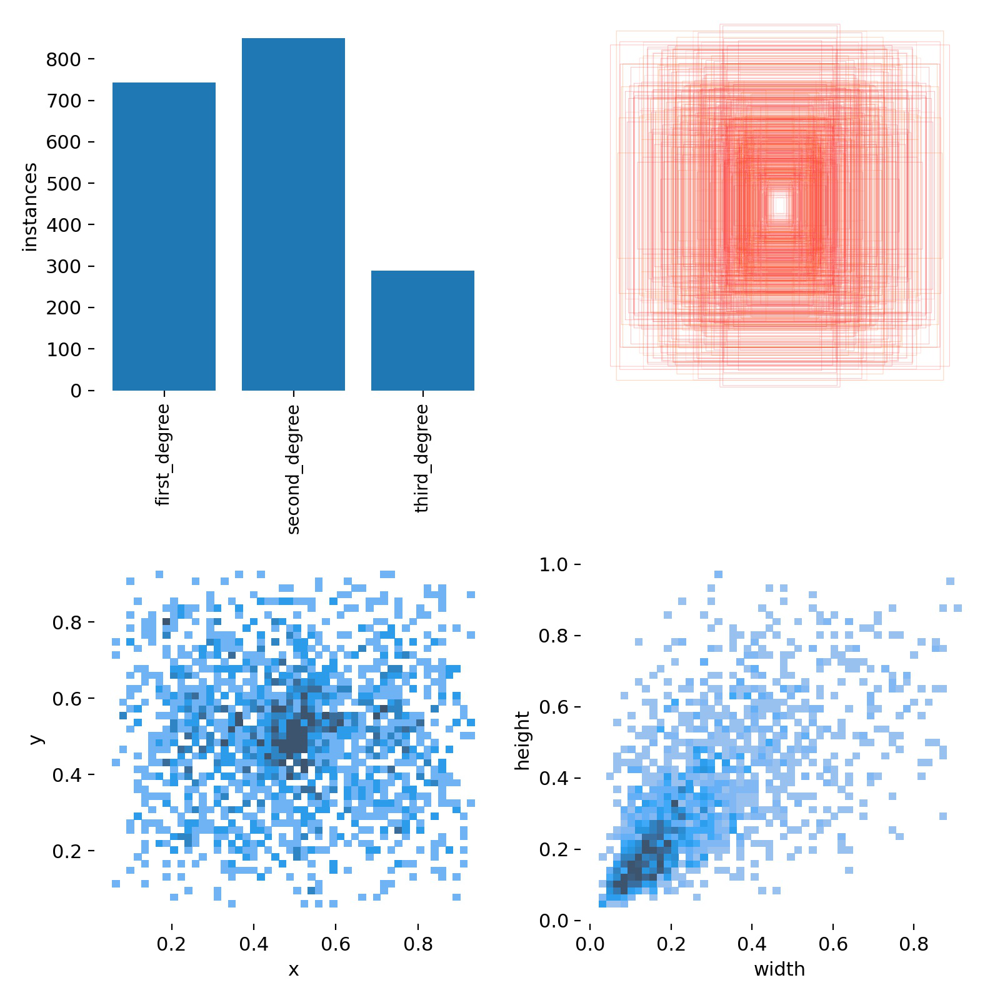

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5s_burns2/labels.jpg")
res

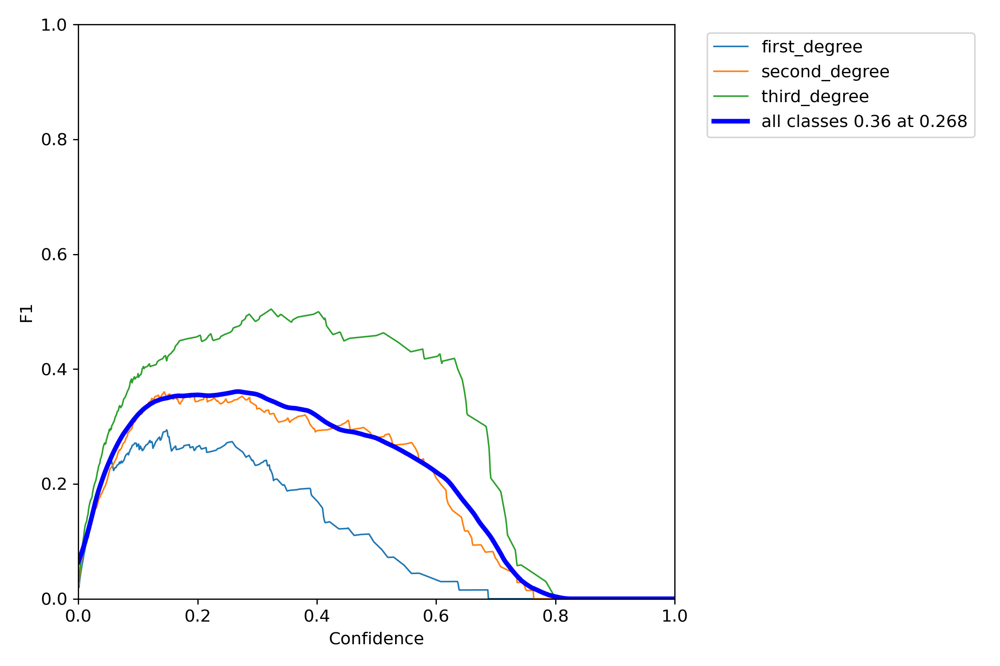

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5s_burns2/F1_curve.png")
res

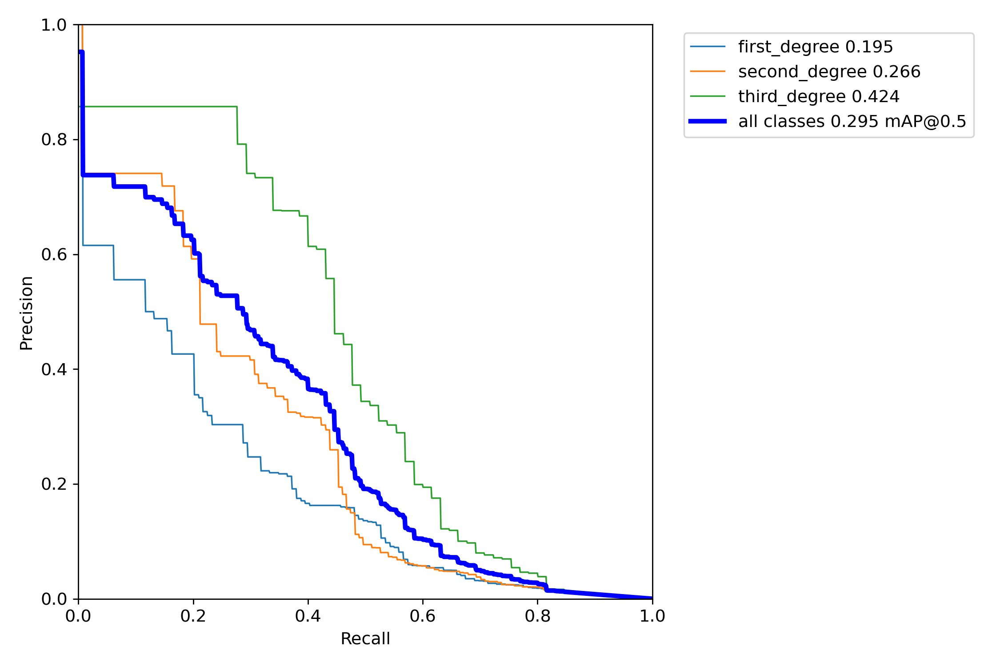

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5s_burns2/PR_curve.png")
res

In [ ]:
!mkdir -p /content/yolov5/inference/images

In [ ]:
!find /content/burns/images/val -maxdepth 1 -type f | head -50 | xargs cp -t "/content/yolov5/inference/images/"

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/best_yolo5s.pt /content/best_yolo5s.pt

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/yolov5s.yaml /content/yolov5/models/yolov5s.yaml

In [ ]:
# !python detect.py --weights /content/best_yolo5s.pt \
#   --img 640 --conf 0.19 --source ./inference/images_1/

In [ ]:
!python detect.py --weights /content/best_yolo5s.pt \
  --img 640 --conf 0.19 --source ./inference/images/

detect: weights=['/content/best_yolo5s.pt'], source=./inference/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.19, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7018216 parameters, 0 gradients
image 1/50 /content/yolov5/inference/images/1040.jpg: 448x640 2 first_degrees, Done. (0.014s)
image 2/50 /content/yolov5/inference/images/1085.jpg: 448x640 1 first_degree, Done. (0.010s)
image 3/50 /content/yolov5/inference/images/1101.jpg: 448x640 1 zero_degree, Done. (0.010s)
image 4/50 /content/yolov5/inference/images/1117.jpg: 448x640 1 zero_degree, Done. (0.010s)
image 5

<h4>Реальные</h4>

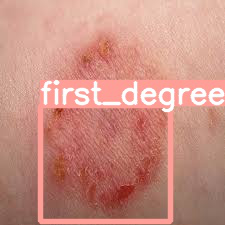

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp2/113.jpg")
image_res

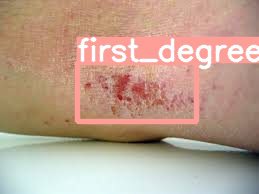

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp2/498.jpg")
image_res

<h4>Реальные</h4>

In [ ]:
img=cv2.imread("/content/skd/img113.jpg")
df=pd.read_csv("/content/skd/img113.txt",sep=" ",header=None)

0

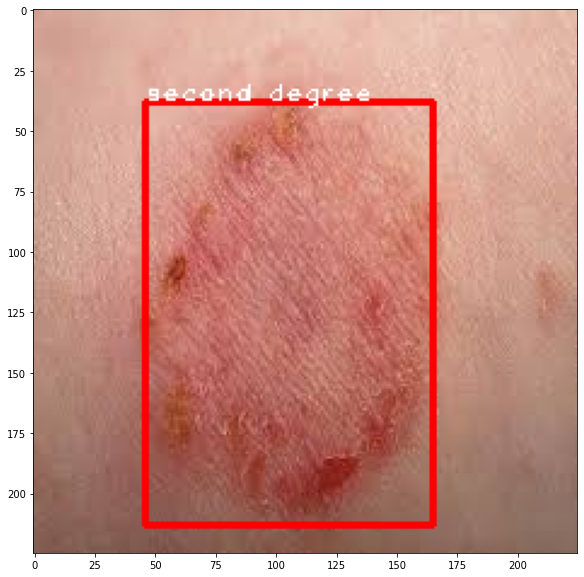

In [ ]:
print_border(img,df)

In [ ]:
img=cv2.imread("/content/skd/img498.jpg")
df=pd.read_csv("/content/skd/img498.txt",sep=" ",header=None)

0

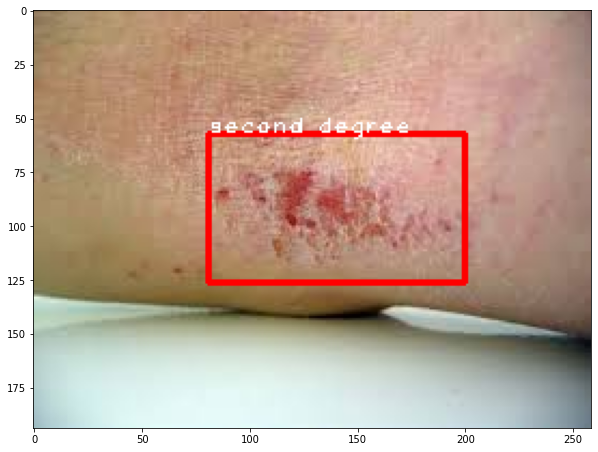

In [ ]:
print_border(img,df)

## Yolov5x(256x256)

### Обучение

In [ ]:
%cd /content/yolov5

/content/yolov5


In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/yolov5x.yaml /content/yolov5/models/yolov5x.yaml

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/burns.yaml /content/yolov5/data/burns.yaml

In [ ]:
!python train.py --img 256 --batch 64 --epochs 30 \
  --data ./data/burns.yaml --cfg ./models/yolov5x.yaml --weights yolov5x.pt \
  --name yolov5x_burns --cache

train: weights=yolov5x.pt, cfg=./models/yolov5x.yaml, data=./data/burns.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=64, imgsz=256, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5x_burns, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0,

### Результаты

In [ ]:
from PIL import Image

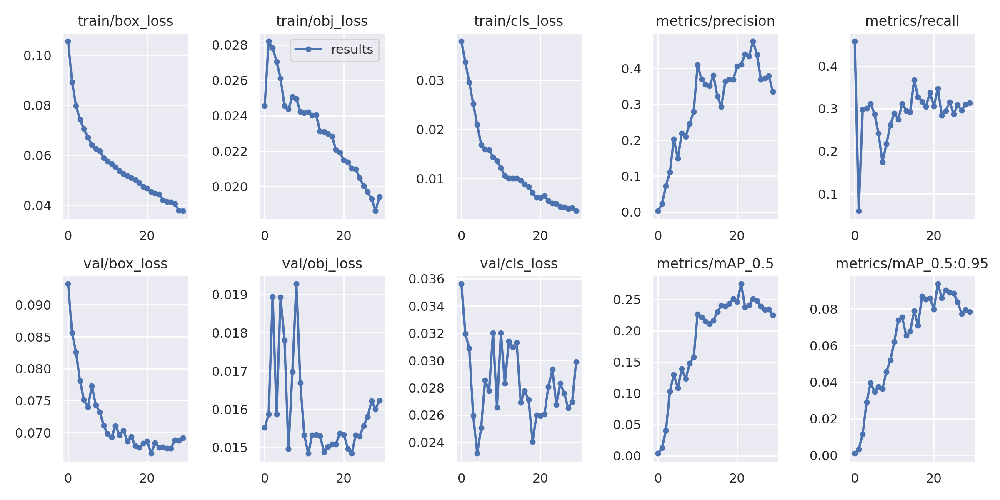

In [ ]:
image_res=Image.open("/content/yolov5/runs/train/yolov5x_burns2/results.png")
image_res

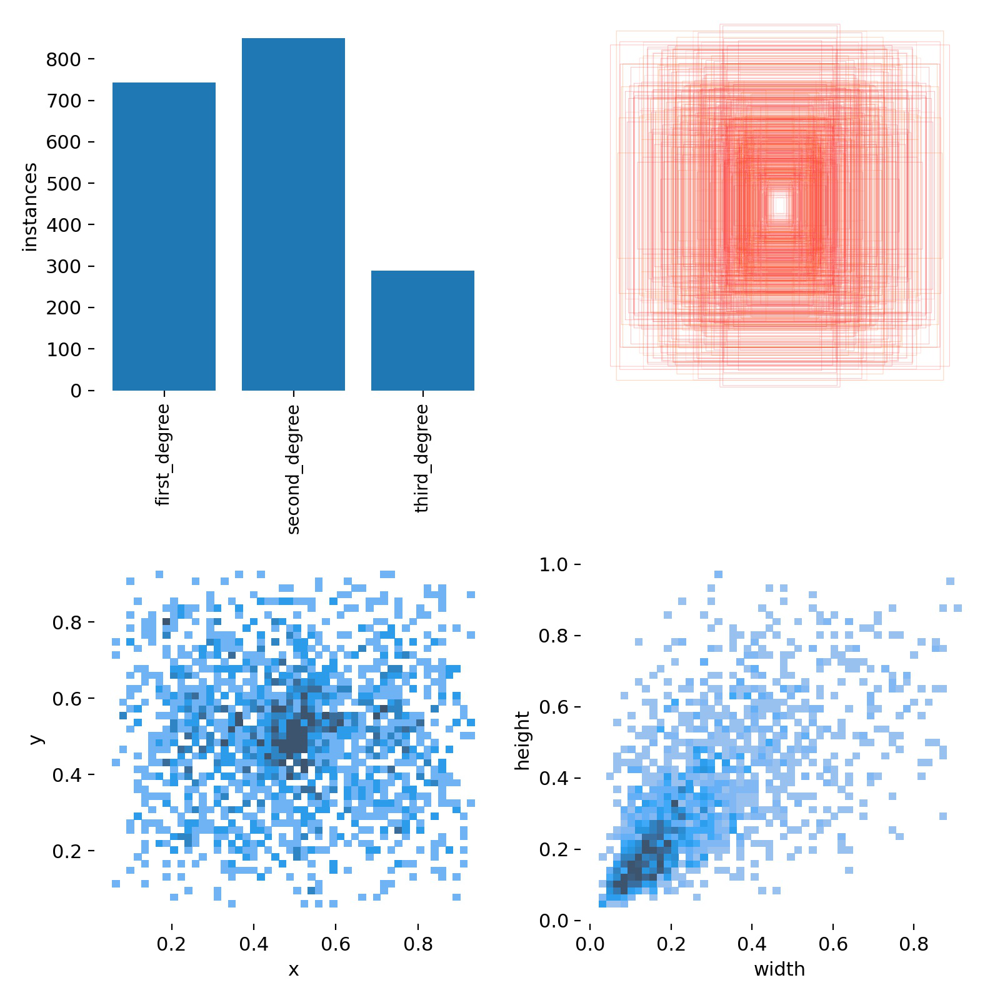

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5x_burns2/labels.jpg")
res

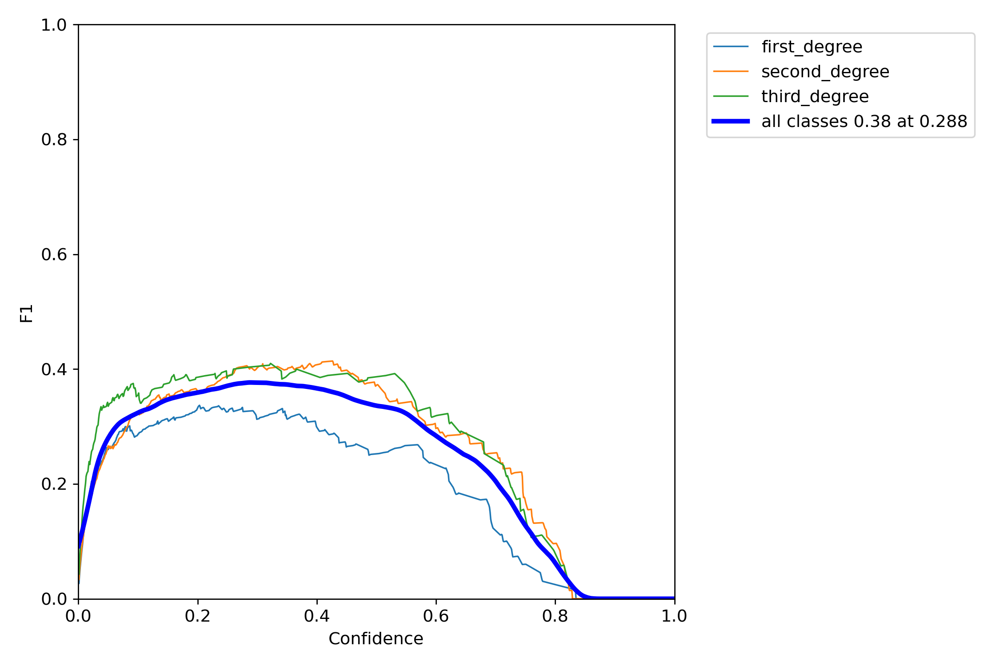

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5x_burns2/F1_curve.png")
res

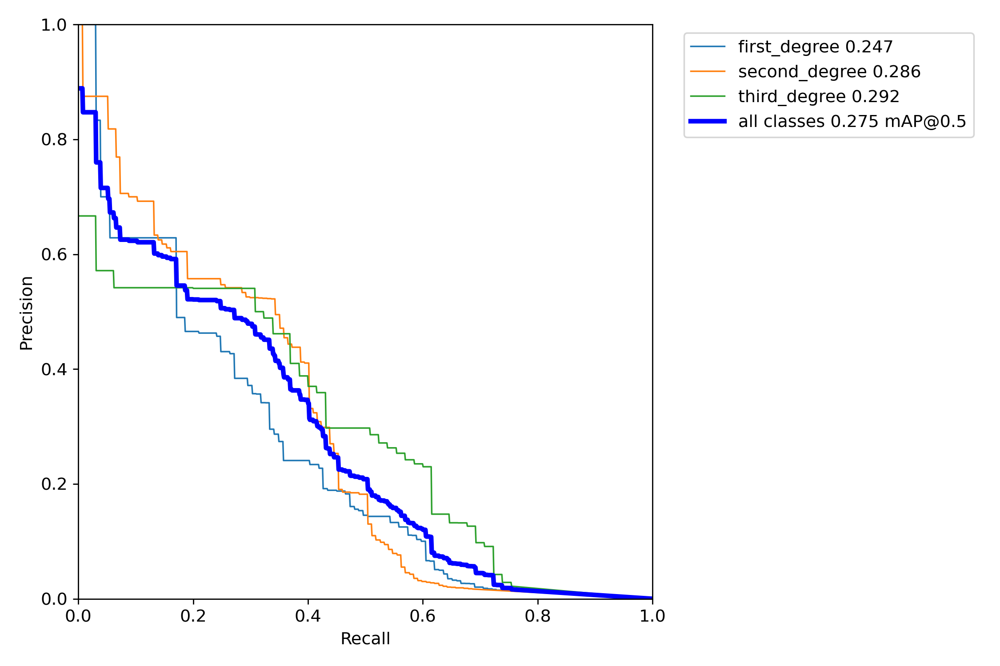

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5x_burns2/PR_curve.png")
res

In [ ]:
!cp /content/yolov5/runs/train/yolov5x_burns2/weights/best.pt /content/drive/MyDrive/ML_models/FinalProject/Weight/best_yolo5x256.pt

In [ ]:
!mkdir -p /content/yolov5/inference_1/images

In [ ]:
!find /content/burns/images/val -maxdepth 1 -type f | head -50 | xargs cp -t "/content/yolov5/inference_1/images/"

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/best_yolo5x.pt /content/best_yolo5x.pt

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/yolov5x.yaml /content/yolov5/models/yolov5x.yaml

In [ ]:
!python detect.py --weights /content/best_yolo5x.pt \
  --img 256 --conf 0.25 --source ./inference_1/images/

detect: weights=['/content/best_yolo5x.pt'], source=./inference_1/images/, data=data/coco128.yaml, imgsz=[256, 256], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5x summary: 444 layers, 86186872 parameters, 0 gradients
image 1/50 /content/yolov5/inference_1/images/1040.jpg: 192x256 2 first_degrees, Done. (0.027s)
image 2/50 /content/yolov5/inference_1/images/1085.jpg: 192x256 1 second_degree, Done. (0.025s)
image 3/50 /content/yolov5/inference_1/images/1101.jpg: 192x256 1 first_degree, Done. (0.025s)
image 4/50 /content/yolov5/inference_1/images/1117.jpg: 192x256 1 second_degree, Done. (

<h4>Предсказанные</h4>

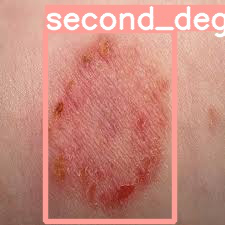

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp3/113.jpg")
image_res

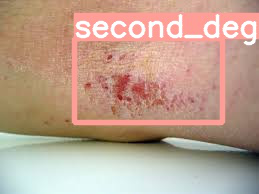

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp3/498.jpg")
image_res

<h4>Реальные</h4>

In [ ]:
img=cv2.imread("/content/skd/img113.jpg")
df=pd.read_csv("/content/skd/img113.txt",sep=" ",header=None)

0

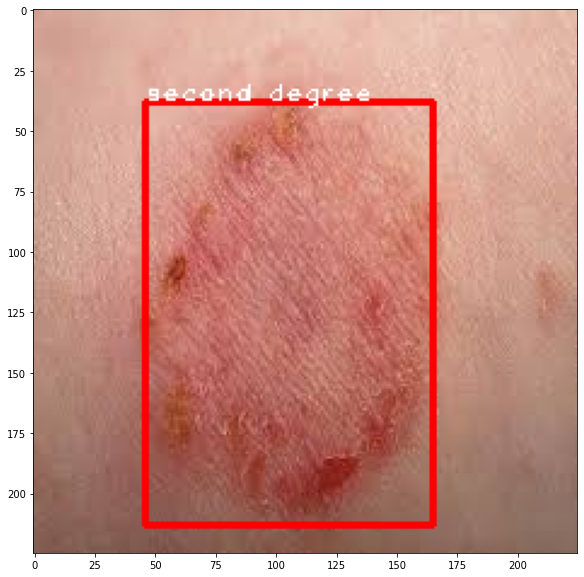

In [ ]:
print_border(img,df)

In [ ]:
img=cv2.imread("/content/skd/img498.jpg")
df=pd.read_csv("/content/skd/img498.txt",sep=" ",header=None)

0

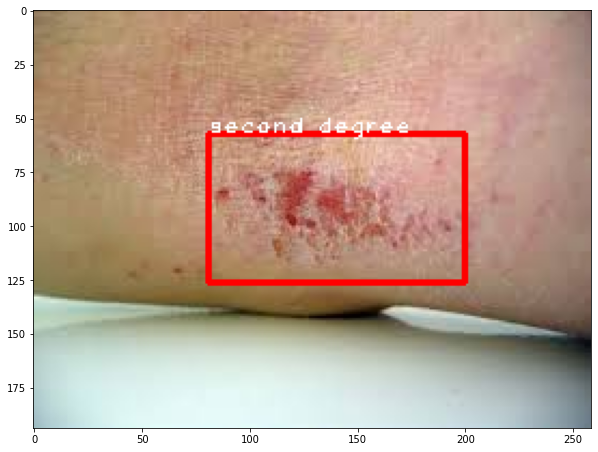

In [ ]:
print_border(img,df)

## Yolov5x(640x640)

### Обучение

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

319

In [ ]:
%cd /content/yolov5

/content/yolov5


In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/yolov5x.yaml /content/yolov5/models/yolov5x.yaml

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/burns.yaml /content/yolov5/data/burns.yaml

In [ ]:
!python train.py --img 640 --batch 16 --epochs 30 \
  --data ./data/burns.yaml --cfg ./models/yolov5x.yaml --weights yolov5x.pt \
  --name yolov5x_burns --cache

train: weights=yolov5x.pt, cfg=./models/yolov5x.yaml, data=./data/burns.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5x_burns, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-359-g628c05c Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0,

### Результаты

In [ ]:
from PIL import Image

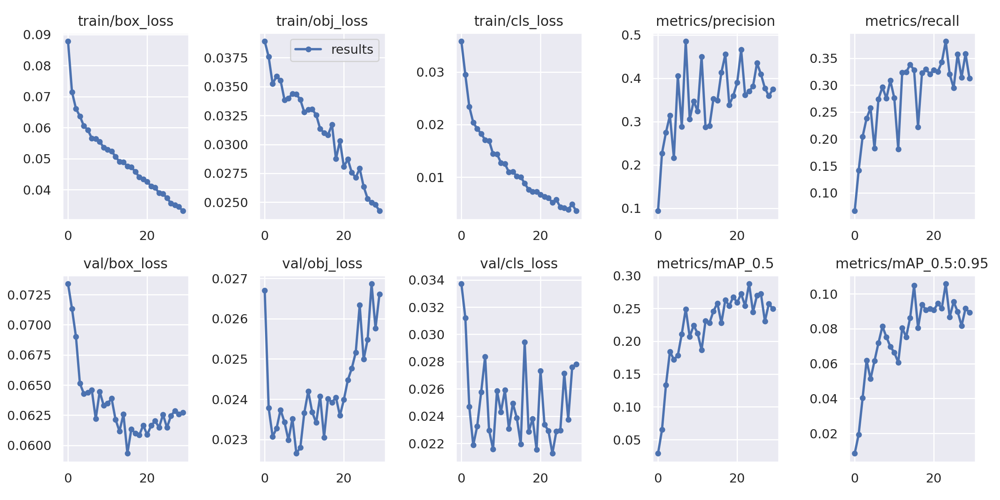

In [ ]:
image_res=Image.open("/content/yolov5/runs/train/yolov5x_burns8/results.png")
image_res

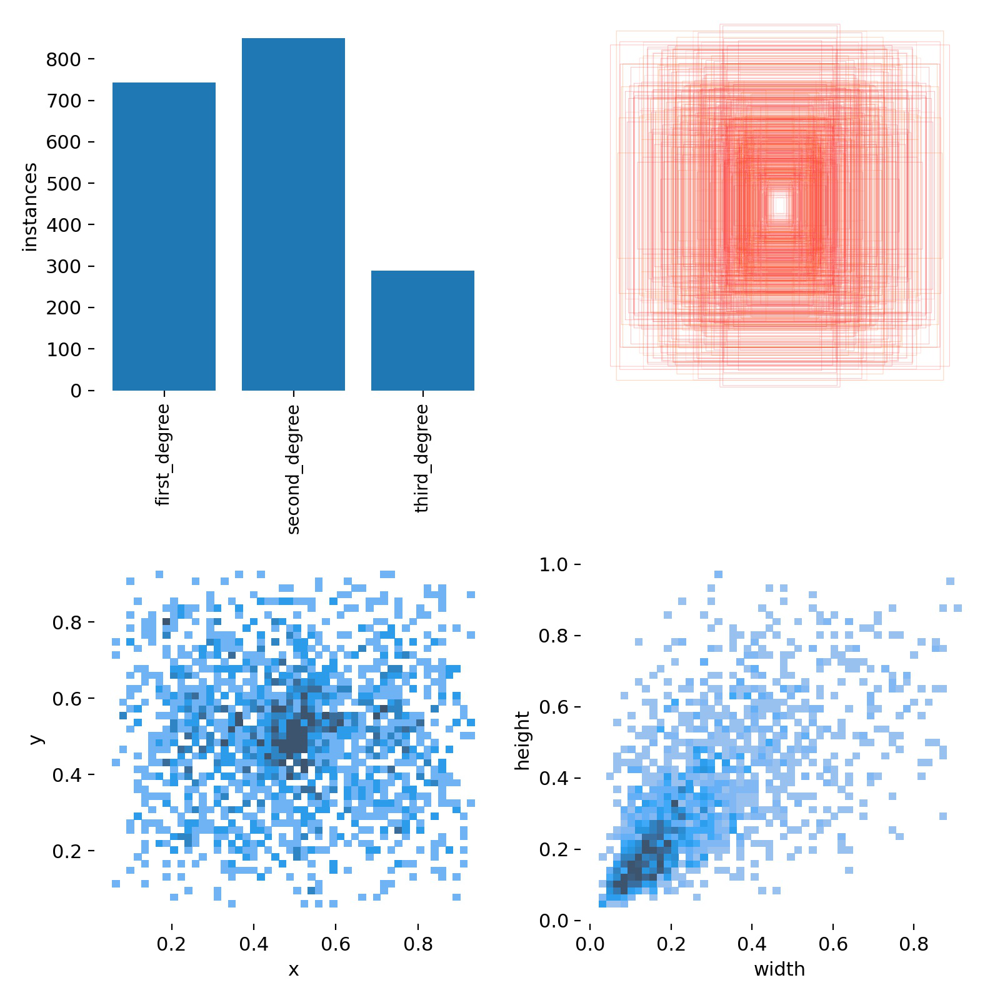

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5x_burns8/labels.jpg")
res

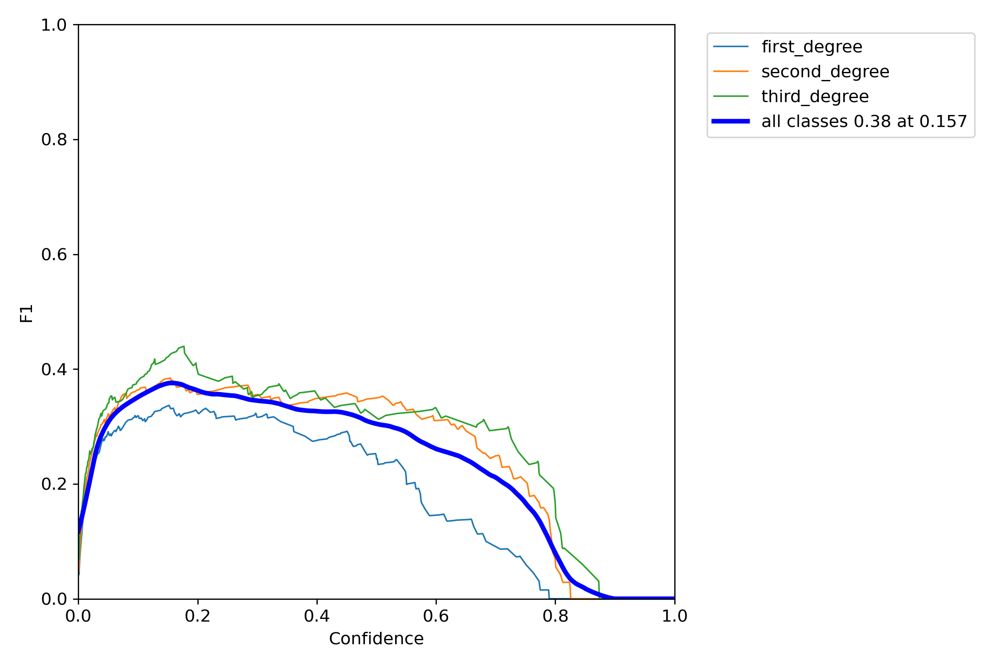

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5x_burns8/F1_curve.png")
res

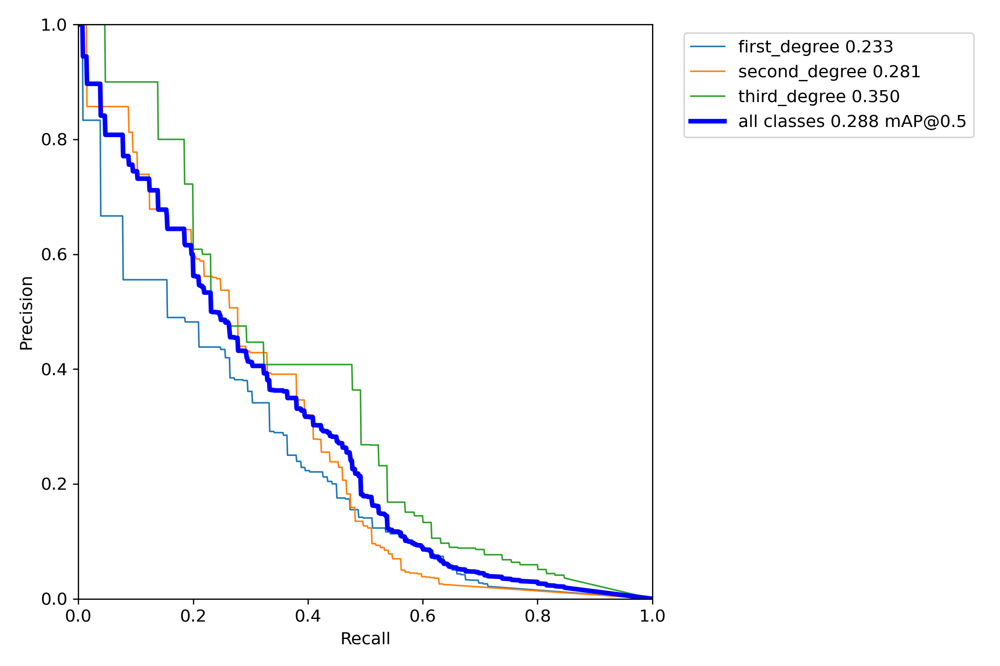

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5x_burns8/PR_curve.png")
res

In [ ]:
!cp /content/yolov5/runs/train/yolov5x_burns8/weights/best.pt /content/drive/MyDrive/ML_models/FinalProject/Weight/best_yolo5x640.pt

In [ ]:
!mkdir -p /content/yolov5/inference_2/images

In [ ]:
!find /content/burns/images/val -maxdepth 1 -type f | head -50 | xargs cp -t "/content/yolov5/inference_2/images/"

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/best_yolo5x640.pt /content/best_yolo5x640.pt

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/yolov5x.yaml /content/yolov5/models/yolov5x.yaml

In [ ]:
!python detect.py --weights /content/best_yolo5x640.pt \
  --img 640 --conf 0.15 --source ./inference_1/images/

<h4>Предсказанные</h4>

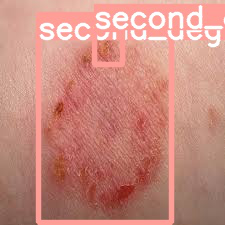

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp5/113.jpg")
image_res

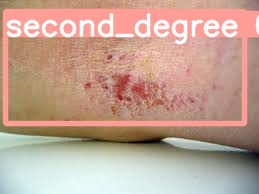

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp5/498.jpg")
image_res

<h4>Реальные</h4>

In [ ]:
img=cv2.imread("/content/skd/img113.jpg")
df=pd.read_csv("/content/skd/img113.txt",sep=" ",header=None)

0

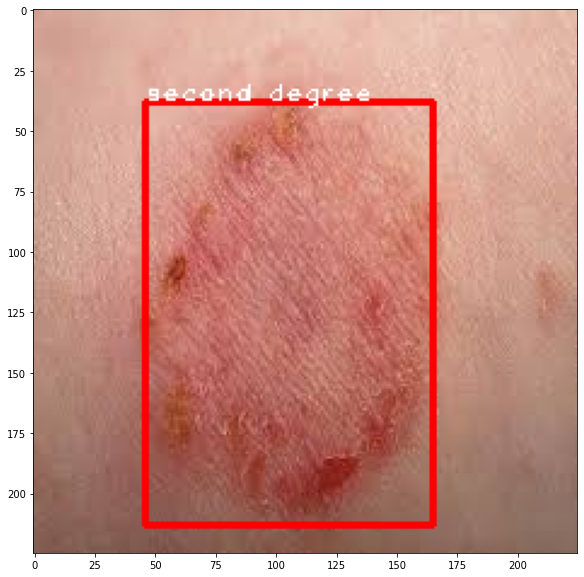

In [ ]:
print_border(img,df)

In [ ]:
img=cv2.imread("/content/skd/img498.jpg")
df=pd.read_csv("/content/skd/img498.txt",sep=" ",header=None)

0

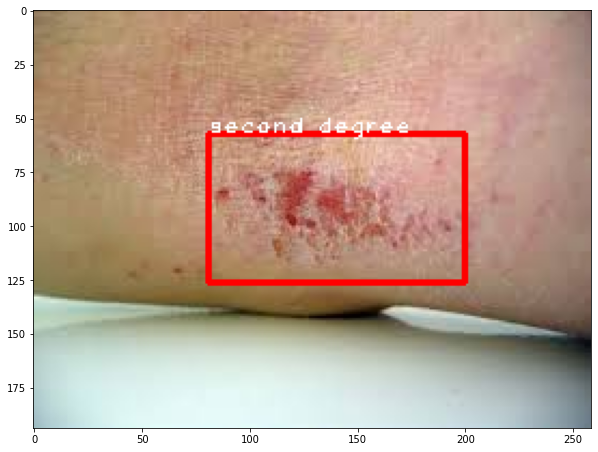

In [ ]:
print_border(img,df)

## Yolov5m(640x640)

### Обучение

In [ ]:
torch.cuda.empty_cache()
import gc
gc.collect()

219

In [ ]:
%cd /content/yolov5

/content/yolov5


In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/yolov5m.yaml /content/yolov5/models/yolov5m.yaml

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/burns.yaml /content/yolov5/data/burns.yaml

In [ ]:
!python train.py --img 640 --batch 32 --epochs 45 \
  --data ./data/burns.yaml --cfg ./models/yolov5m.yaml --weights yolov5m.pt \
  --name yolov5m_burns --cache

train: weights=yolov5m.pt, cfg=./models/yolov5m.yaml, data=./data/burns.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=45, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5m_burns, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-386-g2e57b84 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0,

### Результаты

In [ ]:
from PIL import Image

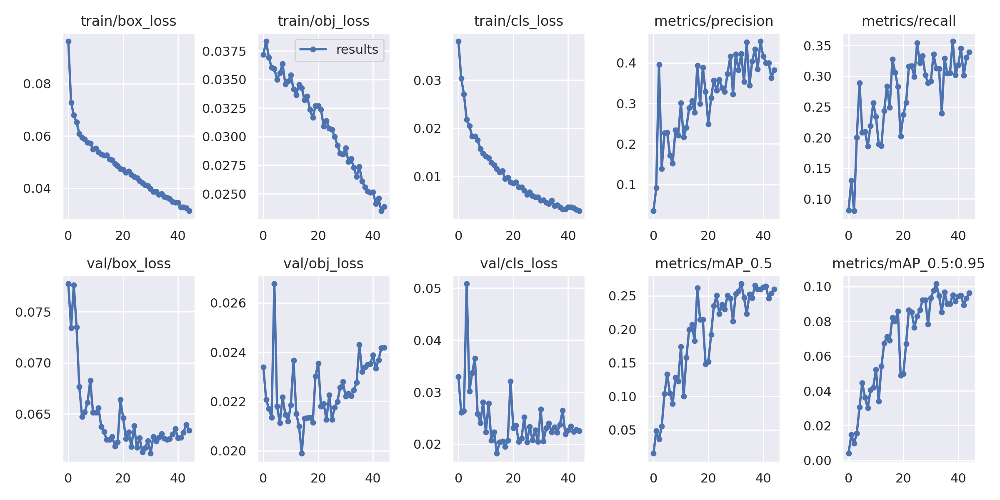

In [ ]:
image_res=Image.open("/content/yolov5/runs/train/yolov5m_burns4/results.png")
image_res

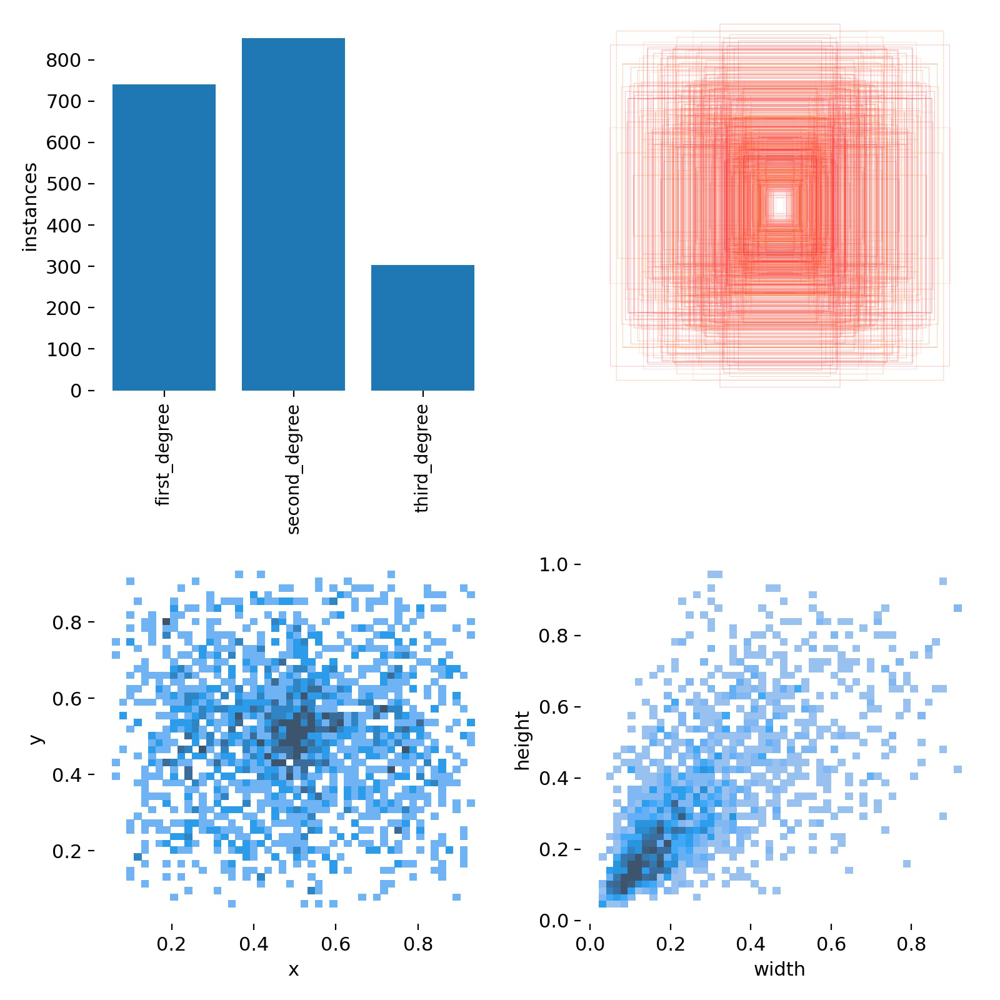

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5m_burns4/labels.jpg")
res

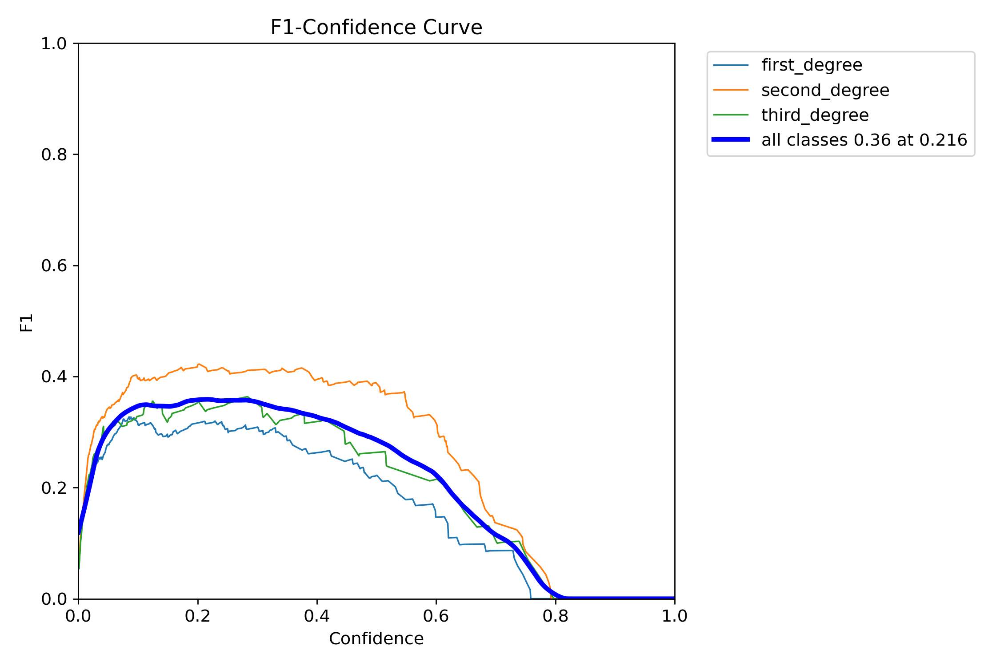

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5m_burns4/F1_curve.png")
res

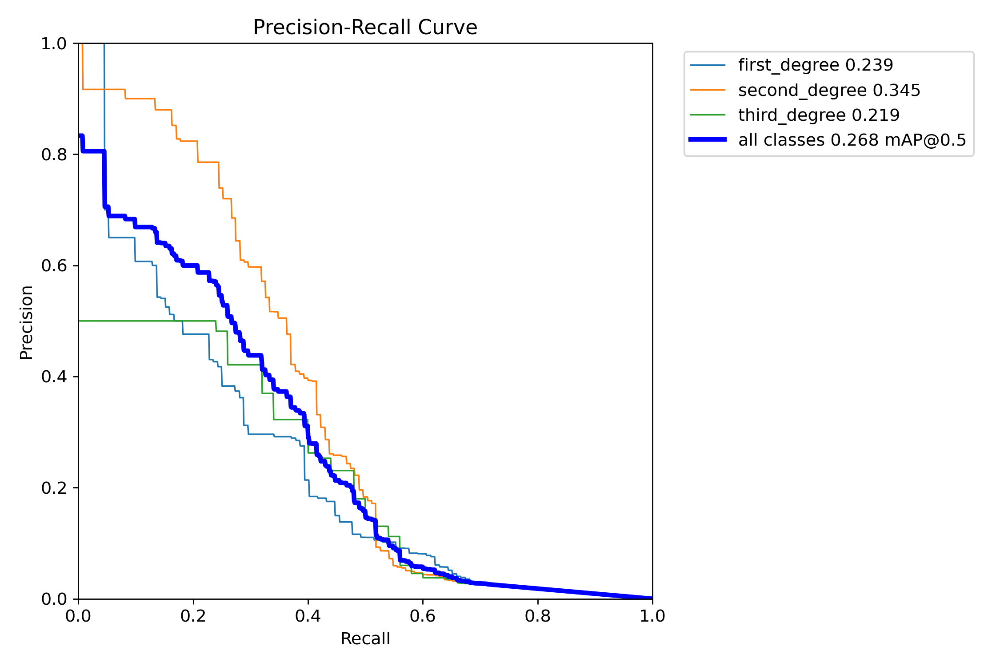

In [ ]:
res=Image.open("/content/yolov5/runs/train/yolov5m_burns4/PR_curve.png")
res

In [ ]:
!cp /content/yolov5/runs/train/yolov5m_burns4/weights/best.pt /content/drive/MyDrive/ML_models/FinalProject/Weight/best_yolo5m640.pt

In [ ]:
!mkdir -p /content/yolov5/inference_2/images

In [ ]:
!find /content/burns/images/val -maxdepth 1 -type f | head -50 | xargs cp -t "/content/yolov5/inference_2/images/"

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/best_yolo5m640.pt /content/best_yolo5m640.pt

In [ ]:
%cp /content/drive/MyDrive/ML_models/FinalProject/Weight/yolov5m.yaml /content/yolov5/models/yolov5m.yaml

In [ ]:
!python detect.py --weights /content/best_yolo5m640.pt \
  --img 640 --conf 0.16 --source ./inference_2/images/

<h4>Предсказанное</h4>

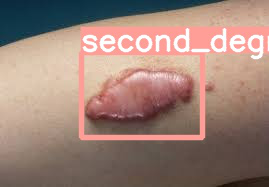

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp2/1436.jpg")
image_res

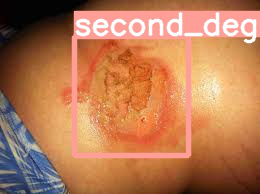

In [ ]:
image_res=Image.open("/content/yolov5/runs/detect/exp2/237.jpg")
image_res

<h4>Реальные</h4>

In [ ]:
img=cv2.imread("/content/skd/img237.jpg")
df=pd.read_csv("/content/skd/img237.txt",sep=" ",header=None)

0

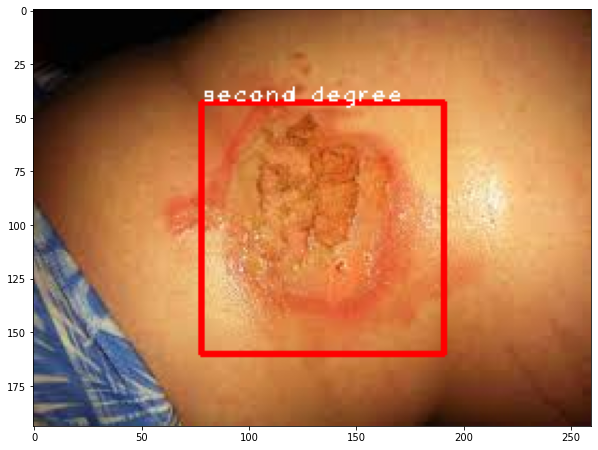

In [ ]:
print_border(img,df)

In [ ]:
img=cv2.imread("/content/skd/img1436.jpg")
df=pd.read_csv("/content/skd/img1436.txt",sep=" ",header=None)

0

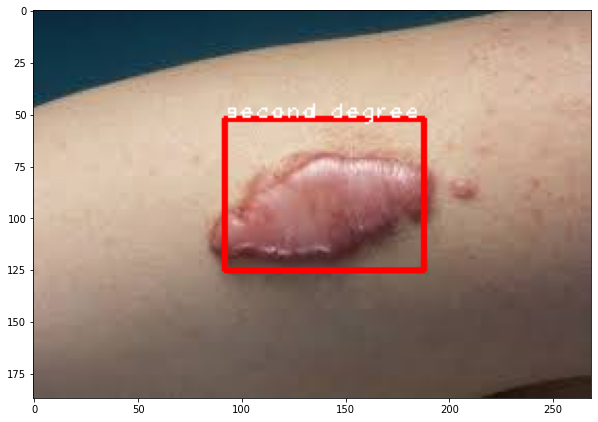

In [ ]:
print_border(img,df)

## Вывод

<h4>Самые лучшие оценки показал Yolov5(640x640). По правилам на каждый класс нужно было 1500 изображений у меня было намного меньше, эпох должно было быть 300 у меня было 30, batchsize должен был быть большим так как small batch sizes produce poor batchnorm statistics у меня для Yolov5(640x640) было 16, это мало но больше на видеокарту не влезло, Yolov5(256x256 ) было 64</h4>

# Часть 4

<h4>В этой части я попытаюсь предсказать размер опухоли меланомы на основе различных атрибутов.</h4>

## Описание атрибутов:

In [ ]:
import seaborn as sns
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.ensemble import RandomForestRegressor,AdaBoostRegressor,GradientBoostingRegressor
from imblearn.over_sampling import ADASYN

In [ ]:
'''
mass_npea: масса исследуемой области опухоли меланомы.

size_npear: размер исследуемой области опухоли меланомы.

malign_ratio: соотношение нормальной и злокачественной поверхности дублера

Damage_size: невосстанавливаемый участок кожи, поврежденный опухолью.

экспонированная_область: общая площадь, подверженная воздействию опухоли.

std_dev_malign: стандартное отклонение измерений злокачественных новообразований кожи.

err_malign: ошибка в измерениях злокачественных новообразований кожи.

malign_penalty: применяется штраф из-за ошибки измерения в лаборатории

Damage_ratio: отношение урона к общему распространению по коже

tumor_size: размер опухоли меланомы
'''

## Условие задачи

<h3>
<p>tumor_size размер опухоли меланомы.</p>
<p>Здача: Предсказать по входным данным размер опухоли меланомы.</p>
</h3>

In [ ]:
%cp -r /content/drive/MyDrive/Kaggle/melanoma-tumor-size-prediction-machinehack.zip /content/melanoma-tumor-size-prediction-machinehack.zip

In [ ]:
%cd /content

/content


In [ ]:
!unzip /content/melanoma-tumor-size-prediction-machinehack.zip

Archive:  /content/melanoma-tumor-size-prediction-machinehack.zip
  inflating: Test.csv                
  inflating: Train.csv               
  inflating: sample_submission.csv   


In [ ]:
df=pd.read_csv("Train.csv")

In [ ]:
df.head()

,mass_npea,size_npear,malign_ratio,damage_size,exposed_area,std_dev_malign,err_malign,malign_penalty,damage_ratio,tumor_size
0,6930.90,2919.02,0.42116,51.8298,9.888294e+05,109.487,2758.76,72,39.3620,14.103
1,15635.70,4879.36,0.31206,223.5500,2.058426e+06,248.881,5952.53,240,22.0253,2.648
2,10376.20,2613.88,0.25191,127.3370,1.434676e+06,160.093,4635.26,73,29.9963,1.688
3,13093.80,4510.06,0.34444,155.4400,1.812195e+06,173.015,5273.87,32,28.1354,3.796
4,7545.21,2882.36,0.38201,85.1237,1.043918e+06,124.414,3263.35,57,35.0200,18.023


## Предобработка данных

### Исследование на пропуски

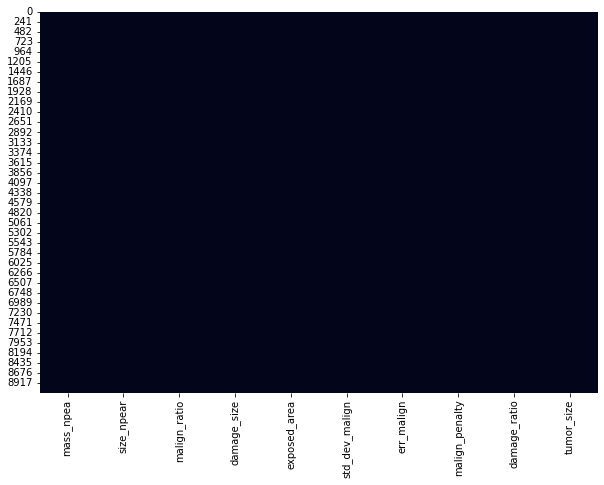

In [ ]:
plt.figure(figsize=(10,7))
sns.heatmap(df.isnull(),cbar=False)

Пропусков нет

### Исследование на аномалии

In [ ]:
df.describe()

,mass_npea,size_npear,malign_ratio,damage_size,exposed_area,std_dev_malign,err_malign,malign_penalty,damage_ratio,tumor_size
count,9146.000000,9146.000000,9146.000000,9146.000000,9.146000e+03,9146.000000,9146.000000,9146.000000,9146.000000,9146.000000
mean,9903.052174,3032.827837,0.303083,103.902118,1.372442e+06,146.304239,3992.936256,69.849661,34.461652,7.723348
std,4060.577116,1462.334147,0.062533,55.456862,5.646773e+05,70.512177,1780.672859,55.785332,5.972808,6.086852
min,2864.760000,510.530000,0.114820,10.310100,3.878534e+05,31.970400,1089.190000,0.000000,15.228000,0.000000
25%,6988.420000,1983.657500,0.259053,64.012525,9.596873e+05,95.853900,3177.682500,31.000000,30.290225,2.320000
50%,8895.965000,2684.330000,0.301055,88.458300,1.237057e+06,126.138500,3846.320000,54.000000,35.245750,5.060500
75%,12119.950000,3830.745000,0.343002,134.209000,1.693083e+06,182.251500,4664.577500,91.000000,38.806075,13.336000
max,36995.400000,13535.000000,0.525300,346.420000,4.978616e+06,528.890000,91983.700000,340.000000,46.546400,20.999000


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fee50551dd0>,
      dtype=object)

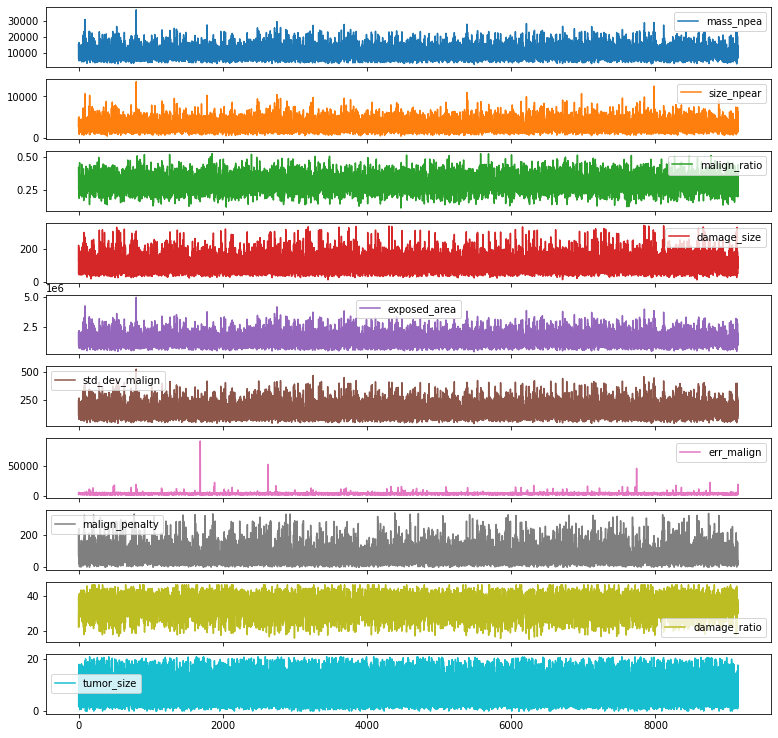

In [ ]:
df.plot(subplots=True, figsize = (13, 13))

Аномалий нету

### Рассмотрение распределений данных и кореляции признаков

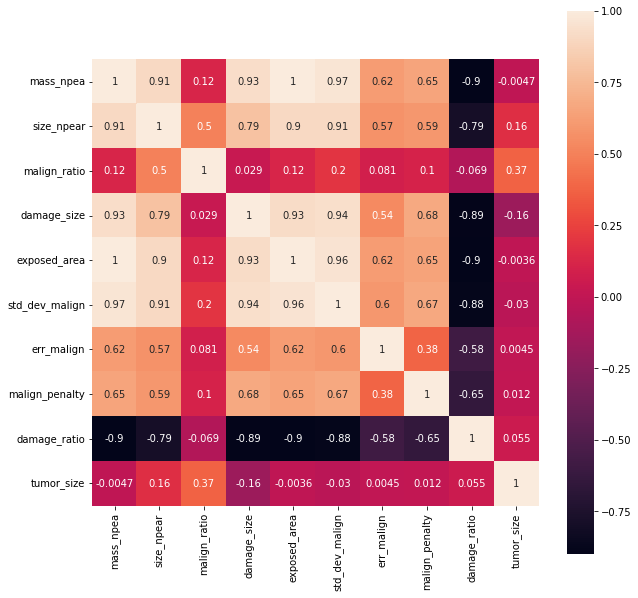

In [ ]:
plt.figure(figsize=(10,10))
sns.heatmap(df.corr(),annot=True, square=True)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fee4e61cd90>,
      dtype=object)

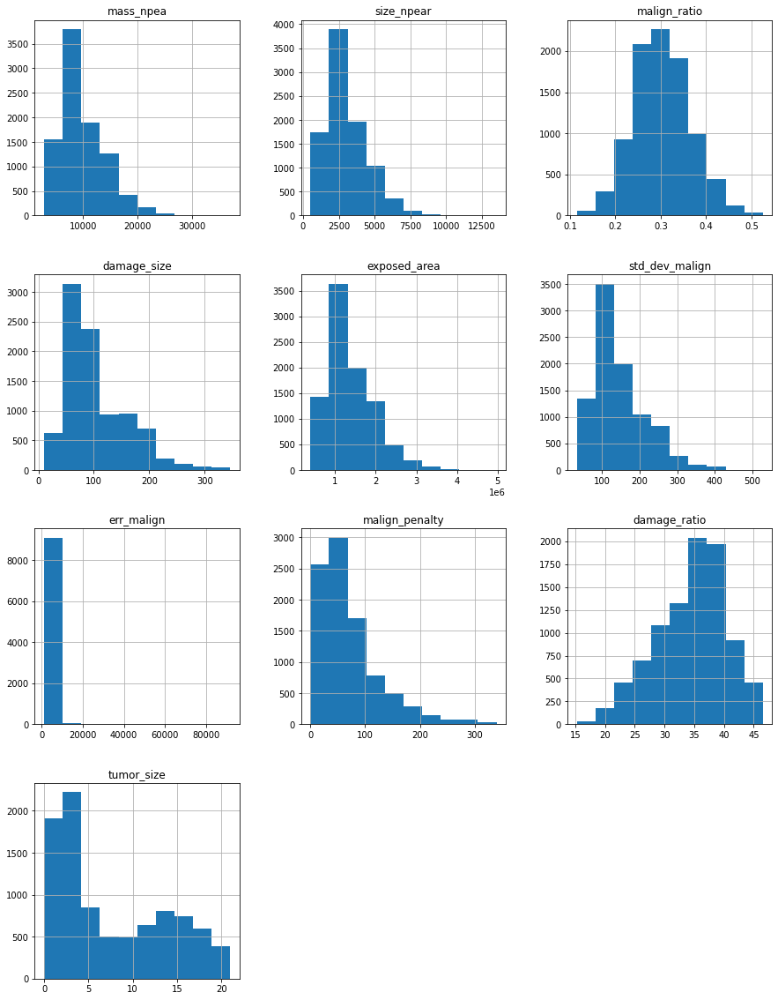

In [ ]:
df.hist(figsize=(15, 20))

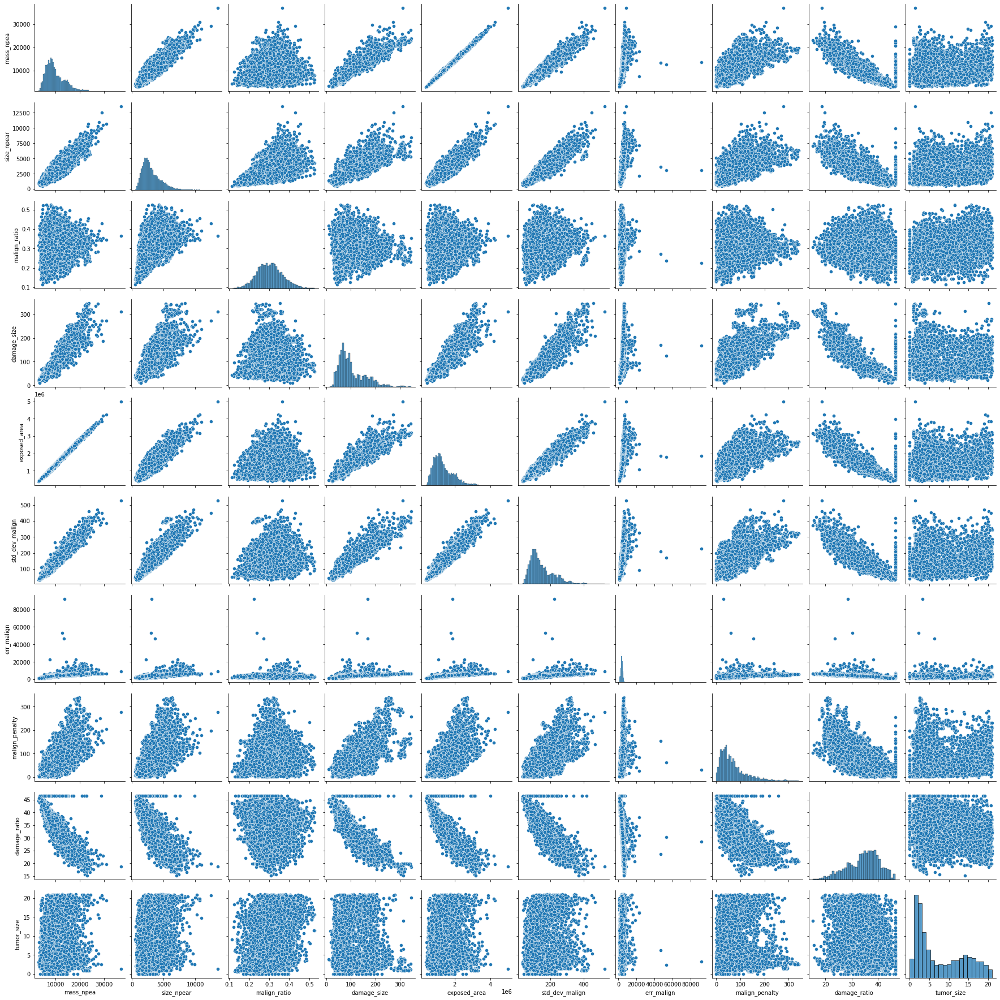

In [ ]:
sns.pairplot(df)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9146 entries, 0 to 9145
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   mass_npea       9146 non-null   float64
 1   size_npear      9146 non-null   float64
 2   malign_ratio    9146 non-null   float64
 3   damage_size     9146 non-null   float64
 4   exposed_area    9146 non-null   float64
 5   std_dev_malign  9146 non-null   float64
 6   err_malign      9146 non-null   float64
 7   malign_penalty  9146 non-null   int64  
 8   damage_ratio    9146 non-null   float64
 9   tumor_size      9146 non-null   float64
dtypes: float64(9), int64(1)
memory usage: 714.7 KB


Менять int64 и float64 не имеет смысла так как таблица и так очень маленькая и весит мало.

### Удаление дубликатов

In [ ]:
df.shape

(9146, 10)

In [ ]:
df.drop_duplicates(inplace=True)

In [ ]:
df.shape

(9053, 10)

Дубликатов удалены

### Разделение данных на Train Test

In [ ]:
features=df.columns[:-1]
features

Index(['mass_npea', 'size_npear', 'malign_ratio', 'damage_size',
       'exposed_area', 'std_dev_malign', 'err_malign', 'malign_penalty',
       'damage_ratio'],
      dtype='object')

In [ ]:
target_column=df.columns[-1]
target_column

'tumor_size'

In [ ]:
X_train,X_test,y_train,y_test = train_test_split(df[features],df[target_column],test_size=0.10,shuffle=True,random_state=123)

In [ ]:
len(X_train),len(X_test)

(8147, 906)

In [ ]:
X_train=np.array(X_train)
X_test=np.array(X_test)
y_train=np.array(y_train)
y_test=np.array(y_test)

In [ ]:
import matplotlib.pyplot as plt
def plot_feature_imp(rf, column_names, top_n):
    
    assert len(rf.feature_importances_) == len(column_names)
    data = pd.DataFrame({'imp':rf.feature_importances_, 'cols':column_names})
    data.sort_values('imp', inplace = True, ascending=False)
    plt.figure(figsize=(15, 10))
    sns.barplot(y='cols', x = 'imp',
        data = data[:top_n], orient='h'
    )
    plt.show()

## Решение задачи с настройкой параметров

### DecisionTreeRegressor

In [ ]:
pipe=Pipeline(steps=[('tree',DecisionTreeRegressor())])
params={
    "tree__criterion":["squared_error","absolute_error"],
    'tree__min_samples_leaf':[1,2,3],
    'tree__max_features':[None,"auto"]
}
gs=GridSearchCV(pipe,params,cv=5,n_jobs=-1)

In [ ]:
gs=gs.fit(X_train,y_train)

In [ ]:
gs.best_estimator_,gs.best_params_

(Pipeline(steps=[('tree', DecisionTreeRegressor(min_samples_leaf=3))]),
 {'tree__criterion': 'squared_error',
  'tree__max_features': None,
  'tree__min_samples_leaf': 3})

In [ ]:
y_hat=gs.predict(X_test)
print(f"MSE = {mean_squared_error(y_test,y_hat)}\nMAE = {mean_absolute_error(y_test,y_hat)}")

MSE = 31.849508135756686
MAE = 3.6458277409860194


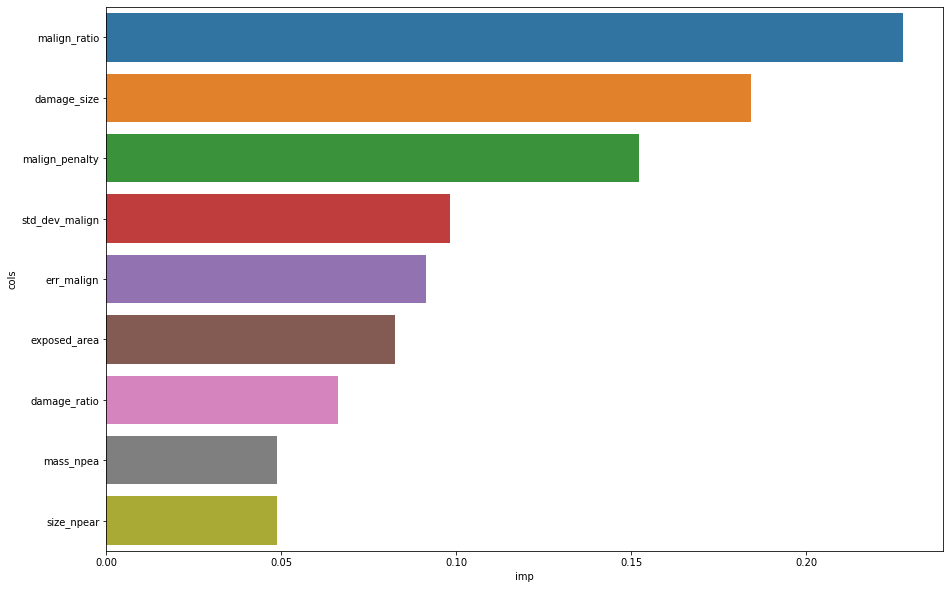

In [ ]:
plot_feature_imp(gs.best_estimator_.steps[0][1],df.loc[:,df.columns!="tumor_size"].columns,9)

### RandomForestRegression

In [ ]:
pipe=Pipeline(steps=[("forest",RandomForestRegressor())])
params={
    "forest__n_estimators":[100,150],
    'forest__max_depth':[5,10,None],
}
gs=GridSearchCV(pipe,params,cv=5,n_jobs=-1)

In [ ]:
gs=gs.fit(X_train,y_train)

In [ ]:
gs.best_estimator_,gs.best_params_

(Pipeline(steps=[('forest', RandomForestRegressor(n_estimators=150))]),
 {'forest__max_depth': None, 'forest__n_estimators': 150})

In [ ]:
y_hat=gs.predict(X_test)
print(f"MSE = {mean_squared_error(y_test,y_hat)}\nMAE = {mean_absolute_error(y_test,y_hat)}")

MSE = 17.558536946258286
MAE = 2.9332864259434457


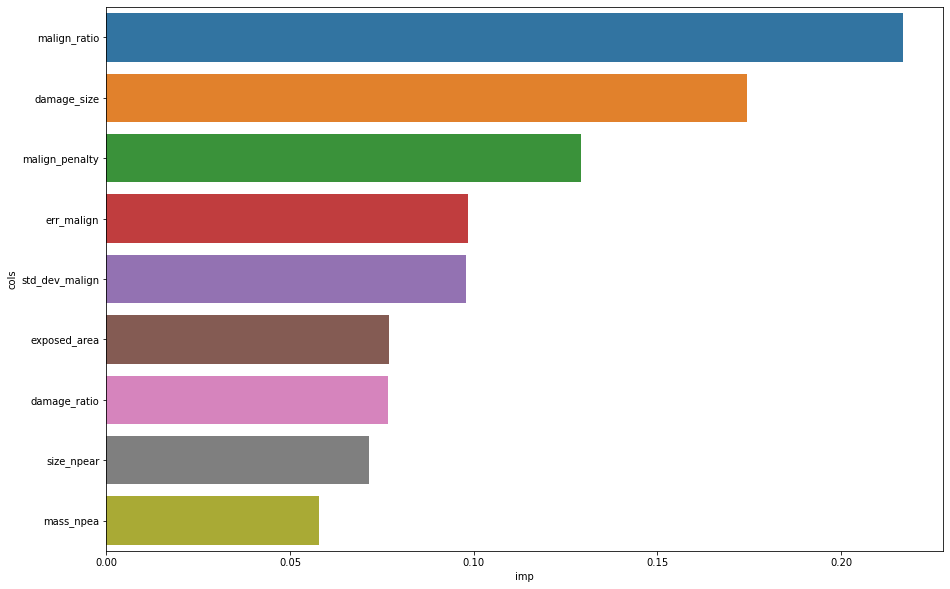

In [ ]:
plot_feature_imp(gs.best_estimator_.steps[0][1],df.loc[:,df.columns!="tumor_size"].columns,9)

### AdaBoostClassifier(DecisionTreeClassifier)

In [ ]:
pipe=Pipeline(steps=[('adaboost',AdaBoostRegressor(base_estimator=DecisionTreeRegressor()))])
params={
    "adaboost__base_estimator__criterion":["squared_error","absolute_error"],
    'adaboost__base_estimator__max_features':[None,"auto"]
}
gs=GridSearchCV(pipe,params,cv=5,n_jobs=-1)

In [ ]:
gs=gs.fit(X_train,y_train)

In [ ]:
gs.best_estimator_,gs.best_params_

(Pipeline(steps=[('adaboost',
                  AdaBoostRegressor(base_estimator=DecisionTreeRegressor(criterion='absolute_error')))]),
 {'adaboost__base_estimator__criterion': 'absolute_error',
  'adaboost__base_estimator__max_features': None})

In [ ]:
y_hat=gs.predict(X_test)
print(f"MSE = {mean_squared_error(y_test,y_hat)}\nMAE = {mean_absolute_error(y_test,y_hat)}")

MSE = 18.166472862030904
MAE = 2.596733995584989


### GradientBoostingRegressor

In [ ]:
pipe=Pipeline(steps=[('ss',StandardScaler()),('gradboosting',GradientBoostingRegressor())])
params={
    "gradboosting__criterion":['friedman_mse','squared_error'],
    "gradboosting__n_estimators":[100,150,200],
}
gs=GridSearchCV(pipe,params,cv=5,n_jobs=-1)

In [ ]:
gs=gs.fit(X_train,y_train)

In [ ]:
gs.best_estimator_,gs.best_params_

(Pipeline(steps=[('ss', StandardScaler()),
                 ('gradboosting', GradientBoostingRegressor(n_estimators=200))]),
 {'gradboosting__criterion': 'friedman_mse',
  'gradboosting__n_estimators': 200})

In [ ]:
y_hat=gs.predict(X_test)
print(f"MSE = {mean_squared_error(y_test,y_hat)}\nMAE = {mean_absolute_error(y_test,y_hat)}")

MSE = 20.90943545462638
MAE = 3.481163374172677


In [ ]:
import pickle

In [ ]:
with open('/content/drive/MyDrive/ML_models/FinalProject/Weight/table.pickle', 'wb') as f:
    pickle.dump(gs,f)

In [ ]:
with open('/content/drive/MyDrive/ML_models/FinalProject/Weight/table.pickle', 'rb') as f:
    tumor_model=pickle.load(f)

## Вывод

<h4>Результаты получились хорошие у всех алгоритмов. Самые лучшие у RandomForestRegression: MSE = 17.55, MAE = 2.93</h4>

# Вывод

<h4>В результате работы были решены такие задачи как:​

Классификация и сегментация родинок​

Классификация и детекция ожогов​

Предсказание размеров опухоли​

Обнаружения аномалий</h4>